# Benchmarking Field Transformations


### DONE - FT-HMC implemented for 8x8 2D QED (using SiLU as activation function).

- [x] Try to minimize size of the force in training. No significant improvements.
- [x]  Some test on ergodicity
- [x] (calculate the probablity of generating the configs obtained via conventional HMC).

### TODO

- [ ] Plot the force size distribution 
- [ ] Is the large force from the original action or Field-Transforma
tion the determinant?
- [ ] If from the determinant, then the fermion force won't cause problem for HMC
- [ ] Use the same Field-Transformation for larger system (say 16x16, 32x32, 64x64, etc)
- [ ] Study how the delta H depends on the system size ( perhaps delta H ~ sqrt(volume) )
- [ ] Study the auto-correlation for observables, topo, plaq, flowed plaq, etc.
- [ ] Improving the Field-Transformation to reduce force.

## Setup, `import`'s, ..., etc

In [1]:
import os
import sys
import torch

from functools import reduce
from IPython.core.interactiveshell import InteractiveShell

%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format ='retina'

InteractiveShell.ast_node_interactivity = "all"


project_dir = os.path.abspath('../../')
if project_dir not in sys.path:
    sys.path.append(project_dir)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import fthmc.utils.io as io
logger = io.Logger()

torch.manual_seed(9)
# torch.set_default_tensor_type(torch.FloatTensor)

#torch.set_num_threads(param.nth)
#torch.set_num_interop_threads(param.nth_interop)
#os.environ["OMP_NUM_THREADS"] = str(param.nth)
#os.environ["KMP_BLOCKTIME"] = "0"
#os.environ["KMP_SETTINGS"] = "1"
#os.environ["KMP_AFFINITY"]= "granularity=fine,verbose,compact,1,0"

torch.set_default_tensor_type(torch.FloatTensor)
logger = io.Logger()

## Specify `Param` object

In [3]:
import matplotlib as mpl

from fthmc.train import train
from fthmc.utils.param import Param
from fthmc.config import TrainConfig, PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_u1_equiv_layers, set_weights
from fthmc.utils.plot_helpers import save_live_plots

import fthmc.utils.qed_helpers as qed

import datetime

from fthmc.train import run as hmc_run
from fthmc.config import LOGS_DIR

mpl.rcParams['text.usetex'] = False

param = {
    'L': 4,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
}

train_config = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
     'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})


param = Param(**param)
logger.log(repr(param))
logger.log(f'train_config: {train_config}')

DAYSTR = io.get_timestamp('%Y-%m-%d')
TSTAMP = io.get_timestamp('%Y-%m-%d-%H%M')
NOW = io.get_timestamp('%Y-%m-%d-%H%M%S')

PARAM_DIR = os.path.join(LOGS_DIR, param.uniquestr())
METRICS_DIR = os.path.join(PARAM_DIR, 'metrics')
MODEL_DIR = os.path.join(PARAM_DIR, 'models')
PLOTS_DIR = os.path.join(PARAM_DIR, 'plots')

io.check_else_make_dir(PARAM_DIR)
io.check_else_make_dir(MODEL_DIR)
io.check_else_make_dir(METRICS_DIR)
io.check_else_make_dir(PLOTS_DIR)

TORCH DEVICE: cpu


[10:41:18]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=4                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.05

            train_config: TrainConfig(n_era=10, n_epoch=100, n_layers=24, n_s_nets=2,        
            hidden_sizes=[8, 8], kernel_size=3, base_lr=0.001, batch_size=64, print_freq=10, 
            plot_freq=10, with_force=False)

## Specify directories for saving model, etc

In [4]:
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

hmc_metrics_dir = os.path.join(METRICS_DIR, 'hmc', TSTAMP)
outfile = os.path.join(hmc_metrics_dir, f'hmc_metrics.z')

io.save_history(metrics, outfile, name='hmc_metrics')

[10:41:31]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=4                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.05

            action=1.000 plaq=0.000 charge=0.000

            dt=0.007 traj=2 accept=True dH=-0.023 expdH=1.024 dq=0.000

            dt=0.009 traj=7 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.006 traj=12 accept=True dH=-0.001 expdH=1.001 dq=0.000

            dt=0.007 traj=17 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.007 traj=22 accept=True dH=0.016 expdH=0.985 dq=0.000

            dt=0.006 traj=27 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.011 traj=32 accept=True dH=0.022 expdH=0.978 dq=0.000

            dt=0.012 traj=37 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.009 traj=42 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.008 traj=47 accept=True dH=0.020 expdH=0.980 dq=1.000

            dt=0.009 traj=52 accept=True dH=0.007 expdH=0.993 dq=0.000

[10:41:32]  dt=0.007 traj=57 accept=True dH=-0.015 expdH=1.015 dq=1.000

            dt=0.008 traj=62 accept=True dH=-0.029 expdH=1.029 dq=0.000

            dt=0.006 traj=67 accept=True dH=0.025 expdH=0.975 dq=0.000

            dt=0.007 traj=72 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.006 traj=77 accept=True dH=0.011 expdH=0.989 dq=0.000

            dt=0.006 traj=82 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.006 traj=87 accept=True dH=-0.003 expdH=1.003 dq=1.000

            dt=0.007 traj=92 accept=True dH=0.011 expdH=0.990 dq=4.000

            dt=0.006 traj=97 accept=True dH=0.007 expdH=0.993 dq=4.000

            dt=0.006 traj=102 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.007 traj=107 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=112 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.006 traj=117 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.007 traj=122 accept=True dH=-0.016 expdH=1.016 dq=0.000

            dt=0.007 traj=127 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.008 traj=132 accept=True dH=0.021 expdH=0.979 dq=0.000

            dt=0.007 traj=137 accept=True dH=-0.006 expdH=1.006 dq=1.000

            dt=0.007 traj=142 accept=True dH=0.006 expdH=0.994 dq=1.000

            dt=0.007 traj=147 accept=True dH=-0.033 expdH=1.034 dq=0.000

[10:41:33]  dt=0.007 traj=152 accept=True dH=-0.009 expdH=1.009 dq=0.000

            dt=0.007 traj=157 accept=True dH=-0.029 expdH=1.030 dq=0.000

            dt=0.006 traj=162 accept=True dH=0.017 expdH=0.983 dq=0.000

            dt=0.007 traj=167 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.008 traj=172 accept=True dH=0.024 expdH=0.976 dq=0.000

            dt=0.006 traj=177 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.007 traj=182 accept=True dH=-0.002 expdH=1.002 dq=1.000

            dt=0.006 traj=187 accept=True dH=0.006 expdH=0.994 dq=1.000

            dt=0.006 traj=192 accept=True dH=0.008 expdH=0.992 dq=0.000

            dt=0.007 traj=197 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.007 traj=202 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=207 accept=True dH=-0.011 expdH=1.011 dq=0.000

            dt=0.006 traj=212 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.007 traj=217 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.006 traj=222 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=227 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.006 traj=232 accept=True dH=0.015 expdH=0.985 dq=0.000

            dt=0.006 traj=237 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.006 traj=242 accept=True dH=0.030 expdH=0.971 dq=0.000

[10:41:34]  dt=0.006 traj=247 accept=True dH=-0.009 expdH=1.009 dq=1.000

            dt=0.006 traj=252 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.007 traj=258 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.006 traj=263 accept=True dH=-0.001 expdH=1.001 dq=0.000

            dt=0.006 traj=268 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.007 traj=273 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.009 traj=278 accept=True dH=0.013 expdH=0.987 dq=0.000

            dt=0.008 traj=283 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.007 traj=288 accept=True dH=0.017 expdH=0.983 dq=0.000

            dt=0.011 traj=293 accept=True dH=-0.033 expdH=1.034 dq=0.000

            dt=0.008 traj=298 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.008 traj=303 accept=True dH=-0.012 expdH=1.013 dq=0.000

            dt=0.009 traj=308 accept=True dH=-0.011 expdH=1.011 dq=0.000

            dt=0.006 traj=313 accept=True dH=0.016 expdH=0.984 dq=0.000

            dt=0.007 traj=318 accept=True dH=-0.012 expdH=1.013 dq=0.000

            dt=0.006 traj=323 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.006 traj=328 accept=True dH=0.014 expdH=0.986 dq=0.000

[10:41:35]  dt=0.006 traj=333 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=338 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=343 accept=True dH=-0.023 expdH=1.023 dq=0.000

            dt=0.007 traj=348 accept=True dH=-0.012 expdH=1.012 dq=0.000

            dt=0.007 traj=353 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.006 traj=358 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.006 traj=363 accept=True dH=-0.013 expdH=1.013 dq=0.000

            dt=0.007 traj=368 accept=True dH=0.026 expdH=0.974 dq=1.000

            dt=0.006 traj=373 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.007 traj=378 accept=True dH=-0.013 expdH=1.013 dq=0.000

            dt=0.007 traj=383 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.009 traj=388 accept=True dH=0.020 expdH=0.980 dq=0.000

            dt=0.009 traj=393 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.007 traj=398 accept=True dH=0.017 expdH=0.983 dq=0.000

            dt=0.006 traj=403 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=408 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.009 traj=413 accept=True dH=-0.014 expdH=1.014 dq=0.000

            dt=0.006 traj=418 accept=True dH=-0.010 expdH=1.010 dq=0.000

[10:41:36]  dt=0.007 traj=423 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.008 traj=428 accept=True dH=-0.011 expdH=1.011 dq=0.000

            dt=0.007 traj=433 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=438 accept=True dH=-0.012 expdH=1.012 dq=0.000

            dt=0.006 traj=443 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.006 traj=448 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.006 traj=453 accept=True dH=-0.000 expdH=1.000 dq=0.000

            dt=0.006 traj=458 accept=True dH=-0.025 expdH=1.025 dq=0.000

            dt=0.006 traj=463 accept=True dH=-0.022 expdH=1.022 dq=0.000

            dt=0.006 traj=468 accept=True dH=0.019 expdH=0.981 dq=0.000

            dt=0.007 traj=473 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.007 traj=478 accept=True dH=0.018 expdH=0.982 dq=0.000

            dt=0.006 traj=483 accept=True dH=-0.019 expdH=1.019 dq=0.000

            dt=0.006 traj=488 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=493 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.008 traj=498 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.007 traj=503 accept=True dH=0.007 expdH=0.994 dq=0.000

            dt=0.006 traj=508 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.007 traj=514 accept=True dH=-0.025 expdH=1.025 dq=0.000

[10:41:37]  dt=0.006 traj=519 accept=True dH=0.015 expdH=0.985 dq=0.000

            dt=0.006 traj=524 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=529 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.006 traj=534 accept=True dH=-0.031 expdH=1.032 dq=0.000

            dt=0.006 traj=539 accept=True dH=0.024 expdH=0.976 dq=0.000

            dt=0.008 traj=544 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.006 traj=549 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.006 traj=554 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.006 traj=559 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=564 accept=True dH=0.021 expdH=0.979 dq=0.000

            dt=0.009 traj=569 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.009 traj=574 accept=True dH=-0.017 expdH=1.018 dq=0.000

            dt=0.006 traj=579 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=584 accept=True dH=-0.016 expdH=1.017 dq=1.000

            dt=0.006 traj=589 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.007 traj=594 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.006 traj=599 accept=True dH=-0.022 expdH=1.023 dq=0.000

            dt=0.006 traj=604 accept=True dH=0.005 expdH=0.995 dq=0.000

[10:41:38]  dt=0.006 traj=609 accept=True dH=0.023 expdH=0.977 dq=0.000

            dt=0.006 traj=614 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.006 traj=619 accept=True dH=-0.008 expdH=1.009 dq=0.000

            dt=0.006 traj=624 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.010 traj=629 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.009 traj=634 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.008 traj=639 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.007 traj=644 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.007 traj=649 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.008 traj=654 accept=False dH=0.016 expdH=0.984 dq=0.000

            dt=0.007 traj=659 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.008 traj=664 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.008 traj=669 accept=True dH=-0.023 expdH=1.024 dq=0.000

            dt=0.006 traj=674 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.007 traj=679 accept=True dH=0.003 expdH=0.997 dq=0.000

            dt=0.006 traj=684 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.008 traj=689 accept=True dH=-0.007 expdH=1.007 dq=0.000

[10:41:39]  dt=0.007 traj=694 accept=True dH=-0.009 expdH=1.009 dq=0.000

            dt=0.007 traj=699 accept=True dH=-0.028 expdH=1.028 dq=0.000

            dt=0.006 traj=704 accept=True dH=-0.015 expdH=1.015 dq=0.000

            dt=0.007 traj=709 accept=True dH=-0.012 expdH=1.013 dq=0.000

            dt=0.007 traj=714 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.006 traj=719 accept=True dH=0.018 expdH=0.982 dq=0.000

            dt=0.006 traj=724 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.006 traj=729 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.007 traj=734 accept=True dH=-0.007 expdH=1.007 dq=1.000

            dt=0.006 traj=739 accept=True dH=-0.001 expdH=1.001 dq=1.000

            dt=0.006 traj=744 accept=True dH=-0.022 expdH=1.022 dq=0.000

            dt=0.006 traj=749 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=754 accept=True dH=0.013 expdH=0.987 dq=0.000

            dt=0.007 traj=759 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.007 traj=764 accept=True dH=-0.017 expdH=1.017 dq=0.000

            dt=0.006 traj=770 accept=True dH=-0.016 expdH=1.016 dq=0.000

            dt=0.007 traj=775 accept=True dH=-0.012 expdH=1.012 dq=0.000

            dt=0.007 traj=780 accept=True dH=0.018 expdH=0.982 dq=0.000

            dt=0.007 traj=785 accept=True dH=0.012 expdH=0.988 dq=0.000

[10:41:40]  dt=0.007 traj=790 accept=True dH=-0.011 expdH=1.011 dq=0.000

            dt=0.006 traj=795 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.006 traj=800 accept=True dH=0.028 expdH=0.972 dq=1.000

            dt=0.006 traj=805 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.007 traj=810 accept=True dH=0.032 expdH=0.969 dq=0.000

            dt=0.006 traj=815 accept=True dH=0.006 expdH=0.994 dq=0.000

            dt=0.006 traj=820 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.006 traj=825 accept=True dH=-0.001 expdH=1.001 dq=0.000

            dt=0.008 traj=830 accept=True dH=0.020 expdH=0.980 dq=0.000

            dt=0.007 traj=835 accept=True dH=-0.009 expdH=1.009 dq=1.000

            dt=0.007 traj=840 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=845 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.007 traj=850 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=855 accept=True dH=0.010 expdH=0.990 dq=0.000

            dt=0.007 traj=860 accept=True dH=0.022 expdH=0.978 dq=0.000

            dt=0.007 traj=865 accept=True dH=-0.015 expdH=1.016 dq=0.000

            dt=0.006 traj=870 accept=True dH=0.020 expdH=0.980 dq=1.000

            dt=0.006 traj=875 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.006 traj=880 accept=True dH=-0.011 expdH=1.011 dq=0.000

[10:41:41]  dt=0.007 traj=885 accept=True dH=-0.002 expdH=1.002 dq=1.000

            dt=0.006 traj=890 accept=True dH=-0.029 expdH=1.030 dq=1.000

            dt=0.006 traj=895 accept=True dH=0.008 expdH=0.992 dq=0.000

            dt=0.006 traj=900 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.007 traj=905 accept=True dH=-0.016 expdH=1.017 dq=0.000

            dt=0.006 traj=910 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.006 traj=915 accept=True dH=0.005 expdH=0.995 dq=1.000

            dt=0.006 traj=920 accept=True dH=0.022 expdH=0.978 dq=1.000

            dt=0.006 traj=925 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=930 accept=True dH=-0.039 expdH=1.040 dq=1.000

            dt=0.006 traj=935 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.007 traj=940 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.007 traj=945 accept=True dH=-0.008 expdH=1.008 dq=1.000

            dt=0.007 traj=950 accept=True dH=0.009 expdH=0.991 dq=0.000

            dt=0.007 traj=955 accept=True dH=-0.032 expdH=1.033 dq=0.000

            dt=0.006 traj=960 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.007 traj=965 accept=True dH=-0.015 expdH=1.016 dq=0.000

            dt=0.008 traj=970 accept=True dH=0.007 expdH=0.994 dq=0.000

[10:41:42]  dt=0.007 traj=975 accept=True dH=-0.008 expdH=1.008 dq=1.000

            dt=0.008 traj=980 accept=True dH=0.013 expdH=0.987 dq=0.000

            dt=0.006 traj=985 accept=True dH=0.020 expdH=0.981 dq=0.000

            dt=0.007 traj=990 accept=True dH=-0.019 expdH=1.020 dq=0.000

            dt=0.006 traj=995 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.007 traj=1000 accept=True dH=0.024 expdH=0.976 dq=0.000

            dt=0.007 traj=1005 accept=True dH=-0.000 expdH=1.000 dq=0.000

            dt=0.007 traj=1010 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=1015 accept=True dH=-0.013 expdH=1.014 dq=0.000

            dt=0.007 traj=1020 accept=True dH=-0.016 expdH=1.016 dq=0.000

            dt=0.006 traj=1026 accept=True dH=-0.011 expdH=1.011 dq=0.000

            dt=0.007 traj=1031 accept=True dH=0.007 expdH=0.993 dq=0.000

            dt=0.007 traj=1036 accept=True dH=0.011 expdH=0.989 dq=0.000

            dt=0.007 traj=1041 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.007 traj=1046 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.006 traj=1051 accept=True dH=0.011 expdH=0.989 dq=1.000

            dt=0.006 traj=1056 accept=True dH=0.004 expdH=0.996 dq=0.000

            dt=0.007 traj=1061 accept=True dH=-0.006 expdH=1.006 dq=0.000

[10:41:43]  dt=0.006 traj=1066 accept=True dH=-0.014 expdH=1.014 dq=0.000

            dt=0.007 traj=1071 accept=True dH=-0.010 expdH=1.010 dq=0.000

            dt=0.007 traj=1076 accept=True dH=-0.019 expdH=1.019 dq=0.000

            dt=0.006 traj=1081 accept=True dH=0.005 expdH=0.995 dq=0.000

            dt=0.007 traj=1086 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.008 traj=1091 accept=True dH=0.012 expdH=0.988 dq=0.000

            dt=0.006 traj=1096 accept=True dH=-0.024 expdH=1.024 dq=0.000

            dt=0.008 traj=1101 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.007 traj=1106 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.008 traj=1111 accept=True dH=0.011 expdH=0.989 dq=0.000

            dt=0.006 traj=1116 accept=True dH=0.017 expdH=0.983 dq=0.000

            dt=0.006 traj=1121 accept=True dH=-0.008 expdH=1.008 dq=0.000

            dt=0.006 traj=1126 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.006 traj=1131 accept=True dH=0.002 expdH=0.998 dq=0.000

            dt=0.006 traj=1136 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=1141 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=1146 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=1151 accept=True dH=-0.026 expdH=1.027 dq=0.000

[10:41:44]  dt=0.006 traj=1156 accept=True dH=-0.009 expdH=1.009 dq=0.000

            dt=0.007 traj=1161 accept=True dH=-0.011 expdH=1.012 dq=0.000

            dt=0.006 traj=1166 accept=True dH=0.010 expdH=0.990 dq=0.000

            dt=0.006 traj=1171 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.006 traj=1176 accept=True dH=-0.006 expdH=1.006 dq=0.000

            dt=0.006 traj=1181 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.006 traj=1186 accept=True dH=-0.002 expdH=1.002 dq=0.000

            dt=0.006 traj=1191 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.006 traj=1196 accept=True dH=-0.007 expdH=1.007 dq=0.000

            dt=0.007 traj=1201 accept=True dH=0.000 expdH=1.000 dq=0.000

            dt=0.006 traj=1206 accept=True dH=-0.005 expdH=1.005 dq=0.000

            dt=0.007 traj=1211 accept=True dH=0.034 expdH=0.966 dq=0.000

            dt=0.006 traj=1216 accept=True dH=0.024 expdH=0.976 dq=0.000

            dt=0.007 traj=1221 accept=True dH=0.011 expdH=0.990 dq=0.000

            dt=0.006 traj=1226 accept=True dH=0.020 expdH=0.980 dq=0.000

            dt=0.011 traj=1231 accept=True dH=0.026 expdH=0.975 dq=0.000

            dt=0.008 traj=1236 accept=True dH=-0.009 expdH=1.009 dq=0.000

            dt=0.007 traj=1241 accept=True dH=0.008 expdH=0.992 dq=0.000

[10:41:45]  dt=0.007 traj=1246 accept=True dH=0.027 expdH=0.974 dq=0.000

            dt=0.007 traj=1251 accept=True dH=-0.014 expdH=1.014 dq=0.000

            dt=0.006 traj=1256 accept=True dH=-0.003 expdH=1.003 dq=0.000

            dt=0.007 traj=1261 accept=True dH=-0.023 expdH=1.023 dq=0.000

            dt=0.007 traj=1266 accept=True dH=0.041 expdH=0.960 dq=0.000

            dt=0.007 traj=1271 accept=True dH=0.001 expdH=0.999 dq=0.000

            dt=0.007 traj=1276 accept=True dH=0.003 expdH=0.997 dq=0.000

            Run times: [0.00613, 2.850116, 0.006403, 2.848144, 0.005993, 2.817262, 0.006371, 
            2.774686, 0.006287, 2.827311]

            Per trajectory: [2.4e-05, 0.011133, 2.5e-05, 0.011126, 2.3e-05, 0.011005,        
            2.5e-05, 0.010839, 2.5e-05, 0.011044]

[10:41:45]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /metrics/hmc/2021-06-08-1041

[10:41:45]  Saving hmc_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s
            10/metrics/hmc/2021-06-08-1041/hmc_metrics.z.

## Specify `TrainConfig` object for training our model

Note, we train the `pre_flow_model` using the Kullback-Leibler divergence:

$$
D_{\mathrm{KL}} = \left(P\|Q\right) = \sum_{x\in\mathcal{X}} P(x)\log\left(\frac{P(x)}{Q(x)}\right)
$$

## Define `TrainConfig` and build model as
```python
model = {
    'prior': MultivariateUniform(...),
    'model': make_u1_equiv_layers(...),
}
```

### Train `model_init`:

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

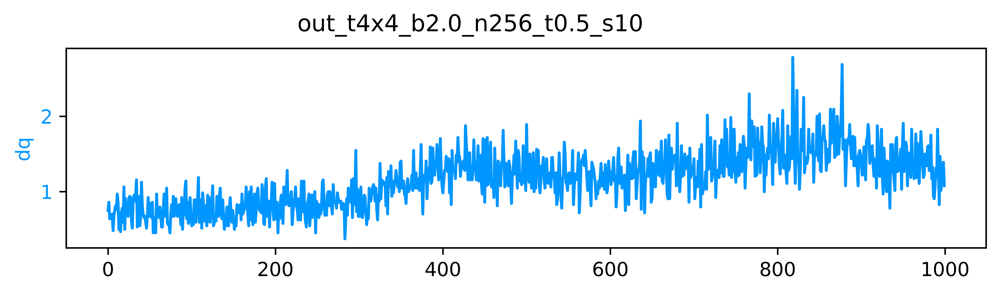

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

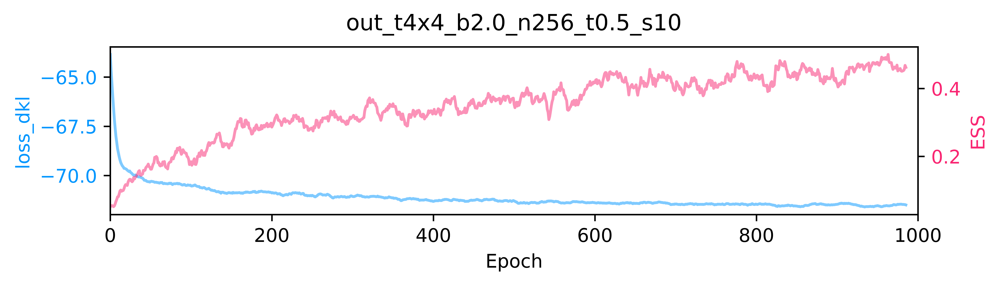

[09:15:43]  ----------------------------------------------------                             
            ERA=0, last took: 0 min 0 s                                                      
            ----------------------------------------------------

[09:15:44]  epoch=7.000 step=0.000 dt=0.181 loss=-64.455 dq=0.684 ess=0.033 plaq=0.203       
            loss_dkl=-64.455 logp=6.481 logq=-57.973

[09:15:49]  epoch=17.000 step=0.000 dt=0.178 loss=-69.455 dq=0.725 ess=0.048 plaq=0.497      
            loss_dkl=-69.455 logp=15.918 logq=-53.537

[09:15:53]  epoch=27.000 step=0.000 dt=0.182 loss=-69.491 dq=0.781 ess=0.134 plaq=0.612      
            loss_dkl=-69.491 logp=19.589 logq=-49.902

[09:15:58]  epoch=37.000 step=0.000 dt=0.188 loss=-70.066 dq=0.694 ess=0.163 plaq=0.570      
            loss_dkl=-70.066 logp=18.254 logq=-51.812

[09:16:03]  epoch=47.000 step=0.000 dt=0.184 loss=-70.200 dq=0.675 ess=0.167 plaq=0.550      
            loss_dkl=-70.200 logp=17.590 logq=-52.610

[09:16:08]  epoch=57.000 step=0.000 dt=0.187 loss=-70.425 dq=0.669 ess=0.203 plaq=0.577      
            loss_dkl=-70.425 logp=18.455 logq=-51.970

[09:16:13]  epoch=67.000 step=0.000 dt=0.183 loss=-70.384 dq=0.762 ess=0.245 plaq=0.584      
            loss_dkl=-70.384 logp=18.684 logq=-51.700

[09:16:17]  epoch=77.000 step=0.000 dt=0.183 loss=-70.305 dq=0.766 ess=0.149 plaq=0.569      
            loss_dkl=-70.305 logp=18.199 logq=-52.106

[09:16:22]  epoch=87.000 step=0.000 dt=0.170 loss=-70.432 dq=0.709 ess=0.206 plaq=0.587      
            loss_dkl=-70.432 logp=18.793 logq=-51.639

[09:16:26]  epoch=97.000 step=0.000 dt=0.169 loss=-70.392 dq=0.756 ess=0.240 plaq=0.588      
            loss_dkl=-70.392 logp=18.803 logq=-51.590

[09:16:29]  ----------------------------------------------------                             
            ERA=1, last took: 0 min 46.56 s                                                  
            ----------------------------------------------------

[09:16:31]  epoch=7.000 step=7.000 dt=0.162 loss=-70.444 dq=0.825 ess=0.151 plaq=0.592       
            loss_dkl=-70.444 logp=18.930 logq=-51.513

[09:16:35]  epoch=17.000 step=17.000 dt=0.158 loss=-70.532 dq=0.728 ess=0.185 plaq=0.584     
            loss_dkl=-70.532 logp=18.681 logq=-51.850

[09:16:39]  epoch=27.000 step=27.000 dt=0.161 loss=-70.650 dq=0.691 ess=0.173 plaq=0.613     
            loss_dkl=-70.650 logp=19.630 logq=-51.020

[09:16:44]  epoch=37.000 step=37.000 dt=0.158 loss=-70.869 dq=0.700 ess=0.295 plaq=0.604     
            loss_dkl=-70.869 logp=19.331 logq=-51.538

[09:16:48]  epoch=47.000 step=47.000 dt=0.157 loss=-70.920 dq=0.750 ess=0.301 plaq=0.624     
            loss_dkl=-70.920 logp=19.962 logq=-50.958

[09:16:52]  epoch=57.000 step=57.000 dt=0.157 loss=-70.899 dq=0.744 ess=0.236 plaq=0.606     
            loss_dkl=-70.899 logp=19.397 logq=-51.503

[09:16:56]  epoch=67.000 step=67.000 dt=0.158 loss=-70.885 dq=0.834 ess=0.319 plaq=0.608     
            loss_dkl=-70.885 logp=19.460 logq=-51.424

[09:17:00]  epoch=77.000 step=77.000 dt=0.161 loss=-70.904 dq=0.866 ess=0.268 plaq=0.631     
            loss_dkl=-70.904 logp=20.178 logq=-50.726

[09:17:04]  epoch=87.000 step=87.000 dt=0.158 loss=-70.903 dq=0.863 ess=0.211 plaq=0.600     
            loss_dkl=-70.903 logp=19.212 logq=-51.691

[09:17:09]  epoch=97.000 step=97.000 dt=0.158 loss=-70.649 dq=0.903 ess=0.301 plaq=0.605     
            loss_dkl=-70.649 logp=19.357 logq=-51.292

[09:17:11]  ----------------------------------------------------                             
            ERA=2, last took: 0 min 42.02 s                                                  
            ----------------------------------------------------

[09:17:13]  epoch=7.000 step=14.000 dt=0.156 loss=-70.940 dq=0.762 ess=0.325 plaq=0.611      
            loss_dkl=-70.940 logp=19.541 logq=-51.399

[09:17:17]  epoch=17.000 step=34.000 dt=0.158 loss=-70.911 dq=0.884 ess=0.327 plaq=0.617     
            loss_dkl=-70.911 logp=19.748 logq=-51.163

[09:17:21]  epoch=27.000 step=54.000 dt=0.157 loss=-71.033 dq=0.753 ess=0.320 plaq=0.628     
            loss_dkl=-71.033 logp=20.099 logq=-50.934

[09:17:25]  epoch=37.000 step=74.000 dt=0.163 loss=-70.815 dq=0.713 ess=0.302 plaq=0.614     
            loss_dkl=-70.815 logp=19.663 logq=-51.153

[09:17:30]  epoch=47.000 step=94.000 dt=0.164 loss=-70.954 dq=0.816 ess=0.264 plaq=0.607     
            loss_dkl=-70.954 logp=19.417 logq=-51.538

[09:17:34]  epoch=57.000 step=114.000 dt=0.167 loss=-71.090 dq=0.928 ess=0.331 plaq=0.630    
            loss_dkl=-71.090 logp=20.147 logq=-50.943

[09:17:38]  epoch=67.000 step=134.000 dt=0.163 loss=-71.145 dq=0.894 ess=0.308 plaq=0.622    
            loss_dkl=-71.145 logp=19.890 logq=-51.254

[09:17:43]  epoch=77.000 step=154.000 dt=0.163 loss=-71.063 dq=0.853 ess=0.317 plaq=0.629    
            loss_dkl=-71.063 logp=20.117 logq=-50.946

[09:17:47]  epoch=87.000 step=174.000 dt=0.164 loss=-71.212 dq=0.906 ess=0.365 plaq=0.639    
            loss_dkl=-71.212 logp=20.438 logq=-50.774

[09:17:51]  epoch=97.000 step=194.000 dt=0.169 loss=-71.042 dq=0.988 ess=0.284 plaq=0.623    
            loss_dkl=-71.042 logp=19.932 logq=-51.110

[09:17:54]  ----------------------------------------------------                             
            ERA=3, last took: 0 min 42.7 s                                                   
            ----------------------------------------------------

[09:17:56]  epoch=7.000 step=21.000 dt=0.165 loss=-71.031 dq=0.794 ess=0.309 plaq=0.624      
            loss_dkl=-71.031 logp=19.971 logq=-51.060

[09:18:00]  epoch=17.000 step=51.000 dt=0.167 loss=-71.083 dq=1.009 ess=0.312 plaq=0.631     
            loss_dkl=-71.083 logp=20.193 logq=-50.889

[09:18:04]  epoch=27.000 step=81.000 dt=0.164 loss=-71.162 dq=1.134 ess=0.401 plaq=0.632     
            loss_dkl=-71.162 logp=20.232 logq=-50.930

[09:18:08]  epoch=37.000 step=111.000 dt=0.163 loss=-70.913 dq=1.141 ess=0.286 plaq=0.620    
            loss_dkl=-70.913 logp=19.826 logq=-51.087

[09:18:13]  epoch=47.000 step=141.000 dt=0.172 loss=-71.144 dq=1.153 ess=0.297 plaq=0.625    
            loss_dkl=-71.144 logp=20.013 logq=-51.132

[09:18:17]  epoch=57.000 step=171.000 dt=0.168 loss=-71.026 dq=1.009 ess=0.366 plaq=0.622    
            loss_dkl=-71.026 logp=19.899 logq=-51.127

[09:18:22]  epoch=67.000 step=201.000 dt=0.169 loss=-71.214 dq=1.191 ess=0.274 plaq=0.635    
            loss_dkl=-71.214 logp=20.306 logq=-50.908

[09:18:26]  epoch=77.000 step=231.000 dt=0.171 loss=-71.098 dq=1.075 ess=0.288 plaq=0.642    
            loss_dkl=-71.098 logp=20.538 logq=-50.560

[09:18:31]  epoch=87.000 step=261.000 dt=0.168 loss=-71.322 dq=1.350 ess=0.358 plaq=0.622    
            loss_dkl=-71.322 logp=19.906 logq=-51.416

[09:18:35]  epoch=97.000 step=291.000 dt=0.170 loss=-71.176 dq=1.288 ess=0.313 plaq=0.647    
            loss_dkl=-71.176 logp=20.698 logq=-50.478

[09:18:38]  ----------------------------------------------------                             
            ERA=4, last took: 0 min 43.96 s                                                  
            ----------------------------------------------------

[09:18:40]  epoch=7.000 step=28.000 dt=0.170 loss=-71.350 dq=1.284 ess=0.320 plaq=0.640      
            loss_dkl=-71.350 logp=20.474 logq=-50.876

[09:18:44]  epoch=17.000 step=68.000 dt=0.163 loss=-71.173 dq=1.450 ess=0.366 plaq=0.629     
            loss_dkl=-71.173 logp=20.134 logq=-51.039

[09:18:48]  epoch=27.000 step=108.000 dt=0.163 loss=-71.143 dq=1.534 ess=0.386 plaq=0.624    
            loss_dkl=-71.143 logp=19.964 logq=-51.179

[09:18:53]  epoch=37.000 step=148.000 dt=0.164 loss=-71.167 dq=1.366 ess=0.357 plaq=0.632    
            loss_dkl=-71.167 logp=20.234 logq=-50.933

[09:18:57]  epoch=47.000 step=188.000 dt=0.164 loss=-71.385 dq=1.297 ess=0.328 plaq=0.641    
            loss_dkl=-71.385 logp=20.512 logq=-50.873

[09:19:01]  epoch=57.000 step=228.000 dt=0.164 loss=-71.117 dq=1.306 ess=0.364 plaq=0.625    
            loss_dkl=-71.117 logp=20.002 logq=-51.115

[09:19:06]  epoch=67.000 step=268.000 dt=0.165 loss=-71.234 dq=1.159 ess=0.330 plaq=0.641    
            loss_dkl=-71.234 logp=20.522 logq=-50.712

[09:19:10]  epoch=77.000 step=308.000 dt=0.163 loss=-71.102 dq=1.250 ess=0.405 plaq=0.628    
            loss_dkl=-71.102 logp=20.106 logq=-50.997

[09:19:14]  epoch=87.000 step=348.000 dt=0.163 loss=-71.224 dq=1.359 ess=0.324 plaq=0.651    
            loss_dkl=-71.224 logp=20.840 logq=-50.383

[09:19:19]  epoch=97.000 step=388.000 dt=0.164 loss=-71.278 dq=1.212 ess=0.366 plaq=0.642    
            loss_dkl=-71.278 logp=20.529 logq=-50.749

[09:19:21]  ----------------------------------------------------                             
            ERA=5, last took: 0 min 43.5 s                                                   
            ----------------------------------------------------

[09:19:23]  epoch=7.000 step=35.000 dt=0.163 loss=-71.422 dq=1.181 ess=0.355 plaq=0.649      
            loss_dkl=-71.422 logp=20.781 logq=-50.642

[09:19:27]  epoch=17.000 step=85.000 dt=0.163 loss=-71.493 dq=1.178 ess=0.376 plaq=0.659     
            loss_dkl=-71.493 logp=21.093 logq=-50.400

[09:19:32]  epoch=27.000 step=135.000 dt=0.164 loss=-71.329 dq=1.159 ess=0.372 plaq=0.650    
            loss_dkl=-71.329 logp=20.796 logq=-50.533

[09:19:36]  epoch=37.000 step=185.000 dt=0.163 loss=-71.323 dq=1.141 ess=0.373 plaq=0.645    
            loss_dkl=-71.323 logp=20.650 logq=-50.673

[09:19:40]  epoch=47.000 step=235.000 dt=0.163 loss=-71.229 dq=1.281 ess=0.350 plaq=0.638    
            loss_dkl=-71.229 logp=20.424 logq=-50.805

[09:19:45]  epoch=57.000 step=285.000 dt=0.166 loss=-71.313 dq=1.169 ess=0.301 plaq=0.640    
            loss_dkl=-71.313 logp=20.489 logq=-50.824

[09:19:49]  epoch=67.000 step=335.000 dt=0.186 loss=-71.365 dq=1.403 ess=0.385 plaq=0.648    
            loss_dkl=-71.365 logp=20.720 logq=-50.645

[09:19:55]  epoch=77.000 step=385.000 dt=0.195 loss=-71.304 dq=1.169 ess=0.403 plaq=0.647    
            loss_dkl=-71.304 logp=20.713 logq=-50.591

[09:20:00]  epoch=87.000 step=435.000 dt=0.214 loss=-71.286 dq=1.147 ess=0.357 plaq=0.640    
            loss_dkl=-71.286 logp=20.468 logq=-50.818

[09:20:06]  epoch=97.000 step=485.000 dt=0.219 loss=-71.381 dq=1.156 ess=0.398 plaq=0.648    
            loss_dkl=-71.381 logp=20.737 logq=-50.644

[09:20:09]  ----------------------------------------------------                             
            ERA=6, last took: 0 min 47.97 s                                                  
            ----------------------------------------------------

[09:20:12]  epoch=7.000 step=42.000 dt=0.229 loss=-71.326 dq=1.113 ess=0.412 plaq=0.650      
            loss_dkl=-71.326 logp=20.813 logq=-50.513

[09:20:18]  epoch=17.000 step=102.000 dt=0.231 loss=-71.423 dq=1.038 ess=0.438 plaq=0.648    
            loss_dkl=-71.423 logp=20.726 logq=-50.697

[09:20:24]  epoch=27.000 step=162.000 dt=0.232 loss=-71.392 dq=1.319 ess=0.446 plaq=0.652    
            loss_dkl=-71.392 logp=20.880 logq=-50.513

[09:20:30]  epoch=37.000 step=222.000 dt=0.245 loss=-71.393 dq=1.378 ess=0.405 plaq=0.638    
            loss_dkl=-71.393 logp=20.418 logq=-50.975

[09:20:36]  epoch=47.000 step=282.000 dt=0.227 loss=-71.278 dq=1.297 ess=0.417 plaq=0.629    
            loss_dkl=-71.278 logp=20.121 logq=-51.157

[09:20:42]  epoch=57.000 step=342.000 dt=0.217 loss=-71.571 dq=1.403 ess=0.425 plaq=0.667    
            loss_dkl=-71.571 logp=21.359 logq=-50.212

[09:20:48]  epoch=67.000 step=402.000 dt=0.222 loss=-71.359 dq=1.241 ess=0.372 plaq=0.640    
            loss_dkl=-71.359 logp=20.466 logq=-50.892

[09:20:53]  epoch=77.000 step=462.000 dt=0.199 loss=-71.368 dq=1.372 ess=0.379 plaq=0.652    
            loss_dkl=-71.368 logp=20.878 logq=-50.490

[09:20:58]  epoch=87.000 step=522.000 dt=0.189 loss=-71.359 dq=1.369 ess=0.384 plaq=0.643    
            loss_dkl=-71.359 logp=20.590 logq=-50.769

[09:21:03]  epoch=97.000 step=582.000 dt=0.183 loss=-71.534 dq=1.309 ess=0.487 plaq=0.656    
            loss_dkl=-71.534 logp=21.006 logq=-50.529

[09:21:06]  ----------------------------------------------------                             
            ERA=7, last took: 0 min 56.71 s                                                  
            ----------------------------------------------------

[09:21:08]  epoch=7.000 step=49.000 dt=0.171 loss=-71.451 dq=1.303 ess=0.398 plaq=0.657      
            loss_dkl=-71.451 logp=21.023 logq=-50.428

[09:21:12]  epoch=17.000 step=119.000 dt=0.170 loss=-71.464 dq=1.413 ess=0.368 plaq=0.651    
            loss_dkl=-71.464 logp=20.819 logq=-50.645

[09:21:17]  epoch=27.000 step=189.000 dt=0.169 loss=-71.379 dq=1.269 ess=0.486 plaq=0.652    
            loss_dkl=-71.379 logp=20.872 logq=-50.507

[09:21:21]  epoch=37.000 step=259.000 dt=0.170 loss=-71.504 dq=1.509 ess=0.349 plaq=0.661    
            loss_dkl=-71.504 logp=21.137 logq=-50.367

[09:21:26]  epoch=47.000 step=329.000 dt=0.169 loss=-71.447 dq=1.484 ess=0.429 plaq=0.659    
            loss_dkl=-71.447 logp=21.079 logq=-50.369

[09:21:31]  epoch=57.000 step=399.000 dt=0.182 loss=-71.426 dq=1.544 ess=0.389 plaq=0.659    
            loss_dkl=-71.426 logp=21.081 logq=-50.345

[09:21:35]  epoch=67.000 step=469.000 dt=0.183 loss=-71.398 dq=1.731 ess=0.473 plaq=0.658    
            loss_dkl=-71.398 logp=21.045 logq=-50.353

[09:21:41]  epoch=77.000 step=539.000 dt=0.187 loss=-71.419 dq=1.494 ess=0.448 plaq=0.651    
            loss_dkl=-71.419 logp=20.827 logq=-50.592

[09:21:46]  epoch=87.000 step=609.000 dt=0.196 loss=-71.438 dq=1.434 ess=0.488 plaq=0.664    
            loss_dkl=-71.438 logp=21.239 logq=-50.199

[09:21:51]  epoch=97.000 step=679.000 dt=0.200 loss=-71.443 dq=1.663 ess=0.421 plaq=0.642    
            loss_dkl=-71.443 logp=20.543 logq=-50.900

[09:21:54]  ----------------------------------------------------                             
            ERA=8, last took: 0 min 48.16 s                                                  
            ----------------------------------------------------

[09:21:56]  epoch=7.000 step=56.000 dt=0.199 loss=-71.349 dq=1.603 ess=0.430 plaq=0.639      
            loss_dkl=-71.349 logp=20.459 logq=-50.890

[09:22:01]  epoch=17.000 step=136.000 dt=0.200 loss=-71.442 dq=1.922 ess=0.432 plaq=0.649    
            loss_dkl=-71.442 logp=20.778 logq=-50.665

[09:22:07]  epoch=27.000 step=216.000 dt=0.190 loss=-71.537 dq=1.450 ess=0.401 plaq=0.659    
            loss_dkl=-71.537 logp=21.102 logq=-50.434

[09:22:11]  epoch=37.000 step=296.000 dt=0.199 loss=-71.558 dq=1.553 ess=0.530 plaq=0.649    
            loss_dkl=-71.558 logp=20.774 logq=-50.784

[09:22:16]  epoch=47.000 step=376.000 dt=0.190 loss=-71.526 dq=1.578 ess=0.470 plaq=0.658    
            loss_dkl=-71.526 logp=21.043 logq=-50.482

[09:22:22]  epoch=57.000 step=456.000 dt=0.205 loss=-71.579 dq=1.587 ess=0.453 plaq=0.676    
            loss_dkl=-71.579 logp=21.644 logq=-49.935

[09:22:27]  epoch=67.000 step=536.000 dt=0.199 loss=-71.576 dq=1.822 ess=0.498 plaq=0.643    
            loss_dkl=-71.576 logp=20.564 logq=-51.012

[09:22:32]  epoch=77.000 step=616.000 dt=0.205 loss=-71.541 dq=1.947 ess=0.406 plaq=0.657    
            loss_dkl=-71.541 logp=21.019 logq=-50.522

[09:22:37]  epoch=87.000 step=696.000 dt=0.206 loss=-71.495 dq=1.613 ess=0.454 plaq=0.659    
            loss_dkl=-71.495 logp=21.101 logq=-50.394

[09:22:43]  epoch=97.000 step=776.000 dt=0.200 loss=-71.513 dq=1.384 ess=0.438 plaq=0.655    
            loss_dkl=-71.513 logp=20.946 logq=-50.567

[09:22:46]  ----------------------------------------------------                             
            ERA=9, last took: 0 min 51.6 s                                                   
            ----------------------------------------------------

[09:22:48]  epoch=7.000 step=63.000 dt=0.211 loss=-71.401 dq=1.644 ess=0.396 plaq=0.646      
            loss_dkl=-71.401 logp=20.657 logq=-50.744

[09:22:53]  epoch=17.000 step=153.000 dt=0.199 loss=-71.366 dq=1.359 ess=0.502 plaq=0.659    
            loss_dkl=-71.366 logp=21.077 logq=-50.289

[09:22:59]  epoch=27.000 step=243.000 dt=0.198 loss=-71.443 dq=1.238 ess=0.440 plaq=0.649    
            loss_dkl=-71.443 logp=20.773 logq=-50.669

[09:23:04]  epoch=37.000 step=333.000 dt=0.191 loss=-71.556 dq=1.447 ess=0.495 plaq=0.658    
            loss_dkl=-71.556 logp=21.070 logq=-50.486

[09:23:09]  epoch=47.000 step=423.000 dt=0.182 loss=-71.625 dq=1.387 ess=0.474 plaq=0.668    
            loss_dkl=-71.625 logp=21.373 logq=-50.252

[09:23:13]  epoch=57.000 step=513.000 dt=0.184 loss=-71.614 dq=1.281 ess=0.506 plaq=0.657    
            loss_dkl=-71.614 logp=21.026 logq=-50.588

[09:23:18]  epoch=67.000 step=603.000 dt=0.182 loss=-71.684 dq=1.409 ess=0.495 plaq=0.663    
            loss_dkl=-71.684 logp=21.225 logq=-50.459

[09:23:23]  epoch=77.000 step=693.000 dt=0.170 loss=-71.482 dq=1.425 ess=0.431 plaq=0.659    
            loss_dkl=-71.482 logp=21.094 logq=-50.388

[09:23:27]  epoch=87.000 step=783.000 dt=0.170 loss=-71.421 dq=1.109 ess=0.480 plaq=0.656    
            loss_dkl=-71.421 logp=21.006 logq=-50.415

[09:23:32]  epoch=97.000 step=873.000 dt=0.175 loss=-71.570 dq=1.200 ess=0.478 plaq=0.658    
            loss_dkl=-71.570 logp=21.043 logq=-50.527

[09:23:34]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /models/pre_flow_model/2021-06-03-0915

[09:23:34]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s
            10/models/pre_flow_model/2021-06-03-0915/pre_flow_model.tar

[09:23:35]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-0915

[09:23:35]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/dq_training.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/loss_dkl_ess_training.pdf

In [15]:
train_outputs = train(param,
                      train_config,
                      #model=train_outputs['model'],
                      pre_model=None,
                      logger=logger,
                      figsize=(7.5, 2))
 
pre_flow_plots = train_outputs['plots']
pre_flow_history = train_outputs['history']
flow_act = train_outputs['action']

pre_flow_model = train_outputs['model']
pre_flow_optimizer = train_outputs['optimizer_kdl']

step = train_config.n_era * train_config.n_epoch
outfile = os.path.join(MODEL_DIR, 'pre_flow_model', TSTAMP, 'pre_flow_model.tar')

io.save_checkpoint(
    epoch=step,
    outfile=outfile,
    model=train_outputs['model']['layers'],
    optimizer=pre_flow_optimizer,
    history=train_outputs['history'],
    overwrite=True,
)

plots = train_outputs['plots']
outdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', TSTAMP)

save_live_plots(plots, outdir)

In [17]:
import matplotlib.pyplot as plt

plt.style.use('~/.matplotlib/stylelib/molokai.mplstyle')

from fthmc.utils.plot_helpers import plot_history

tstamp = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', TSTAMP)
if os.path.isdir(pdir):
    pdir = os.path.join(PLOTS_DIR, 'training', 'pre_flow_model', tstamp)
    
mdir = os.path.join(METRICS_DIR, 'training', 'pre_flow_model', TSTAMP)
if os.path.isdir(mdir):
    mdir = os.path.join(METRICS_DIR, 'training', 'pre_flow_model', tstamp)
    
io.check_else_make_dir(pdir)
io.check_else_make_dir(mdir)

plot_history(history=train_outputs['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=outdir, alpha=0.5)

mfile = os.path.join(mdir, 'train_metrics.z')
io.save_history(train_outputs['history'], mfile, name='train_metrics')

[09:25:18]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-092518

[09:25:18]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /metrics/training/pre_flow_model/2021-06-03-092518

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:18]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/step_092518.pdf

[09:25:18]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/step_092518.pdf

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Overpass
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Overpass


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/dt_092519.pdf

[09:25:19]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/dt_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/loss_092519.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/loss_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/q_092519.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/q_092519.pdf

/Users/saforem2/nftqcd/fthmc/fthmc/utils/plot_helpers.py:107: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize, constrained_layout=True)


Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/dq_092519.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/dq_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/ess_092519.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/ess_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:19]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/plaq_092519.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/plaq_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:20]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/loss_dkl_092519.pdf

[09:25:20]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/loss_dkl_092519.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:20]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/logp_092520.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/logp_092520.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:20]  Existing file found!                                                             
            Renaming outfile to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s1
            0/plots/training/pre_flow_model/2021-06-03-0915/logq_092520.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0915/logq_092520.pdf

[09:25:20]  Saving train_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5
            _s10/metrics/training/pre_flow_model/2021-06-03-092518/train_metrics.z.

## Run inference on trained model and plot history

In [18]:
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed

tstamp = io.get_timestamp('%Y-%m-%d-%H%M%S')

history = make_mcmc_ensemble(model=train_outputs['model'],
                             action_fn=train_outputs['action'],
                             batch_size=train_config.batch_size,
                             num_samples=10000)

pdir = os.path.join(PLOTS_DIR, 'inference', 'pre_flow_model', TSTAMP)
if os.path.isdir(pdir):
    pdir = os.path.join(PLOTS_DIR, 'inference', 'pre_flow_model', tstamp)
    
mdir = os.path.join(PLOTS_DIR,' inference', 'pre_flow_model', TSTAMP)
if os.path.isdir(mdir):
    mdir = os.path.join(METRICS_DIR, 'inference', 'pre_flow_model', TSTAMP)
    
io.check_else_make_dir(pdir)
io.check_else_make_dir(mdir)

plot_history(history=history,
             param=param, skip=['epoch', 'x'],
             num_chains=2, therm_frac=0.0,#, thin=10,
             xlabel='MC Step', outdir=pdir, alpha=0.5)

mfile = os.path.join(mdir, 'inference_metrics.z')

io.save_history(history, mfile, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[09:25:58]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-0915

[09:25:58]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/plots/             
            inference/pre_flow_model/2021-06-03-0915

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:58]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:25:59]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/dqsq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:26:00]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/logq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-0915/accepted.pdf

[09:26:00]  Saving inference_metrics to                                                      
            /Users/saforem2/nftqcd/fthmc/logs/out_t4x4_b2.0_n256_t0.5_s10/plots/             
            inference/pre_flow_model/2021-06-03-0915/inference_metrics.z.

[09:26:03]  Accept rate: 0.4881

In [19]:
np.mean(history['accepted'])

0.4881

In [20]:
from fthmc.utils.samplers import generate_ensemble

outputs = generate_ensemble(pre_flow_model, flow_act, logger=logger)
u1_ens = outputs['ensemble']

pre_flow = pre_flow_model['layers']

KeyboardInterrupt: 

In [ ]:
train_force = False
flow_model = None

if train_force:
    flow_model, flow_act = flow_train(param, with_force=True, pre_model=pre_flow_model)
else:
    flow_model = pre_flow_model
    
u1_ens = generate_ensemble(flow_model, flow_act, logger=logger)
flow = flow_model['layers']
flow.eval()

## Extract layers from `pre_flow_model` and transfer learning to larger lattice

## Transfer up to $8\times8$ lattice

In [23]:
logger.log(repr(param))

[09:30:33]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=4                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=False                                                                   
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[4, 4]                                                                       
            nd=2                                                                             
            shape=[2, 4, 4]                                                                  
            volume=16                                                                        
            dt=0.05

In [ ]:

param = {
    'L': 4,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
}

train_config = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
     'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})



[09:31:55]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=8                                                                              
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=True                                                                    
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[8, 8]                                                                       
            nd=2                                                                             
            shape=[2, 8, 8]                                                                  
            volume=64                                                                        
            dt=0.05

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

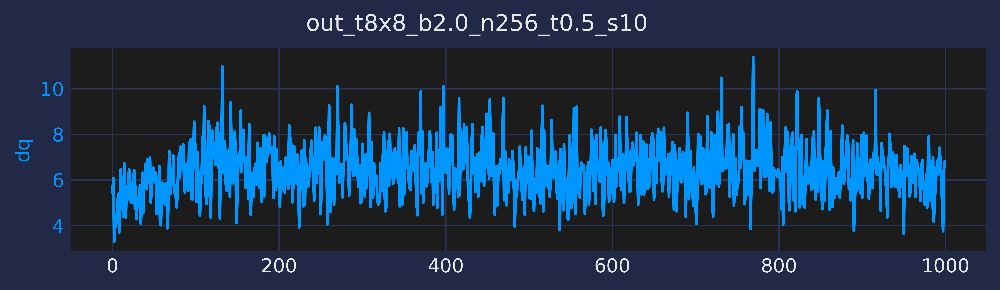

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

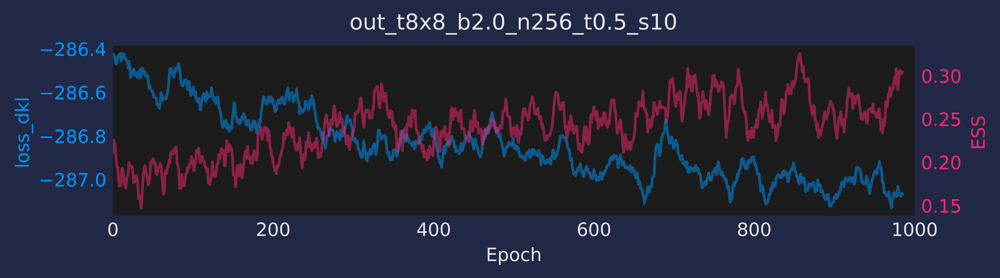

[09:31:57]  ----------------------------------------------------                             
            ERA=0, last took: 0 min 0 s                                                      
            ----------------------------------------------------

[09:32:00]  epoch=7.000 step=0.000 dt=0.343 loss=-286.507 dq=4.597 ess=0.204 plaq=0.669      
            loss_dkl=-286.507 logp=85.581 logq=-200.926

[09:32:05]  epoch=17.000 step=0.000 dt=0.329 loss=-286.423 dq=5.353 ess=0.176 plaq=0.662     
            loss_dkl=-286.423 logp=84.722 logq=-201.700

[09:32:12]  epoch=27.000 step=0.000 dt=0.369 loss=-286.425 dq=5.422 ess=0.196 plaq=0.661     
            loss_dkl=-286.425 logp=84.648 logq=-201.777

[09:32:19]  epoch=37.000 step=0.000 dt=0.406 loss=-286.628 dq=5.531 ess=0.111 plaq=0.663     
            loss_dkl=-286.628 logp=84.827 logq=-201.800

[09:32:27]  epoch=47.000 step=0.000 dt=0.453 loss=-286.526 dq=6.100 ess=0.152 plaq=0.666     
            loss_dkl=-286.526 logp=85.298 logq=-201.228

[09:32:35]  epoch=57.000 step=0.000 dt=0.453 loss=-286.675 dq=4.966 ess=0.119 plaq=0.666     
            loss_dkl=-286.675 logp=85.203 logq=-201.471

[09:32:43]  epoch=67.000 step=0.000 dt=0.446 loss=-286.717 dq=5.391 ess=0.203 plaq=0.668     
            loss_dkl=-286.717 logp=85.516 logq=-201.201

[09:32:51]  epoch=77.000 step=0.000 dt=0.443 loss=-286.656 dq=5.575 ess=0.204 plaq=0.668     
            loss_dkl=-286.656 logp=85.529 logq=-201.127

[09:32:59]  epoch=87.000 step=0.000 dt=0.425 loss=-286.454 dq=6.412 ess=0.175 plaq=0.672     
            loss_dkl=-286.454 logp=86.013 logq=-200.441

[09:33:07]  epoch=97.000 step=0.000 dt=0.440 loss=-286.642 dq=6.484 ess=0.162 plaq=0.672     
            loss_dkl=-286.642 logp=86.079 logq=-200.563

[09:33:10]  ----------------------------------------------------                             
            ERA=1, last took: 1 min 13.76 s                                                  
            ----------------------------------------------------

[09:33:15]  epoch=7.000 step=7.000 dt=0.460 loss=-286.552 dq=6.056 ess=0.206 plaq=0.669      
            loss_dkl=-286.552 logp=85.581 logq=-200.971

[09:33:24]  epoch=17.000 step=17.000 dt=0.486 loss=-286.655 dq=6.706 ess=0.233 plaq=0.661    
            loss_dkl=-286.655 logp=84.597 logq=-202.058

[09:33:33]  epoch=27.000 step=27.000 dt=0.495 loss=-286.634 dq=6.825 ess=0.154 plaq=0.669    
            loss_dkl=-286.634 logp=85.687 logq=-200.947

[09:33:42]  epoch=37.000 step=37.000 dt=0.516 loss=-286.646 dq=6.478 ess=0.233 plaq=0.664    
            loss_dkl=-286.646 logp=84.965 logq=-201.681

[09:33:51]  epoch=47.000 step=47.000 dt=0.492 loss=-286.858 dq=6.372 ess=0.240 plaq=0.674    
            loss_dkl=-286.858 logp=86.290 logq=-200.568

[09:34:00]  epoch=57.000 step=57.000 dt=0.486 loss=-286.750 dq=7.069 ess=0.249 plaq=0.664    
            loss_dkl=-286.750 logp=84.946 logq=-201.804

[09:34:09]  epoch=67.000 step=67.000 dt=0.480 loss=-286.846 dq=5.584 ess=0.207 plaq=0.675    
            loss_dkl=-286.846 logp=86.438 logq=-200.408

[09:34:18]  epoch=77.000 step=77.000 dt=0.466 loss=-286.575 dq=6.059 ess=0.215 plaq=0.663    
            loss_dkl=-286.575 logp=84.894 logq=-201.681

[09:34:26]  epoch=87.000 step=87.000 dt=0.418 loss=-286.680 dq=7.388 ess=0.224 plaq=0.668    
            loss_dkl=-286.680 logp=85.534 logq=-201.146

[09:34:34]  epoch=97.000 step=97.000 dt=0.422 loss=-286.644 dq=6.350 ess=0.277 plaq=0.666    
            loss_dkl=-286.644 logp=85.229 logq=-201.416

[09:34:38]  ----------------------------------------------------                             
            ERA=2, last took: 1 min 27.08 s                                                  
            ----------------------------------------------------

[09:34:41]  epoch=7.000 step=14.000 dt=0.384 loss=-286.692 dq=6.178 ess=0.182 plaq=0.663     
            loss_dkl=-286.692 logp=84.897 logq=-201.795

[09:34:49]  epoch=17.000 step=34.000 dt=0.382 loss=-286.510 dq=6.428 ess=0.229 plaq=0.668    
            loss_dkl=-286.510 logp=85.522 logq=-200.988

[09:34:55]  epoch=27.000 step=54.000 dt=0.359 loss=-286.742 dq=6.259 ess=0.233 plaq=0.670    
            loss_dkl=-286.742 logp=85.802 logq=-200.940

[09:35:02]  epoch=37.000 step=74.000 dt=0.349 loss=-286.681 dq=6.672 ess=0.216 plaq=0.673    
            loss_dkl=-286.681 logp=86.192 logq=-200.489

[09:35:09]  epoch=47.000 step=94.000 dt=0.362 loss=-286.708 dq=6.916 ess=0.228 plaq=0.667    
            loss_dkl=-286.708 logp=85.409 logq=-201.299

[09:35:15]  epoch=57.000 step=114.000 dt=0.360 loss=-286.696 dq=6.675 ess=0.229 plaq=0.672   
            loss_dkl=-286.696 logp=85.952 logq=-200.743

[09:35:22]  epoch=67.000 step=134.000 dt=0.373 loss=-286.880 dq=6.112 ess=0.235 plaq=0.666   
            loss_dkl=-286.880 logp=85.251 logq=-201.630

[09:35:29]  epoch=77.000 step=154.000 dt=0.368 loss=-286.823 dq=6.713 ess=0.313 plaq=0.676   
            loss_dkl=-286.823 logp=86.564 logq=-200.259

[09:35:36]  epoch=87.000 step=174.000 dt=0.359 loss=-286.914 dq=7.297 ess=0.281 plaq=0.672   
            loss_dkl=-286.914 logp=85.977 logq=-200.937

[09:35:42]  epoch=97.000 step=194.000 dt=0.331 loss=-286.634 dq=5.744 ess=0.191 plaq=0.669   
            loss_dkl=-286.634 logp=85.569 logq=-201.065

[09:35:45]  ----------------------------------------------------                             
            ERA=3, last took: 1 min 7.631 s                                                  
            ----------------------------------------------------

[09:35:49]  epoch=7.000 step=21.000 dt=0.352 loss=-286.741 dq=7.050 ess=0.232 plaq=0.667     
            loss_dkl=-286.741 logp=85.344 logq=-201.398

[09:35:56]  epoch=17.000 step=51.000 dt=0.358 loss=-286.837 dq=5.625 ess=0.293 plaq=0.668    
            loss_dkl=-286.837 logp=85.470 logq=-201.367

[09:36:02]  epoch=27.000 step=81.000 dt=0.357 loss=-286.821 dq=6.044 ess=0.222 plaq=0.672    
            loss_dkl=-286.821 logp=86.004 logq=-200.817

[09:36:09]  epoch=37.000 step=111.000 dt=0.372 loss=-286.863 dq=6.681 ess=0.297 plaq=0.668   
            loss_dkl=-286.863 logp=85.507 logq=-201.356

[09:36:16]  epoch=47.000 step=141.000 dt=0.381 loss=-286.792 dq=6.034 ess=0.275 plaq=0.671   
            loss_dkl=-286.792 logp=85.883 logq=-200.909

[09:36:24]  epoch=57.000 step=171.000 dt=0.459 loss=-287.083 dq=6.169 ess=0.214 plaq=0.678   
            loss_dkl=-287.083 logp=86.737 logq=-200.346

[09:36:32]  epoch=67.000 step=201.000 dt=0.456 loss=-286.897 dq=6.350 ess=0.168 plaq=0.664   
            loss_dkl=-286.897 logp=85.017 logq=-201.880

[09:36:41]  epoch=77.000 step=231.000 dt=0.496 loss=-286.777 dq=6.328 ess=0.264 plaq=0.671   
            loss_dkl=-286.777 logp=85.843 logq=-200.934

[09:36:50]  epoch=87.000 step=261.000 dt=0.507 loss=-286.806 dq=6.153 ess=0.282 plaq=0.672   
            loss_dkl=-286.806 logp=85.962 logq=-200.844

[09:37:00]  epoch=97.000 step=291.000 dt=0.505 loss=-286.853 dq=7.228 ess=0.184 plaq=0.667   
            loss_dkl=-286.853 logp=85.344 logq=-201.509

[09:37:05]  ----------------------------------------------------                             
            ERA=4, last took: 1 min 19.35 s                                                  
            ----------------------------------------------------

[09:37:10]  epoch=7.000 step=28.000 dt=0.562 loss=-286.661 dq=7.269 ess=0.215 plaq=0.674     
            loss_dkl=-286.661 logp=86.268 logq=-200.392

[09:37:21]  epoch=17.000 step=68.000 dt=0.628 loss=-287.008 dq=6.963 ess=0.277 plaq=0.676    
            loss_dkl=-287.008 logp=86.578 logq=-200.430

[09:37:31]  epoch=27.000 step=108.000 dt=0.584 loss=-286.690 dq=6.213 ess=0.192 plaq=0.674   
            loss_dkl=-286.690 logp=86.329 logq=-200.360

[09:37:41]  epoch=37.000 step=148.000 dt=0.585 loss=-286.838 dq=6.053 ess=0.265 plaq=0.669   
            loss_dkl=-286.838 logp=85.625 logq=-201.213

[09:37:52]  epoch=47.000 step=188.000 dt=0.603 loss=-286.833 dq=7.069 ess=0.255 plaq=0.673   
            loss_dkl=-286.833 logp=86.200 logq=-200.633

[09:38:03]  epoch=57.000 step=228.000 dt=0.604 loss=-286.754 dq=6.150 ess=0.219 plaq=0.667   
            loss_dkl=-286.754 logp=85.362 logq=-201.392

[09:38:14]  epoch=67.000 step=268.000 dt=0.575 loss=-286.796 dq=7.297 ess=0.208 plaq=0.674   
            loss_dkl=-286.796 logp=86.264 logq=-200.532

[09:38:25]  epoch=77.000 step=308.000 dt=0.587 loss=-286.696 dq=6.350 ess=0.319 plaq=0.669   
            loss_dkl=-286.696 logp=85.679 logq=-201.016

[09:38:36]  epoch=87.000 step=348.000 dt=0.584 loss=-286.771 dq=6.169 ess=0.193 plaq=0.670   
            loss_dkl=-286.771 logp=85.754 logq=-201.017

[09:38:47]  epoch=97.000 step=388.000 dt=0.634 loss=-286.908 dq=6.291 ess=0.248 plaq=0.673   
            loss_dkl=-286.908 logp=86.197 logq=-200.711

[09:38:52]  ----------------------------------------------------                             
            ERA=5, last took: 1 min 47.39 s                                                  
            ----------------------------------------------------

[09:38:58]  epoch=7.000 step=35.000 dt=0.565 loss=-286.755 dq=5.378 ess=0.213 plaq=0.670     
            loss_dkl=-286.755 logp=85.729 logq=-201.026

[09:39:09]  epoch=17.000 step=85.000 dt=0.559 loss=-286.905 dq=7.334 ess=0.250 plaq=0.672    
            loss_dkl=-286.905 logp=86.003 logq=-200.903

[09:39:19]  epoch=27.000 step=135.000 dt=0.541 loss=-286.890 dq=6.669 ess=0.254 plaq=0.677   
            loss_dkl=-286.890 logp=86.662 logq=-200.229

[09:39:30]  epoch=37.000 step=185.000 dt=0.631 loss=-286.788 dq=5.891 ess=0.271 plaq=0.666   
            loss_dkl=-286.788 logp=85.250 logq=-201.538

[09:39:41]  epoch=47.000 step=235.000 dt=0.573 loss=-286.951 dq=5.847 ess=0.214 plaq=0.673   
            loss_dkl=-286.951 logp=86.127 logq=-200.825

[09:39:52]  epoch=57.000 step=285.000 dt=0.554 loss=-286.916 dq=6.016 ess=0.253 plaq=0.681   
            loss_dkl=-286.916 logp=87.162 logq=-199.754

[09:40:03]  epoch=67.000 step=335.000 dt=0.593 loss=-286.810 dq=5.828 ess=0.275 plaq=0.666   
            loss_dkl=-286.810 logp=85.307 logq=-201.503

[09:40:13]  epoch=77.000 step=385.000 dt=0.595 loss=-286.932 dq=7.141 ess=0.230 plaq=0.673   
            loss_dkl=-286.932 logp=86.147 logq=-200.785

[09:40:24]  epoch=87.000 step=435.000 dt=0.574 loss=-286.988 dq=6.181 ess=0.208 plaq=0.672   
            loss_dkl=-286.988 logp=86.073 logq=-200.915

[09:40:35]  epoch=97.000 step=485.000 dt=0.550 loss=-287.068 dq=5.772 ess=0.231 plaq=0.678   
            loss_dkl=-287.068 logp=86.836 logq=-200.232

[09:40:39]  ----------------------------------------------------                             
            ERA=6, last took: 1 min 47.45 s                                                  
            ----------------------------------------------------

[09:40:45]  epoch=7.000 step=42.000 dt=0.568 loss=-286.910 dq=6.866 ess=0.192 plaq=0.673     
            loss_dkl=-286.910 logp=86.130 logq=-200.780

[09:40:55]  epoch=17.000 step=102.000 dt=0.539 loss=-287.032 dq=7.253 ess=0.222 plaq=0.680   
            loss_dkl=-287.032 logp=87.011 logq=-200.020

[09:41:05]  epoch=27.000 step=162.000 dt=0.575 loss=-286.893 dq=7.097 ess=0.307 plaq=0.666   
            loss_dkl=-286.893 logp=85.219 logq=-201.674

[09:41:15]  epoch=37.000 step=222.000 dt=0.538 loss=-286.895 dq=5.984 ess=0.256 plaq=0.672   
            loss_dkl=-286.895 logp=85.982 logq=-200.912

[09:41:25]  epoch=47.000 step=282.000 dt=0.487 loss=-286.845 dq=7.366 ess=0.226 plaq=0.670   
            loss_dkl=-286.845 logp=85.751 logq=-201.093

[09:41:34]  epoch=57.000 step=342.000 dt=0.487 loss=-287.040 dq=7.309 ess=0.197 plaq=0.683   
            loss_dkl=-287.040 logp=87.482 logq=-199.558

[09:41:43]  epoch=67.000 step=402.000 dt=0.495 loss=-287.072 dq=6.534 ess=0.333 plaq=0.674   
            loss_dkl=-287.072 logp=86.324 logq=-200.748

[09:41:53]  epoch=77.000 step=462.000 dt=0.515 loss=-287.007 dq=6.106 ess=0.215 plaq=0.672   
            loss_dkl=-287.007 logp=86.065 logq=-200.943

[09:42:02]  epoch=87.000 step=522.000 dt=0.501 loss=-286.982 dq=6.078 ess=0.307 plaq=0.674   
            loss_dkl=-286.982 logp=86.284 logq=-200.698

[09:42:11]  epoch=97.000 step=582.000 dt=0.497 loss=-286.824 dq=5.594 ess=0.288 plaq=0.671   
            loss_dkl=-286.824 logp=85.942 logq=-200.882

[09:42:15]  ----------------------------------------------------                             
            ERA=7, last took: 1 min 35.7 s                                                   
            ----------------------------------------------------

[09:42:20]  epoch=7.000 step=49.000 dt=0.478 loss=-286.923 dq=6.769 ess=0.342 plaq=0.673     
            loss_dkl=-286.923 logp=86.198 logq=-200.725

[09:42:29]  epoch=17.000 step=119.000 dt=0.488 loss=-286.812 dq=6.753 ess=0.229 plaq=0.670   
            loss_dkl=-286.812 logp=85.699 logq=-201.113

[09:42:38]  epoch=27.000 step=189.000 dt=0.477 loss=-287.042 dq=6.691 ess=0.348 plaq=0.675   
            loss_dkl=-287.042 logp=86.370 logq=-200.673

[09:42:48]  epoch=37.000 step=259.000 dt=0.556 loss=-287.026 dq=7.228 ess=0.253 plaq=0.677   
            loss_dkl=-287.026 logp=86.627 logq=-200.399

[09:42:58]  epoch=47.000 step=329.000 dt=0.558 loss=-287.084 dq=6.188 ess=0.258 plaq=0.675   
            loss_dkl=-287.084 logp=86.355 logq=-200.729

[09:43:07]  epoch=57.000 step=399.000 dt=0.478 loss=-286.957 dq=7.369 ess=0.299 plaq=0.673   
            loss_dkl=-286.957 logp=86.177 logq=-200.779

[09:43:17]  epoch=67.000 step=469.000 dt=0.527 loss=-286.835 dq=7.078 ess=0.198 plaq=0.675   
            loss_dkl=-286.835 logp=86.358 logq=-200.476

[09:43:28]  epoch=77.000 step=539.000 dt=0.585 loss=-287.068 dq=7.472 ess=0.165 plaq=0.672   
            loss_dkl=-287.068 logp=85.991 logq=-201.077

[09:43:38]  epoch=87.000 step=609.000 dt=0.663 loss=-286.880 dq=7.097 ess=0.299 plaq=0.672   
            loss_dkl=-286.880 logp=85.981 logq=-200.899

[09:43:50]  epoch=97.000 step=679.000 dt=0.671 loss=-286.909 dq=6.316 ess=0.219 plaq=0.679   
            loss_dkl=-286.909 logp=86.918 logq=-199.991

[09:43:56]  ----------------------------------------------------                             
            ERA=8, last took: 1 min 40.85 s                                                  
            ----------------------------------------------------

[09:44:03]  epoch=7.000 step=56.000 dt=0.719 loss=-286.875 dq=6.525 ess=0.240 plaq=0.673     
            loss_dkl=-286.875 logp=86.112 logq=-200.763

[09:44:16]  epoch=17.000 step=136.000 dt=0.714 loss=-287.163 dq=6.750 ess=0.285 plaq=0.679   
            loss_dkl=-287.163 logp=86.943 logq=-200.220

[09:44:29]  epoch=27.000 step=216.000 dt=0.712 loss=-287.134 dq=5.881 ess=0.286 plaq=0.672   
            loss_dkl=-287.134 logp=85.958 logq=-201.176

[09:44:41]  epoch=37.000 step=296.000 dt=0.618 loss=-286.921 dq=6.119 ess=0.218 plaq=0.678   
            loss_dkl=-286.921 logp=86.770 logq=-200.151

[09:44:54]  epoch=47.000 step=376.000 dt=0.729 loss=-286.984 dq=7.112 ess=0.309 plaq=0.674   
            loss_dkl=-286.984 logp=86.295 logq=-200.689

[09:45:08]  epoch=57.000 step=456.000 dt=0.779 loss=-286.946 dq=7.366 ess=0.286 plaq=0.673   
            loss_dkl=-286.946 logp=86.170 logq=-200.776

[09:45:21]  epoch=67.000 step=536.000 dt=0.670 loss=-287.153 dq=5.834 ess=0.336 plaq=0.675   
            loss_dkl=-287.153 logp=86.356 logq=-200.797

[09:45:33]  epoch=77.000 step=616.000 dt=0.652 loss=-287.055 dq=6.709 ess=0.312 plaq=0.670   
            loss_dkl=-287.055 logp=85.723 logq=-201.331

[09:45:45]  epoch=87.000 step=696.000 dt=0.603 loss=-286.965 dq=6.166 ess=0.234 plaq=0.675   
            loss_dkl=-286.965 logp=86.394 logq=-200.571

[09:45:58]  epoch=97.000 step=776.000 dt=0.694 loss=-287.172 dq=6.434 ess=0.284 plaq=0.679   
            loss_dkl=-287.172 logp=86.970 logq=-200.202

[09:46:04]  ----------------------------------------------------                             
            ERA=9, last took: 2 min 7.604 s                                                  
            ----------------------------------------------------

[09:46:11]  epoch=7.000 step=63.000 dt=0.739 loss=-287.163 dq=6.334 ess=0.271 plaq=0.675     
            loss_dkl=-287.163 logp=86.377 logq=-200.786

[09:46:26]  epoch=17.000 step=153.000 dt=0.843 loss=-287.007 dq=7.188 ess=0.249 plaq=0.674   
            loss_dkl=-287.007 logp=86.241 logq=-200.767

[09:46:41]  epoch=27.000 step=243.000 dt=0.848 loss=-287.033 dq=6.338 ess=0.255 plaq=0.674   
            loss_dkl=-287.033 logp=86.226 logq=-200.807

[09:46:55]  epoch=37.000 step=333.000 dt=0.713 loss=-287.043 dq=6.338 ess=0.252 plaq=0.668   
            loss_dkl=-287.043 logp=85.566 logq=-201.477

[09:47:08]  epoch=47.000 step=423.000 dt=0.682 loss=-287.170 dq=6.069 ess=0.224 plaq=0.679   
            loss_dkl=-287.170 logp=86.935 logq=-200.235

[09:47:20]  epoch=57.000 step=513.000 dt=0.599 loss=-286.966 dq=6.162 ess=0.319 plaq=0.673   
            loss_dkl=-286.966 logp=86.164 logq=-200.802

[09:47:33]  epoch=67.000 step=603.000 dt=0.639 loss=-286.894 dq=6.444 ess=0.258 plaq=0.679   
            loss_dkl=-286.894 logp=86.899 logq=-199.994

[09:47:45]  epoch=77.000 step=693.000 dt=0.620 loss=-287.150 dq=5.747 ess=0.308 plaq=0.677   
            loss_dkl=-287.150 logp=86.676 logq=-200.474

[09:47:57]  epoch=87.000 step=783.000 dt=0.615 loss=-287.034 dq=5.688 ess=0.305 plaq=0.682   
            loss_dkl=-287.034 logp=87.245 logq=-199.790

[09:48:08]  epoch=97.000 step=873.000 dt=0.575 loss=-287.063 dq=5.550 ess=0.311 plaq=0.668   
            loss_dkl=-287.063 logp=85.563 logq=-201.500

[09:48:14]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /models/pre_flow_model/2021-06-03-0931

[09:48:14]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s
            10/models/pre_flow_model/2021-06-03-0931/pre_flow_model.tar

[09:48:14]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-0931

[09:48:14]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0931/dq_training.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-0931/loss_dkl_ess_training.pdf

[09:48:15]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-094815

[09:48:15]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /metrics/training/pre_flow_model/2021-06-03-0931

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:48:15]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/step.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/dt.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/loss.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:48:16]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/dq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:48:17]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/plaq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/loss_dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:48:18]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/training/pre_flow_model/2021-06-03-094815/logq.pdf

[09:48:18]  Saving train_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5
            _s10/metrics/training/pre_flow_model/2021-06-03-0931/train_metrics.z.

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[09:49:03]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-094815

[09:49:03]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10
            /metrics/inference/pre_flow_model/2021-06-03-0931

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:49:03]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:49:04]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/dqsq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[09:49:05]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/logq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_t0.5_s10/p
            lots/inference/pre_flow_model/2021-06-03-094815/accepted.pdf

[09:49:06]  Saving inference_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t8x8_b2.0_n256_
            t0.5_s10/metrics/inference/pre_flow_model/2021-06-03-0931/inference_metrics.z.

[09:49:42]  Accept rate: 0.4881

In [24]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history


param8 = {
    'L': 8,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param8 = Param(**param8)
logger.log(repr(param8))

flow8 = make_net_from_layers(lattice_shape=tuple(param8.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config8 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

prior8 = MultivariateUniform(torch.zeros((2, *param8.lat)),
                              2. * PI * torch.ones(tuple(param8.lat)))

model8 = {'layers': flow8, 'prior': prior8}

DAYSTR8 = io.get_timestamp('%Y-%m-%d')
NOW8 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP8 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR8 = os.path.join(LOGS_DIR,
                           param8.uniquestr())
METRICS_DIR8 = os.path.join(PARAM_DIR8, 'metrics')
MODEL_DIR8 = os.path.join(PARAM_DIR8, 'models')
PLOTS_DIR8 = os.path.join(PARAM_DIR8, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR8)
io.check_else_make_dir(MODEL_DIR8)
io.check_else_make_dir(METRICS_DIR8)
io.check_else_make_dir(PLOTS_DIR8)

train_outputs8 = train(param8,
                        train_config8,
                        model=model8,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots8 = train_outputs8['plots']
pre_flow_history8 = train_outputs8['history']
flow_act8 = train_outputs8['action']

pre_flow_model8 = train_outputs8['model']
pre_flow_optimizer8 = train_outputs8['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step8 = train_config8.n_era * train_config8.n_epoch

outfile8 = os.path.join(MODEL_DIR8, 'pre_flow_model', TSTAMP8, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step8,
    outfile=outfile8,
    model=pre_flow_model8['layers'],
    optimizer=pre_flow_optimizer8,
    history=train_outputs8['history'],
    overwrite=True,
)

plots8 = train_outputs8['plots']
outdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', TSTAMP8)

save_live_plots(plots8, outdir8)


tstamp8 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', TSTAMP8)
if os.path.isdir(pdir8):
    pdir8 = os.path.join(PLOTS_DIR8, 'training', 'pre_flow_model', tstamp8)
    
mdir8 = os.path.join(METRICS_DIR8, 'training', 'pre_flow_model', TSTAMP8)
if os.path.isdir(mdir8):
    mdir8 = os.path.join(METRICS_DIR8, 'training', 'pre_flow_model', tstamp8)
    
io.check_else_make_dir(pdir8)
io.check_else_make_dir(mdir8)

plot_history(history=train_outputs8['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir8, alpha=0.5)

mfile8 = os.path.join(mdir8, 'train_metrics.z')
io.save_history(train_outputs8['history'], mfile8, name='train_metrics')


history8 = make_mcmc_ensemble(model=train_outputs8['model'],
                               action_fn=train_outputs8['action'],
                               batch_size=train_config8.batch_size,
                               num_samples=10000)

pdir8 = os.path.join(PLOTS_DIR8, 'inference', 'pre_flow_model', TSTAMP8)
if os.path.isdir(pdir):
    pdir8 = os.path.join(PLOTS_DIR8, 'inference', 'pre_flow_model', tstamp8)
    
mdir8 = os.path.join(PLOTS_DIR8,'inference', 'pre_flow_model', TSTAMP8)
if os.path.isdir(mdir):
    mdir8 = os.path.join(METRICS_DIR8, 'inference', 'pre_flow_model', TSTAMP8)
    
io.check_else_make_dir(pdir8)
io.check_else_make_dir(mdir8)

plot_history(history=history8,
             param=param8,
             outdir=pdir8,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile8 = os.path.join(mdir8, 'inference_metrics.z')

io.save_history(history8, mfile8, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

[09:52:07]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=12                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=True                                                                    
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[12, 12]                                                                     
            nd=2                                                                             
            shape=[2, 12, 12]                                                                
            volume=144                                                                       
            dt=0.05

[09:52:07]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10

[09:52:07]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10/models

[09:52:07]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10/metrics

[09:52:07]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10/plots

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

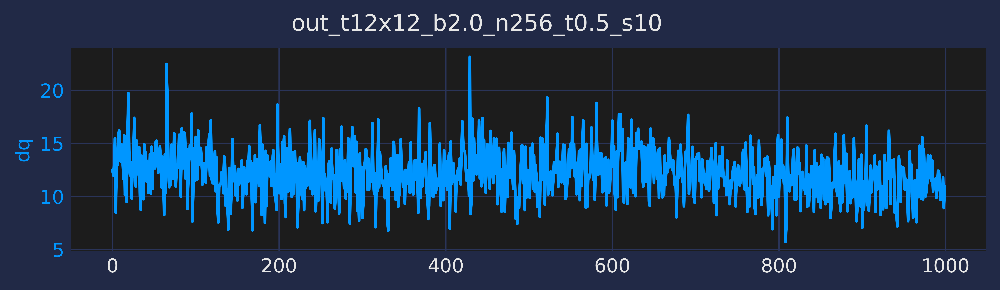

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

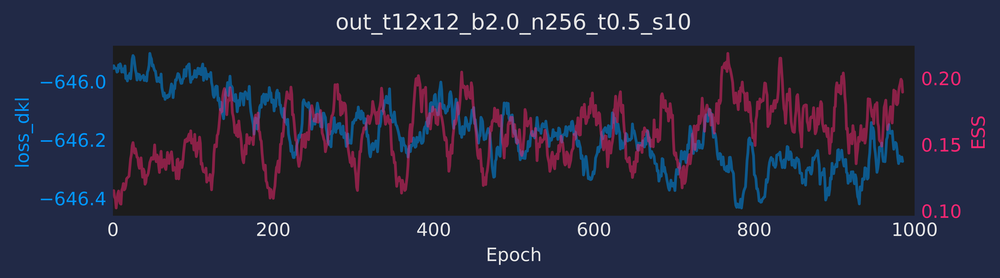

[09:52:08]  ----------------------------------------------------                             
            ERA=0, last took: 0 min 0 s                                                      
            ----------------------------------------------------

[09:52:14]  epoch=7.000 step=0.000 dt=0.623 loss=-646.107 dq=14.706 ess=0.129 plaq=0.681     
            loss_dkl=-646.107 logp=196.136 logq=-449.971

[09:52:25]  epoch=17.000 step=0.000 dt=0.861 loss=-645.897 dq=13.091 ess=0.111 plaq=0.676    
            loss_dkl=-645.897 logp=194.590 logq=-451.307

[09:52:38]  epoch=27.000 step=0.000 dt=0.884 loss=-645.896 dq=13.581 ess=0.120 plaq=0.674    
            loss_dkl=-645.896 logp=194.205 logq=-451.692

[09:52:53]  epoch=37.000 step=0.000 dt=1.137 loss=-645.829 dq=12.116 ess=0.196 plaq=0.675    
            loss_dkl=-645.829 logp=194.489 logq=-451.340

[09:53:12]  epoch=47.000 step=0.000 dt=1.483 loss=-645.992 dq=12.719 ess=0.138 plaq=0.679    
            loss_dkl=-645.992 logp=195.423 logq=-450.569

[09:53:32]  epoch=57.000 step=0.000 dt=1.394 loss=-645.996 dq=12.825 ess=0.122 plaq=0.678    
            loss_dkl=-645.996 logp=195.224 logq=-450.772

[09:53:54]  epoch=67.000 step=0.000 dt=1.426 loss=-646.021 dq=15.213 ess=0.146 plaq=0.681    
            loss_dkl=-646.021 logp=196.137 logq=-449.883

[09:54:14]  epoch=77.000 step=0.000 dt=1.424 loss=-646.246 dq=12.694 ess=0.121 plaq=0.676    
            loss_dkl=-646.246 logp=194.784 logq=-451.462

[09:54:35]  epoch=87.000 step=0.000 dt=1.433 loss=-645.929 dq=14.181 ess=0.115 plaq=0.674    
            loss_dkl=-645.929 logp=194.074 logq=-451.855

[09:54:56]  epoch=97.000 step=0.000 dt=1.428 loss=-646.057 dq=12.425 ess=0.151 plaq=0.683    
            loss_dkl=-646.057 logp=196.560 logq=-449.497

[09:55:04]  ----------------------------------------------------                             
            ERA=1, last took: 2 min 55.53 s                                                  
            ----------------------------------------------------

[09:55:19]  epoch=7.000 step=7.000 dt=1.476 loss=-645.911 dq=13.037 ess=0.159 plaq=0.676     
            loss_dkl=-645.911 logp=194.615 logq=-451.296

[09:55:39]  epoch=17.000 step=17.000 dt=1.231 loss=-645.803 dq=14.153 ess=0.134 plaq=0.671   
            loss_dkl=-645.803 logp=193.299 logq=-452.504

[09:55:56]  epoch=27.000 step=27.000 dt=1.159 loss=-646.121 dq=10.444 ess=0.120 plaq=0.678   
            loss_dkl=-646.121 logp=195.155 logq=-450.966

[09:56:12]  epoch=37.000 step=37.000 dt=1.070 loss=-646.150 dq=9.928 ess=0.151 plaq=0.679    
            loss_dkl=-646.150 logp=195.578 logq=-450.572

[09:56:29]  epoch=47.000 step=47.000 dt=1.318 loss=-646.029 dq=11.350 ess=0.170 plaq=0.675   
            loss_dkl=-646.029 logp=194.452 logq=-451.577

[09:56:45]  epoch=57.000 step=57.000 dt=0.986 loss=-645.960 dq=11.250 ess=0.184 plaq=0.681   
            loss_dkl=-645.960 logp=196.250 logq=-449.710

[09:57:01]  epoch=67.000 step=67.000 dt=1.082 loss=-646.193 dq=11.319 ess=0.176 plaq=0.677   
            loss_dkl=-646.193 logp=194.996 logq=-451.197

[09:57:17]  epoch=77.000 step=77.000 dt=1.034 loss=-646.094 dq=12.119 ess=0.124 plaq=0.674   
            loss_dkl=-646.094 logp=194.004 logq=-452.089

[09:57:33]  epoch=87.000 step=87.000 dt=1.080 loss=-646.214 dq=11.972 ess=0.146 plaq=0.683   
            loss_dkl=-646.214 logp=196.823 logq=-449.391

[09:57:48]  epoch=97.000 step=97.000 dt=1.143 loss=-645.914 dq=12.438 ess=0.131 plaq=0.676   
            loss_dkl=-645.914 logp=194.605 logq=-451.308

[09:57:53]  ----------------------------------------------------                             
            ERA=2, last took: 2 min 49.7 s                                                   
            ----------------------------------------------------

[09:58:04]  epoch=7.000 step=14.000 dt=1.040 loss=-645.967 dq=12.375 ess=0.129 plaq=0.672    
            loss_dkl=-645.967 logp=193.400 logq=-452.567

[09:58:20]  epoch=17.000 step=34.000 dt=1.068 loss=-646.082 dq=12.012 ess=0.164 plaq=0.681   
            loss_dkl=-646.082 logp=196.267 logq=-449.815

[09:58:36]  epoch=27.000 step=54.000 dt=1.141 loss=-646.138 dq=11.866 ess=0.197 plaq=0.677   
            loss_dkl=-646.138 logp=194.973 logq=-451.165

[09:58:52]  epoch=37.000 step=74.000 dt=1.126 loss=-646.393 dq=13.569 ess=0.137 plaq=0.680   
            loss_dkl=-646.393 logp=195.811 logq=-450.583

[09:59:08]  epoch=47.000 step=94.000 dt=1.066 loss=-646.131 dq=12.331 ess=0.190 plaq=0.679   
            loss_dkl=-646.131 logp=195.490 logq=-450.641

[09:59:23]  epoch=57.000 step=114.000 dt=1.051 loss=-646.018 dq=10.909 ess=0.163 plaq=0.674  
            loss_dkl=-646.018 logp=194.162 logq=-451.856

[09:59:38]  epoch=67.000 step=134.000 dt=0.957 loss=-645.916 dq=11.534 ess=0.145 plaq=0.673  
            loss_dkl=-645.916 logp=193.935 logq=-451.980

[09:59:52]  epoch=77.000 step=154.000 dt=0.958 loss=-646.228 dq=12.984 ess=0.142 plaq=0.680  
            loss_dkl=-646.228 logp=195.702 logq=-450.526

[10:00:06]  epoch=87.000 step=174.000 dt=0.926 loss=-646.063 dq=13.209 ess=0.199 plaq=0.679  
            loss_dkl=-646.063 logp=195.653 logq=-450.410

[10:00:23]  epoch=97.000 step=194.000 dt=1.147 loss=-646.256 dq=10.822 ess=0.145 plaq=0.676  
            loss_dkl=-646.256 logp=194.654 logq=-451.602

[10:00:28]  ----------------------------------------------------                             
            ERA=3, last took: 2 min 34.24 s                                                  
            ----------------------------------------------------

[10:00:39]  epoch=7.000 step=21.000 dt=1.132 loss=-646.266 dq=12.297 ess=0.086 plaq=0.681    
            loss_dkl=-646.266 logp=196.094 logq=-450.171

[10:00:55]  epoch=17.000 step=51.000 dt=1.070 loss=-646.037 dq=11.613 ess=0.131 plaq=0.681   
            loss_dkl=-646.037 logp=196.144 logq=-449.893

[10:01:11]  epoch=27.000 step=81.000 dt=1.031 loss=-646.149 dq=11.403 ess=0.156 plaq=0.680   
            loss_dkl=-646.149 logp=195.950 logq=-450.200

[10:01:27]  epoch=37.000 step=111.000 dt=1.101 loss=-646.160 dq=12.919 ess=0.237 plaq=0.677  
            loss_dkl=-646.160 logp=195.032 logq=-451.128

[10:01:42]  epoch=47.000 step=141.000 dt=0.993 loss=-645.973 dq=12.325 ess=0.198 plaq=0.674  
            loss_dkl=-645.973 logp=194.077 logq=-451.896

[10:01:57]  epoch=57.000 step=171.000 dt=0.917 loss=-646.034 dq=12.253 ess=0.144 plaq=0.677  
            loss_dkl=-646.034 logp=195.051 logq=-450.983

[10:02:11]  epoch=67.000 step=201.000 dt=0.986 loss=-646.191 dq=13.200 ess=0.096 plaq=0.678  
            loss_dkl=-646.191 logp=195.308 logq=-450.883

[10:02:25]  epoch=77.000 step=231.000 dt=0.907 loss=-646.213 dq=11.344 ess=0.137 plaq=0.677  
            loss_dkl=-646.213 logp=194.967 logq=-451.246

[10:02:38]  epoch=87.000 step=261.000 dt=0.936 loss=-646.178 dq=11.397 ess=0.170 plaq=0.677  
            loss_dkl=-646.178 logp=195.044 logq=-451.134

[10:02:52]  epoch=97.000 step=291.000 dt=0.895 loss=-646.204 dq=11.706 ess=0.166 plaq=0.681  
            loss_dkl=-646.204 logp=196.035 logq=-450.168

[10:02:56]  ----------------------------------------------------                             
            ERA=4, last took: 2 min 27.79 s                                                  
            ----------------------------------------------------

[10:03:04]  epoch=7.000 step=28.000 dt=0.891 loss=-646.124 dq=11.688 ess=0.129 plaq=0.678    
            loss_dkl=-646.124 logp=195.180 logq=-450.944

[10:03:21]  epoch=17.000 step=68.000 dt=1.104 loss=-646.129 dq=12.694 ess=0.198 plaq=0.686   
            loss_dkl=-646.129 logp=197.560 logq=-448.569

[10:03:37]  epoch=27.000 step=108.000 dt=1.203 loss=-646.331 dq=13.897 ess=0.122 plaq=0.678  
            loss_dkl=-646.331 logp=195.235 logq=-451.095

[10:03:58]  epoch=37.000 step=148.000 dt=1.668 loss=-646.219 dq=12.969 ess=0.228 plaq=0.679  
            loss_dkl=-646.219 logp=195.607 logq=-450.611

[10:04:17]  epoch=47.000 step=188.000 dt=1.303 loss=-646.255 dq=13.041 ess=0.203 plaq=0.678  
            loss_dkl=-646.255 logp=195.177 logq=-451.078

[10:04:34]  epoch=57.000 step=228.000 dt=1.155 loss=-646.168 dq=13.069 ess=0.178 plaq=0.679  
            loss_dkl=-646.168 logp=195.552 logq=-450.615

[10:04:51]  epoch=67.000 step=268.000 dt=1.086 loss=-646.318 dq=11.247 ess=0.078 plaq=0.677  
            loss_dkl=-646.318 logp=194.987 logq=-451.331

[10:05:06]  epoch=77.000 step=308.000 dt=0.991 loss=-646.293 dq=13.566 ess=0.142 plaq=0.674  
            loss_dkl=-646.293 logp=194.183 logq=-452.110

[10:05:20]  epoch=87.000 step=348.000 dt=0.968 loss=-646.430 dq=9.403 ess=0.184 plaq=0.681   
            loss_dkl=-646.430 logp=196.214 logq=-450.216

[10:05:33]  epoch=97.000 step=388.000 dt=0.903 loss=-646.044 dq=11.616 ess=0.128 plaq=0.676  
            loss_dkl=-646.044 logp=194.806 logq=-451.238

[10:05:37]  ----------------------------------------------------                             
            ERA=5, last took: 2 min 41.65 s                                                  
            ----------------------------------------------------

[10:05:46]  epoch=7.000 step=35.000 dt=0.824 loss=-646.145 dq=11.909 ess=0.193 plaq=0.679    
            loss_dkl=-646.145 logp=195.429 logq=-450.716

[10:05:58]  epoch=17.000 step=85.000 dt=0.814 loss=-646.297 dq=12.887 ess=0.156 plaq=0.678   
            loss_dkl=-646.297 logp=195.329 logq=-450.968

[10:06:11]  epoch=27.000 step=135.000 dt=0.832 loss=-646.099 dq=11.344 ess=0.213 plaq=0.678  
            loss_dkl=-646.099 logp=195.359 logq=-450.740

[10:06:23]  epoch=37.000 step=185.000 dt=0.828 loss=-646.219 dq=11.988 ess=0.127 plaq=0.681  
            loss_dkl=-646.219 logp=196.184 logq=-450.035

[10:06:35]  epoch=47.000 step=235.000 dt=0.834 loss=-646.250 dq=11.981 ess=0.141 plaq=0.683  
            loss_dkl=-646.250 logp=196.570 logq=-449.681

[10:06:48]  epoch=57.000 step=285.000 dt=0.869 loss=-646.160 dq=11.619 ess=0.103 plaq=0.674  
            loss_dkl=-646.160 logp=194.144 logq=-452.016

[10:07:00]  epoch=67.000 step=335.000 dt=0.805 loss=-646.207 dq=13.294 ess=0.162 plaq=0.679  
            loss_dkl=-646.207 logp=195.555 logq=-450.651

[10:07:12]  epoch=77.000 step=385.000 dt=0.815 loss=-646.071 dq=12.981 ess=0.102 plaq=0.680  
            loss_dkl=-646.071 logp=195.835 logq=-450.236

[10:07:24]  epoch=87.000 step=435.000 dt=0.806 loss=-646.261 dq=12.659 ess=0.208 plaq=0.677  
            loss_dkl=-646.261 logp=194.850 logq=-451.411

[10:07:36]  epoch=97.000 step=485.000 dt=0.785 loss=-646.307 dq=12.084 ess=0.186 plaq=0.677  
            loss_dkl=-646.307 logp=195.117 logq=-451.190

[10:07:39]  ----------------------------------------------------                             
            ERA=6, last took: 2 min 2.233 s                                                  
            ----------------------------------------------------

[10:07:48]  epoch=7.000 step=42.000 dt=0.828 loss=-646.430 dq=14.037 ess=0.163 plaq=0.682    
            loss_dkl=-646.430 logp=196.499 logq=-449.931

[10:08:00]  epoch=17.000 step=102.000 dt=0.799 loss=-645.997 dq=12.597 ess=0.156 plaq=0.677  
            loss_dkl=-645.997 logp=195.114 logq=-450.883

[10:08:13]  epoch=27.000 step=162.000 dt=0.937 loss=-646.229 dq=12.334 ess=0.180 plaq=0.680  
            loss_dkl=-646.229 logp=195.926 logq=-450.303

[10:08:26]  epoch=37.000 step=222.000 dt=0.874 loss=-646.128 dq=13.547 ess=0.219 plaq=0.682  
            loss_dkl=-646.128 logp=196.519 logq=-449.610

[10:08:40]  epoch=47.000 step=282.000 dt=1.081 loss=-646.260 dq=13.206 ess=0.118 plaq=0.676  
            loss_dkl=-646.260 logp=194.753 logq=-451.506

[10:08:54]  epoch=57.000 step=342.000 dt=1.029 loss=-646.314 dq=12.156 ess=0.166 plaq=0.685  
            loss_dkl=-646.314 logp=197.225 logq=-449.089

[10:09:10]  epoch=67.000 step=402.000 dt=1.133 loss=-646.230 dq=13.556 ess=0.153 plaq=0.679  
            loss_dkl=-646.230 logp=195.483 logq=-450.747

[10:09:27]  epoch=77.000 step=462.000 dt=1.074 loss=-646.150 dq=11.188 ess=0.180 plaq=0.680  
            loss_dkl=-646.150 logp=195.720 logq=-450.431

[10:09:44]  epoch=87.000 step=522.000 dt=1.232 loss=-646.276 dq=12.153 ess=0.202 plaq=0.677  
            loss_dkl=-646.276 logp=195.088 logq=-451.188

[10:10:00]  epoch=97.000 step=582.000 dt=1.119 loss=-646.222 dq=11.741 ess=0.232 plaq=0.680  
            loss_dkl=-646.222 logp=195.885 logq=-450.337

[10:10:05]  ----------------------------------------------------                             
            ERA=7, last took: 2 min 25.36 s                                                  
            ----------------------------------------------------

[10:10:14]  epoch=7.000 step=49.000 dt=0.949 loss=-646.417 dq=11.912 ess=0.147 plaq=0.683    
            loss_dkl=-646.417 logp=196.768 logq=-449.649

[10:10:29]  epoch=17.000 step=119.000 dt=1.007 loss=-646.324 dq=12.175 ess=0.133 plaq=0.680  
            loss_dkl=-646.324 logp=195.766 logq=-450.558

[10:10:42]  epoch=27.000 step=189.000 dt=0.848 loss=-646.264 dq=11.650 ess=0.148 plaq=0.678  
            loss_dkl=-646.264 logp=195.219 logq=-451.045

[10:10:55]  epoch=37.000 step=259.000 dt=0.865 loss=-646.438 dq=11.372 ess=0.186 plaq=0.676  
            loss_dkl=-646.438 logp=194.582 logq=-451.856

[10:11:07]  epoch=47.000 step=329.000 dt=0.820 loss=-646.025 dq=11.622 ess=0.230 plaq=0.681  
            loss_dkl=-646.025 logp=196.070 logq=-449.955

[10:11:21]  epoch=57.000 step=399.000 dt=1.001 loss=-646.215 dq=12.262 ess=0.137 plaq=0.678  
            loss_dkl=-646.215 logp=195.336 logq=-450.879

[10:11:36]  epoch=67.000 step=469.000 dt=0.919 loss=-646.337 dq=12.550 ess=0.184 plaq=0.682  
            loss_dkl=-646.337 logp=196.350 logq=-449.987

[10:11:50]  epoch=77.000 step=539.000 dt=0.869 loss=-646.386 dq=11.863 ess=0.189 plaq=0.679  
            loss_dkl=-646.386 logp=195.489 logq=-450.897

[10:12:05]  epoch=87.000 step=609.000 dt=1.078 loss=-646.513 dq=11.634 ess=0.188 plaq=0.679  
            loss_dkl=-646.513 logp=195.686 logq=-450.827

[10:12:21]  epoch=97.000 step=679.000 dt=1.258 loss=-646.163 dq=12.278 ess=0.230 plaq=0.679  
            loss_dkl=-646.163 logp=195.471 logq=-450.692

[10:12:27]  ----------------------------------------------------                             
            ERA=8, last took: 2 min 22.38 s                                                  
            ----------------------------------------------------

[10:12:39]  epoch=7.000 step=56.000 dt=1.162 loss=-646.228 dq=9.828 ess=0.148 plaq=0.684     
            loss_dkl=-646.228 logp=197.005 logq=-449.222

[10:12:57]  epoch=17.000 step=136.000 dt=1.247 loss=-646.415 dq=12.197 ess=0.227 plaq=0.676  
            loss_dkl=-646.415 logp=194.725 logq=-451.690

[10:13:16]  epoch=27.000 step=216.000 dt=1.250 loss=-646.301 dq=11.516 ess=0.180 plaq=0.682  
            loss_dkl=-646.301 logp=196.292 logq=-450.009

[10:13:35]  epoch=37.000 step=296.000 dt=1.288 loss=-646.349 dq=11.381 ess=0.193 plaq=0.680  
            loss_dkl=-646.349 logp=195.710 logq=-450.638

[10:13:49]  epoch=47.000 step=376.000 dt=0.945 loss=-646.349 dq=12.050 ess=0.195 plaq=0.676  
            loss_dkl=-646.349 logp=194.785 logq=-451.564

[10:14:03]  epoch=57.000 step=456.000 dt=0.909 loss=-646.138 dq=11.206 ess=0.210 plaq=0.681  
            loss_dkl=-646.138 logp=196.120 logq=-450.018

[10:14:16]  epoch=67.000 step=536.000 dt=0.899 loss=-646.161 dq=12.591 ess=0.192 plaq=0.683  
            loss_dkl=-646.161 logp=196.710 logq=-449.451

[10:14:28]  epoch=77.000 step=616.000 dt=0.769 loss=-646.371 dq=12.125 ess=0.172 plaq=0.680  
            loss_dkl=-646.371 logp=195.801 logq=-450.570

[10:14:40]  epoch=87.000 step=696.000 dt=0.713 loss=-646.230 dq=10.703 ess=0.169 plaq=0.681  
            loss_dkl=-646.230 logp=196.171 logq=-450.059

[10:14:50]  epoch=97.000 step=776.000 dt=0.686 loss=-646.323 dq=11.478 ess=0.165 plaq=0.681  
            loss_dkl=-646.323 logp=196.217 logq=-450.106

[10:14:53]  ----------------------------------------------------                             
            ERA=9, last took: 2 min 26.02 s                                                  
            ----------------------------------------------------

[10:15:00]  epoch=7.000 step=63.000 dt=0.697 loss=-646.180 dq=10.984 ess=0.146 plaq=0.676    
            loss_dkl=-646.180 logp=194.820 logq=-451.360

[10:15:10]  epoch=17.000 step=153.000 dt=0.678 loss=-646.308 dq=11.381 ess=0.183 plaq=0.680  
            loss_dkl=-646.308 logp=195.841 logq=-450.467

[10:15:20]  epoch=27.000 step=243.000 dt=0.689 loss=-646.362 dq=10.891 ess=0.135 plaq=0.680  
            loss_dkl=-646.362 logp=195.739 logq=-450.622

[10:15:30]  epoch=37.000 step=333.000 dt=0.649 loss=-646.290 dq=11.988 ess=0.174 plaq=0.674  
            loss_dkl=-646.290 logp=194.066 logq=-452.225

[10:15:40]  epoch=47.000 step=423.000 dt=0.712 loss=-646.195 dq=12.072 ess=0.163 plaq=0.681  
            loss_dkl=-646.195 logp=196.057 logq=-450.138

[10:15:52]  epoch=57.000 step=513.000 dt=0.769 loss=-646.181 dq=11.088 ess=0.176 plaq=0.684  
            loss_dkl=-646.181 logp=197.105 logq=-449.076

[10:16:04]  epoch=67.000 step=603.000 dt=0.856 loss=-646.349 dq=11.097 ess=0.157 plaq=0.681  
            loss_dkl=-646.349 logp=196.198 logq=-450.151

[10:16:16]  epoch=77.000 step=693.000 dt=0.902 loss=-646.127 dq=11.453 ess=0.209 plaq=0.677  
            loss_dkl=-646.127 logp=194.854 logq=-451.273

[10:16:28]  epoch=87.000 step=783.000 dt=0.805 loss=-646.239 dq=11.028 ess=0.178 plaq=0.679  
            loss_dkl=-646.239 logp=195.580 logq=-450.658

[10:16:40]  epoch=97.000 step=873.000 dt=0.789 loss=-646.263 dq=10.528 ess=0.176 plaq=0.684  
            loss_dkl=-646.263 logp=197.029 logq=-449.234

[10:16:44]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/models/pre_flow_model/2021-06-03-0952

[10:16:44]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5
            _s10/models/pre_flow_model/2021-06-03-0952/pre_flow_model.tar

[10:16:44]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/plots/training/pre_flow_model/2021-06-03-0952

[10:16:44]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-0952/dq_training.pdf

[10:16:45]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-0952/loss_dkl_ess_training.pdf

[10:16:45]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/plots/training/pre_flow_model/2021-06-03-101645

[10:16:45]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/metrics/training/pre_flow_model/2021-06-03-0952

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/step.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/dt.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/loss.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:16:46]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/dq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/plaq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/loss_dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:16:47]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-101645/logq.pdf

[10:16:47]  Saving train_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0
            .5_s10/metrics/training/pre_flow_model/2021-06-03-0952/train_metrics.z.

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[10:17:41]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/plots/inference/pre_flow_model/2021-06-03-101645

[10:17:41]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s
            10/metrics/inference/pre_flow_model/2021-06-03-0952

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:17:41]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:17:42]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/dqsq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/logq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:17:43]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-101645/accepted.pdf

[10:17:43]  Saving inference_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/metrics/inference/pre_flow_model/2021-06-03-0952/inference_metrics.z.

[10:18:19]  Accept rate: 0.4881

In [25]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history


param12 = {
    'L': 12,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param12 = Param(**param12)
logger.log(repr(param12))

flow12 = make_net_from_layers(lattice_shape=tuple(param12.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config12 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

prior12 = MultivariateUniform(torch.zeros((2, *param12.lat)),
                              2. * PI * torch.ones(tuple(param12.lat)))

model12 = {'layers': flow12, 'prior': prior12}

DAYSTR12 = io.get_timestamp('%Y-%m-%d')
NOW12 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP12 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR12 = os.path.join(LOGS_DIR,
                           param12.uniquestr())
METRICS_DIR12 = os.path.join(PARAM_DIR12, 'metrics')
MODEL_DIR12 = os.path.join(PARAM_DIR12, 'models')
PLOTS_DIR12 = os.path.join(PARAM_DIR12, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR12)
io.check_else_make_dir(MODEL_DIR12)
io.check_else_make_dir(METRICS_DIR12)
io.check_else_make_dir(PLOTS_DIR12)

train_outputs12 = train(param12,
                        train_config12,
                        model=model12,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots12 = train_outputs12['plots']
pre_flow_history12 = train_outputs12['history']
flow_act12 = train_outputs12['action']

pre_flow_model12 = train_outputs12['model']
pre_flow_optimizer12 = train_outputs12['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step12 = train_config12.n_era * train_config12.n_epoch

outfile12 = os.path.join(MODEL_DIR12, 'pre_flow_model', TSTAMP12, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step12,
    outfile=outfile12,
    model=pre_flow_model12['layers'],
    optimizer=pre_flow_optimizer12,
    history=train_outputs12['history'],
    overwrite=True,
)

plots12 = train_outputs12['plots']
outdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)

save_live_plots(plots12, outdir12)


tstamp12 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir12):
    pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir12):
    mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=train_outputs12['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir12, alpha=0.5)

mfile12 = os.path.join(mdir12, 'train_metrics.z')
io.save_history(train_outputs12['history'], mfile12, name='train_metrics')


history12 = make_mcmc_ensemble(model=train_outputs12['model'],
                               action_fn=train_outputs12['action'],
                               batch_size=train_config12.batch_size,
                               num_samples=10000)

pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir):
    pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(PLOTS_DIR12,'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir):
    mdir12 = os.path.join(METRICS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=history12,
             param=param12,
             outdir=pdir12,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile12 = os.path.join(mdir12, 'inference_metrics.z')

io.save_history(history12, mfile12, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

[10:19:52]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=True                                                                    
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

[10:19:52]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10

[10:19:52]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10/models

[10:19:52]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10/metrics

[10:19:52]  Creating directory:                                                              
            /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10/plots

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

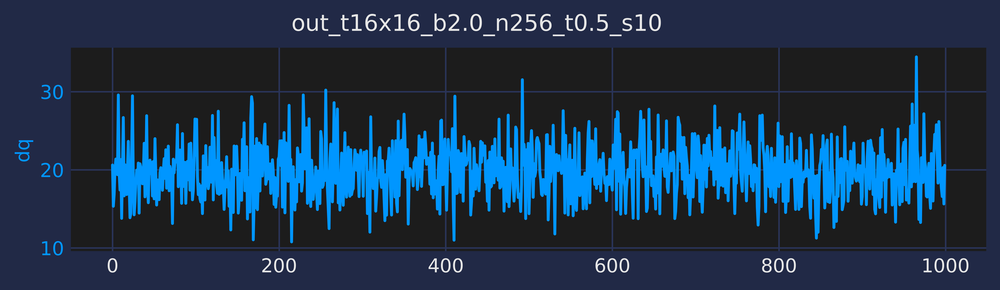

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

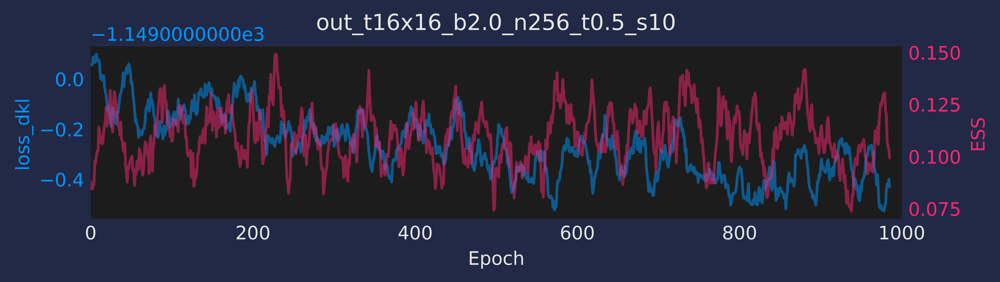

[10:19:54]  ----------------------------------------------------                             
            ERA=0, last took: 0 min 0 s                                                      
            ----------------------------------------------------

[10:20:01]  epoch=7.000 step=0.000 dt=0.660 loss=-1149.032 dq=21.297 ess=0.054 plaq=0.680    
            loss_dkl=-1149.032 logp=348.065 logq=-800.967

[10:20:12]  epoch=17.000 step=0.000 dt=0.868 loss=-1148.940 dq=20.044 ess=0.097 plaq=0.681   
            loss_dkl=-1148.940 logp=348.527 logq=-800.413

[10:20:25]  epoch=27.000 step=0.000 dt=0.924 loss=-1149.024 dq=17.363 ess=0.121 plaq=0.678   
            loss_dkl=-1149.024 logp=346.881 logq=-802.143

[10:20:38]  epoch=37.000 step=0.000 dt=0.994 loss=-1149.280 dq=19.238 ess=0.136 plaq=0.679   
            loss_dkl=-1149.280 logp=347.730 logq=-801.551

[10:20:52]  epoch=47.000 step=0.000 dt=0.977 loss=-1149.042 dq=19.878 ess=0.079 plaq=0.681   
            loss_dkl=-1149.042 logp=348.431 logq=-800.611

[10:21:06]  epoch=57.000 step=0.000 dt=0.958 loss=-1148.974 dq=18.753 ess=0.086 plaq=0.679   
            loss_dkl=-1148.974 logp=347.601 logq=-801.373

[10:21:20]  epoch=67.000 step=0.000 dt=0.943 loss=-1149.364 dq=19.428 ess=0.076 plaq=0.681   
            loss_dkl=-1149.364 logp=348.890 logq=-800.474

[10:21:36]  epoch=77.000 step=0.000 dt=1.127 loss=-1149.150 dq=21.419 ess=0.082 plaq=0.677   
            loss_dkl=-1149.150 logp=346.799 logq=-802.352

[10:21:50]  epoch=87.000 step=0.000 dt=1.053 loss=-1149.047 dq=18.556 ess=0.118 plaq=0.678   
            loss_dkl=-1149.047 logp=347.197 logq=-801.850

[10:22:05]  epoch=97.000 step=0.000 dt=1.099 loss=-1148.984 dq=20.169 ess=0.155 plaq=0.680   
            loss_dkl=-1148.984 logp=348.097 logq=-800.887

[10:22:10]  ----------------------------------------------------                             
            ERA=1, last took: 2 min 15.56 s                                                  
            ----------------------------------------------------

[10:22:20]  epoch=7.000 step=7.000 dt=1.003 loss=-1149.295 dq=17.259 ess=0.071 plaq=0.681    
            loss_dkl=-1149.295 logp=348.677 logq=-800.617

[10:22:35]  epoch=17.000 step=17.000 dt=1.150 loss=-1149.098 dq=19.759 ess=0.151 plaq=0.678  
            loss_dkl=-1149.098 logp=346.998 logq=-802.099

[10:22:49]  epoch=27.000 step=27.000 dt=0.970 loss=-1149.030 dq=19.837 ess=0.116 plaq=0.679  
            loss_dkl=-1149.030 logp=347.484 logq=-801.546

[10:23:03]  epoch=37.000 step=37.000 dt=0.986 loss=-1148.992 dq=19.178 ess=0.087 plaq=0.677  
            loss_dkl=-1148.992 logp=346.815 logq=-802.177

[10:23:18]  epoch=47.000 step=47.000 dt=1.053 loss=-1148.958 dq=20.156 ess=0.151 plaq=0.676  
            loss_dkl=-1148.958 logp=346.337 logq=-802.621

[10:23:32]  epoch=57.000 step=57.000 dt=0.996 loss=-1149.060 dq=20.947 ess=0.109 plaq=0.686  
            loss_dkl=-1149.060 logp=351.279 logq=-797.781

[10:23:47]  epoch=67.000 step=67.000 dt=1.043 loss=-1149.167 dq=22.031 ess=0.088 plaq=0.680  
            loss_dkl=-1149.167 logp=348.259 logq=-800.909

[10:24:01]  epoch=77.000 step=77.000 dt=1.035 loss=-1149.089 dq=20.916 ess=0.139 plaq=0.680  
            loss_dkl=-1149.089 logp=347.995 logq=-801.094

[10:24:16]  epoch=87.000 step=87.000 dt=1.080 loss=-1148.897 dq=20.012 ess=0.097 plaq=0.680  
            loss_dkl=-1148.897 logp=348.350 logq=-800.547

[10:24:32]  epoch=97.000 step=97.000 dt=1.244 loss=-1149.056 dq=17.797 ess=0.095 plaq=0.676  
            loss_dkl=-1149.056 logp=346.275 logq=-802.780

[10:24:37]  ----------------------------------------------------                             
            ERA=2, last took: 2 min 27.27 s                                                  
            ----------------------------------------------------

[10:24:47]  epoch=7.000 step=14.000 dt=0.999 loss=-1149.111 dq=19.659 ess=0.138 plaq=0.680   
            loss_dkl=-1149.111 logp=348.291 logq=-800.821

[10:25:01]  epoch=17.000 step=34.000 dt=0.956 loss=-1149.277 dq=16.297 ess=0.073 plaq=0.682  
            loss_dkl=-1149.277 logp=349.168 logq=-800.110

[10:25:15]  epoch=27.000 step=54.000 dt=0.987 loss=-1149.280 dq=21.128 ess=0.105 plaq=0.681  
            loss_dkl=-1149.280 logp=348.742 logq=-800.538

[10:25:28]  epoch=37.000 step=74.000 dt=0.888 loss=-1149.204 dq=19.841 ess=0.130 plaq=0.675  
            loss_dkl=-1149.204 logp=345.674 logq=-803.530

[10:25:40]  epoch=47.000 step=94.000 dt=0.846 loss=-1149.091 dq=17.144 ess=0.074 plaq=0.680  
            loss_dkl=-1149.091 logp=348.072 logq=-801.019

[10:25:53]  epoch=57.000 step=114.000 dt=1.066 loss=-1149.087 dq=20.550 ess=0.083 plaq=0.680 
            loss_dkl=-1149.087 logp=348.330 logq=-800.756

[10:26:05]  epoch=67.000 step=134.000 dt=0.876 loss=-1149.341 dq=22.291 ess=0.115 plaq=0.679 
            loss_dkl=-1149.341 logp=347.563 logq=-801.778

[10:26:18]  epoch=77.000 step=154.000 dt=0.870 loss=-1149.150 dq=19.906 ess=0.085 plaq=0.677 
            loss_dkl=-1149.150 logp=346.385 logq=-802.766

[10:26:33]  epoch=87.000 step=174.000 dt=1.193 loss=-1149.268 dq=18.194 ess=0.128 plaq=0.681 
            loss_dkl=-1149.268 logp=348.429 logq=-800.839

[10:26:48]  epoch=97.000 step=194.000 dt=1.135 loss=-1149.055 dq=20.141 ess=0.091 plaq=0.683 
            loss_dkl=-1149.055 logp=349.555 logq=-799.500

[10:26:52]  ----------------------------------------------------                             
            ERA=3, last took: 2 min 15.53 s                                                  
            ----------------------------------------------------

[10:27:03]  epoch=7.000 step=21.000 dt=0.995 loss=-1149.269 dq=17.441 ess=0.104 plaq=0.680   
            loss_dkl=-1149.269 logp=348.360 logq=-800.909

[10:27:19]  epoch=17.000 step=51.000 dt=1.058 loss=-1149.270 dq=18.122 ess=0.095 plaq=0.681  
            loss_dkl=-1149.270 logp=348.818 logq=-800.452

[10:27:33]  epoch=27.000 step=81.000 dt=0.997 loss=-1149.268 dq=16.572 ess=0.091 plaq=0.683  
            loss_dkl=-1149.268 logp=349.917 logq=-799.351

[10:27:48]  epoch=37.000 step=111.000 dt=1.022 loss=-1149.145 dq=18.981 ess=0.098 plaq=0.681 
            loss_dkl=-1149.145 logp=348.445 logq=-800.700

[10:28:02]  epoch=47.000 step=141.000 dt=1.119 loss=-1149.388 dq=22.300 ess=0.122 plaq=0.679 
            loss_dkl=-1149.388 logp=347.407 logq=-801.980

[10:28:17]  epoch=57.000 step=171.000 dt=1.086 loss=-1149.246 dq=18.184 ess=0.121 plaq=0.684 
            loss_dkl=-1149.246 logp=349.963 logq=-799.283

[10:28:30]  epoch=67.000 step=201.000 dt=1.036 loss=-1149.254 dq=19.922 ess=0.081 plaq=0.679 
            loss_dkl=-1149.254 logp=347.607 logq=-801.647

[10:28:43]  epoch=77.000 step=231.000 dt=0.892 loss=-1149.418 dq=22.256 ess=0.136 plaq=0.681 
            loss_dkl=-1149.418 logp=348.696 logq=-800.722

[10:28:57]  epoch=87.000 step=261.000 dt=0.924 loss=-1149.111 dq=18.209 ess=0.080 plaq=0.684 
            loss_dkl=-1149.111 logp=350.011 logq=-799.100

[10:29:11]  epoch=97.000 step=291.000 dt=0.915 loss=-1149.205 dq=21.856 ess=0.117 plaq=0.683 
            loss_dkl=-1149.205 logp=349.563 logq=-799.642

[10:29:15]  ----------------------------------------------------                             
            ERA=4, last took: 2 min 22.63 s                                                  
            ----------------------------------------------------

[10:29:25]  epoch=7.000 step=28.000 dt=1.028 loss=-1149.005 dq=20.962 ess=0.064 plaq=0.683   
            loss_dkl=-1149.005 logp=349.764 logq=-799.241

[10:29:41]  epoch=17.000 step=68.000 dt=1.270 loss=-1149.091 dq=20.516 ess=0.111 plaq=0.678  
            loss_dkl=-1149.091 logp=346.914 logq=-802.177

[10:29:57]  epoch=27.000 step=108.000 dt=1.052 loss=-1149.196 dq=22.056 ess=0.094 plaq=0.681 
            loss_dkl=-1149.196 logp=348.592 logq=-800.604

[10:30:12]  epoch=37.000 step=148.000 dt=1.195 loss=-1149.365 dq=19.356 ess=0.062 plaq=0.682 
            loss_dkl=-1149.365 logp=349.165 logq=-800.200

[10:30:29]  epoch=47.000 step=188.000 dt=1.104 loss=-1149.446 dq=21.106 ess=0.075 plaq=0.681 
            loss_dkl=-1149.446 logp=348.777 logq=-800.670

[10:30:46]  epoch=57.000 step=228.000 dt=1.310 loss=-1149.145 dq=20.584 ess=0.148 plaq=0.683 
            loss_dkl=-1149.145 logp=349.744 logq=-799.401

[10:31:03]  epoch=67.000 step=268.000 dt=1.147 loss=-1149.200 dq=19.509 ess=0.099 plaq=0.678 
            loss_dkl=-1149.200 logp=347.248 logq=-801.952

[10:31:19]  epoch=77.000 step=308.000 dt=1.148 loss=-1149.401 dq=20.363 ess=0.106 plaq=0.680 
            loss_dkl=-1149.401 logp=348.175 logq=-801.226

[10:31:34]  epoch=87.000 step=348.000 dt=1.045 loss=-1149.202 dq=18.906 ess=0.126 plaq=0.683 
            loss_dkl=-1149.202 logp=349.929 logq=-799.273

[10:31:50]  epoch=97.000 step=388.000 dt=1.087 loss=-1149.364 dq=20.319 ess=0.105 plaq=0.683 
            loss_dkl=-1149.364 logp=349.684 logq=-799.681

[10:31:54]  ----------------------------------------------------                             
            ERA=5, last took: 2 min 39.2 s                                                   
            ----------------------------------------------------

[10:32:06]  epoch=7.000 step=35.000 dt=1.107 loss=-1149.336 dq=19.978 ess=0.070 plaq=0.681   
            loss_dkl=-1149.336 logp=348.687 logq=-800.649

[10:32:21]  epoch=17.000 step=85.000 dt=1.070 loss=-1149.081 dq=17.663 ess=0.127 plaq=0.681  
            loss_dkl=-1149.081 logp=348.586 logq=-800.495

[10:32:37]  epoch=27.000 step=135.000 dt=1.119 loss=-1149.388 dq=21.444 ess=0.078 plaq=0.678 
            loss_dkl=-1149.388 logp=347.053 logq=-802.335

[10:32:53]  epoch=37.000 step=185.000 dt=1.101 loss=-1149.188 dq=20.394 ess=0.120 plaq=0.681 
            loss_dkl=-1149.188 logp=348.833 logq=-800.355

[10:33:08]  epoch=47.000 step=235.000 dt=1.080 loss=-1149.497 dq=19.312 ess=0.089 plaq=0.682 
            loss_dkl=-1149.497 logp=349.290 logq=-800.207

[10:33:23]  epoch=57.000 step=285.000 dt=1.010 loss=-1149.354 dq=18.744 ess=0.095 plaq=0.680 
            loss_dkl=-1149.354 logp=347.929 logq=-801.426

[10:33:38]  epoch=67.000 step=335.000 dt=1.044 loss=-1149.302 dq=16.884 ess=0.106 plaq=0.680 
            loss_dkl=-1149.302 logp=348.216 logq=-801.086

[10:33:52]  epoch=77.000 step=385.000 dt=0.957 loss=-1149.520 dq=20.653 ess=0.148 plaq=0.684 
            loss_dkl=-1149.520 logp=350.257 logq=-799.263

[10:34:05]  epoch=87.000 step=435.000 dt=0.903 loss=-1149.339 dq=20.225 ess=0.151 plaq=0.682 
            loss_dkl=-1149.339 logp=349.249 logq=-800.090

[10:34:19]  epoch=97.000 step=485.000 dt=0.922 loss=-1149.201 dq=19.250 ess=0.124 plaq=0.685 
            loss_dkl=-1149.201 logp=350.888 logq=-798.313

[10:34:23]  ----------------------------------------------------                             
            ERA=6, last took: 2 min 28.42 s                                                  
            ----------------------------------------------------

[10:34:32]  epoch=7.000 step=42.000 dt=0.901 loss=-1149.323 dq=22.534 ess=0.114 plaq=0.679   
            loss_dkl=-1149.323 logp=347.512 logq=-801.811

[10:34:45]  epoch=17.000 step=102.000 dt=0.879 loss=-1149.098 dq=17.794 ess=0.088 plaq=0.677 
            loss_dkl=-1149.098 logp=346.552 logq=-802.546

[10:34:57]  epoch=27.000 step=162.000 dt=0.943 loss=-1149.451 dq=20.441 ess=0.140 plaq=0.686 
            loss_dkl=-1149.451 logp=351.264 logq=-798.186

[10:35:10]  epoch=37.000 step=222.000 dt=0.861 loss=-1149.167 dq=22.247 ess=0.069 plaq=0.682 
            loss_dkl=-1149.167 logp=349.386 logq=-799.781

[10:35:22]  epoch=47.000 step=282.000 dt=0.863 loss=-1149.258 dq=19.831 ess=0.109 plaq=0.678 
            loss_dkl=-1149.258 logp=347.226 logq=-802.032

[10:35:35]  epoch=57.000 step=342.000 dt=0.879 loss=-1149.244 dq=20.922 ess=0.099 plaq=0.682 
            loss_dkl=-1149.244 logp=349.032 logq=-800.212

[10:35:47]  epoch=67.000 step=402.000 dt=0.826 loss=-1149.313 dq=20.225 ess=0.088 plaq=0.684 
            loss_dkl=-1149.313 logp=350.444 logq=-798.870

[10:36:00]  epoch=77.000 step=462.000 dt=0.866 loss=-1149.324 dq=18.034 ess=0.161 plaq=0.685 
            loss_dkl=-1149.324 logp=350.519 logq=-798.805

[10:36:12]  epoch=87.000 step=522.000 dt=0.940 loss=-1149.285 dq=21.019 ess=0.092 plaq=0.677 
            loss_dkl=-1149.285 logp=346.781 logq=-802.504

[10:36:25]  epoch=97.000 step=582.000 dt=0.857 loss=-1149.403 dq=21.219 ess=0.098 plaq=0.682 
            loss_dkl=-1149.403 logp=349.123 logq=-800.280

[10:36:29]  ----------------------------------------------------                             
            ERA=7, last took: 2 min 6.085 s                                                  
            ----------------------------------------------------

[10:36:38]  epoch=7.000 step=49.000 dt=0.904 loss=-1149.285 dq=17.312 ess=0.062 plaq=0.681   
            loss_dkl=-1149.285 logp=348.548 logq=-800.737

[10:36:51]  epoch=17.000 step=119.000 dt=0.874 loss=-1149.322 dq=21.756 ess=0.125 plaq=0.679 
            loss_dkl=-1149.322 logp=347.543 logq=-801.779

[10:37:04]  epoch=27.000 step=189.000 dt=0.968 loss=-1149.192 dq=21.044 ess=0.090 plaq=0.685 
            loss_dkl=-1149.192 logp=350.620 logq=-798.572

[10:37:18]  epoch=37.000 step=259.000 dt=0.982 loss=-1149.376 dq=19.450 ess=0.161 plaq=0.683 
            loss_dkl=-1149.376 logp=349.788 logq=-799.588

[10:37:31]  epoch=47.000 step=329.000 dt=0.929 loss=-1149.468 dq=18.919 ess=0.118 plaq=0.679 
            loss_dkl=-1149.468 logp=347.618 logq=-801.849

[10:37:45]  epoch=57.000 step=399.000 dt=0.955 loss=-1149.338 dq=21.306 ess=0.132 plaq=0.681 
            loss_dkl=-1149.338 logp=348.483 logq=-800.856

[10:37:59]  epoch=67.000 step=469.000 dt=0.964 loss=-1149.353 dq=19.647 ess=0.097 plaq=0.685 
            loss_dkl=-1149.353 logp=350.624 logq=-798.729

[10:38:16]  epoch=77.000 step=539.000 dt=1.399 loss=-1149.435 dq=20.753 ess=0.083 plaq=0.684 
            loss_dkl=-1149.435 logp=350.063 logq=-799.372

[10:38:34]  epoch=87.000 step=609.000 dt=1.482 loss=-1149.076 dq=20.684 ess=0.165 plaq=0.683 
            loss_dkl=-1149.076 logp=349.867 logq=-799.209

[10:38:55]  epoch=97.000 step=679.000 dt=1.360 loss=-1149.584 dq=20.481 ess=0.077 plaq=0.681 
            loss_dkl=-1149.584 logp=348.824 logq=-800.760

[10:39:00]  ----------------------------------------------------                             
            ERA=8, last took: 2 min 31.51 s                                                  
            ----------------------------------------------------

[10:39:15]  epoch=7.000 step=56.000 dt=1.509 loss=-1149.486 dq=17.288 ess=0.139 plaq=0.682   
            loss_dkl=-1149.486 logp=349.294 logq=-800.191

[10:39:34]  epoch=17.000 step=136.000 dt=1.381 loss=-1149.652 dq=20.475 ess=0.097 plaq=0.681 
            loss_dkl=-1149.652 logp=348.563 logq=-801.090

[10:39:51]  epoch=27.000 step=216.000 dt=1.191 loss=-1149.431 dq=19.931 ess=0.123 plaq=0.683 
            loss_dkl=-1149.431 logp=349.689 logq=-799.742

[10:40:09]  epoch=37.000 step=296.000 dt=1.382 loss=-1149.242 dq=18.547 ess=0.079 plaq=0.682 
            loss_dkl=-1149.242 logp=349.421 logq=-799.821

[10:40:29]  epoch=47.000 step=376.000 dt=1.497 loss=-1149.620 dq=16.197 ess=0.090 plaq=0.683 
            loss_dkl=-1149.620 logp=349.676 logq=-799.944

[10:40:48]  epoch=57.000 step=456.000 dt=1.271 loss=-1149.450 dq=19.075 ess=0.131 plaq=0.681 
            loss_dkl=-1149.450 logp=348.860 logq=-800.589

[10:41:06]  epoch=67.000 step=536.000 dt=1.190 loss=-1149.506 dq=15.369 ess=0.113 plaq=0.683 
            loss_dkl=-1149.506 logp=349.893 logq=-799.613

[10:41:22]  epoch=77.000 step=616.000 dt=1.111 loss=-1149.507 dq=18.675 ess=0.070 plaq=0.684 
            loss_dkl=-1149.507 logp=350.438 logq=-799.069

[10:41:38]  epoch=87.000 step=696.000 dt=1.072 loss=-1149.218 dq=20.312 ess=0.140 plaq=0.678 
            loss_dkl=-1149.218 logp=347.072 logq=-802.146

[10:41:53]  epoch=97.000 step=776.000 dt=1.006 loss=-1149.559 dq=18.819 ess=0.110 plaq=0.680 
            loss_dkl=-1149.559 logp=348.110 logq=-801.448

[10:41:57]  ----------------------------------------------------                             
            ERA=9, last took: 2 min 56.59 s                                                  
            ----------------------------------------------------

[10:42:06]  epoch=7.000 step=63.000 dt=0.955 loss=-1149.365 dq=19.812 ess=0.085 plaq=0.684   
            loss_dkl=-1149.365 logp=350.005 logq=-799.360

[10:42:20]  epoch=17.000 step=153.000 dt=0.882 loss=-1149.519 dq=17.653 ess=0.100 plaq=0.682 
            loss_dkl=-1149.519 logp=349.362 logq=-800.158

[10:42:33]  epoch=27.000 step=243.000 dt=0.939 loss=-1149.224 dq=19.081 ess=0.081 plaq=0.682 
            loss_dkl=-1149.224 logp=349.201 logq=-800.024

[10:42:47]  epoch=37.000 step=333.000 dt=0.925 loss=-1149.126 dq=18.538 ess=0.100 plaq=0.682 
            loss_dkl=-1149.126 logp=349.076 logq=-800.050

[10:43:00]  epoch=47.000 step=423.000 dt=0.875 loss=-1149.330 dq=18.734 ess=0.059 plaq=0.679 
            loss_dkl=-1149.330 logp=347.577 logq=-801.753

[10:43:13]  epoch=57.000 step=513.000 dt=0.931 loss=-1149.437 dq=19.422 ess=0.113 plaq=0.681 
            loss_dkl=-1149.437 logp=348.525 logq=-800.912

[10:43:26]  epoch=67.000 step=603.000 dt=0.871 loss=-1149.236 dq=21.850 ess=0.099 plaq=0.680 
            loss_dkl=-1149.236 logp=348.073 logq=-801.164

[10:43:39]  epoch=77.000 step=693.000 dt=0.973 loss=-1149.440 dq=18.859 ess=0.111 plaq=0.681 
            loss_dkl=-1149.440 logp=348.490 logq=-800.950

[10:43:52]  epoch=87.000 step=783.000 dt=0.963 loss=-1149.602 dq=22.275 ess=0.128 plaq=0.682 
            loss_dkl=-1149.602 logp=349.349 logq=-800.252

[10:44:06]  epoch=97.000 step=873.000 dt=0.973 loss=-1149.309 dq=18.134 ess=0.067 plaq=0.680 
            loss_dkl=-1149.309 logp=348.004 logq=-801.306

[10:44:11]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/models/pre_flow_model/2021-06-03-1019

[10:44:11]  Saving checkpoint to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5
            _s10/models/pre_flow_model/2021-06-03-1019/pre_flow_model.tar

[10:44:11]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/plots/training/pre_flow_model/2021-06-03-1019

[10:44:11]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-1019/dq_training.pdf

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-1019/loss_dkl_ess_training.pdf

[10:44:12]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/plots/training/pre_flow_model/2021-06-03-104411

[10:44:12]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/metrics/training/pre_flow_model/2021-06-03-1019

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:44:12]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/step.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/dt.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/loss.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:44:13]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/dq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/plaq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/loss_dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:44:14]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/training/pre_flow_model/2021-06-03-104411/logq.pdf

[10:44:14]  Saving train_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0
            .5_s10/metrics/training/pre_flow_model/2021-06-03-1019/train_metrics.z.

/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  arr = np.array(val)
/Users/saforem2/nftqcd/fthmc/fthmc/utils/samplers.py:130: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.array(val)


[10:45:03]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/plots/inference/pre_flow_model/2021-06-03-104411

[10:45:03]  Creating directory: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s
            10/metrics/inference/pre_flow_model/2021-06-03-1019

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:45:04]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/ess.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/q.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/dqsq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/dkl.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

[10:45:05]  Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/logq.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/logp.pdf

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

            Saving figure to: /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n256_t0.5_s10
            /plots/inference/pre_flow_model/2021-06-03-104411/accepted.pdf

[10:45:05]  Saving inference_metrics to /Users/saforem2/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/metrics/inference/pre_flow_model/2021-06-03-1019/inference_metrics.z.

[10:45:50]  Accept rate: 0.4881

In [26]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed
from fthmc.utils.plot_helpers import plot_history


param16 = {
    'L': 16,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param16 = Param(**param16)
logger.log(repr(param16))

flow16 = make_net_from_layers(lattice_shape=tuple(param16.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config16 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 64,
    'print_freq': 10,
    'plot_freq': 10,
})

prior16 = MultivariateUniform(torch.zeros((2, *param16.lat)),
                              2. * PI * torch.ones(tuple(param16.lat)))

model16 = {'layers': flow16, 'prior': prior16}

DAYSTR16 = io.get_timestamp('%Y-%m-%d')
NOW16 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP16 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR16 = os.path.join(LOGS_DIR,
                           param16.uniquestr())
METRICS_DIR16 = os.path.join(PARAM_DIR16, 'metrics')
MODEL_DIR16 = os.path.join(PARAM_DIR16, 'models')
PLOTS_DIR16 = os.path.join(PARAM_DIR16, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR16)
io.check_else_make_dir(MODEL_DIR16)
io.check_else_make_dir(METRICS_DIR16)
io.check_else_make_dir(PLOTS_DIR16)

train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots16 = train_outputs16['plots']
pre_flow_history16 = train_outputs16['history']
flow_act16 = train_outputs16['action']

pre_flow_model16 = train_outputs16['model']
pre_flow_optimizer16 = train_outputs16['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step16 = train_config16.n_era * train_config16.n_epoch

outfile16 = os.path.join(MODEL_DIR16, 'pre_flow_model', TSTAMP16, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step16,
    outfile=outfile16,
    model=pre_flow_model16['layers'],
    optimizer=pre_flow_optimizer16,
    history=train_outputs16['history'],
    overwrite=True,
)

plots16 = train_outputs16['plots']
outdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)

save_live_plots(plots16, outdir16)


tstamp16 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir16):
    pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir16):
    mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=train_outputs16['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir16, alpha=0.5)

mfile16 = os.path.join(mdir16, 'train_metrics.z')
io.save_history(train_outputs16['history'], mfile16, name='train_metrics')


history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                               action_fn=train_outputs16['action'],
                               batch_size=train_config16.batch_size,
                               num_samples=10000)

pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir):
    pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(PLOTS_DIR16,'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir):
    mdir16 = os.path.join(METRICS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=history16,
             param=param16,
             outdir=pdir16,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile16 = os.path.join(mdir16, 'inference_metrics.z')

io.save_history(history16, mfile16, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [ ]:
logger.log(repr(param))

In [14]:
logger.log(train_config)

[16:54:47]  TrainConfig(                                                                     
                n_era=10,                                                                    
                n_epoch=1000,                                                                
                n_layers=24,                                                                 
                n_s_nets=2,                                                                  
                hidden_sizes=[8, 8],                                                         
                kernel_size=3,                                                               
                base_lr=0.001,                                                               
                batch_size=256,                                                              
                print_freq=100,                                                              
                plot_freq=100,                                                               
                with_force=False                                                             
            )

In [ ]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets

param12 = {
    'L': 12,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param12 = Param(**param12)
logger.log(repr(param12))

flow12 = make_net_from_layers(lattice_shape=tuple(param12.lat),
                              nets=get_nets(pre_flow_model['layers']))

train_config12 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 1000,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [12, 12],
    'kernel_size': 5,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

prior12 = MultivariateUniform(torch.zeros((2, *param12.lat)),
                              2. * PI * torch.ones(tuple(param12.lat)))

model12 = {'layers': flow12, 'prior': prior12}

In [19]:
DAYSTR12 = io.get_timestamp('%Y-%m-%d')
NOW12 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP12 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR12 = os.path.join(LOGS_DIR,
                           param12.uniquestr())
METRICS_DIR12 = os.path.join(PARAM_DIR12, 'metrics')
MODEL_DIR12 = os.path.join(PARAM_DIR12, 'models')
PLOTS_DIR12 = os.path.join(PARAM_DIR12, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR12)
io.check_else_make_dir(MODEL_DIR12)
io.check_else_make_dir(METRICS_DIR12)
io.check_else_make_dir(PLOTS_DIR12)

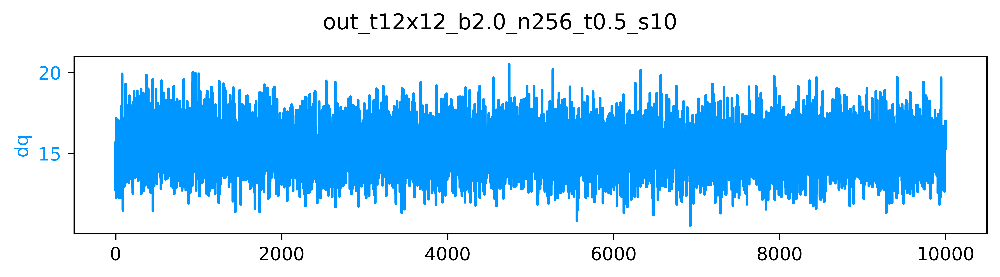

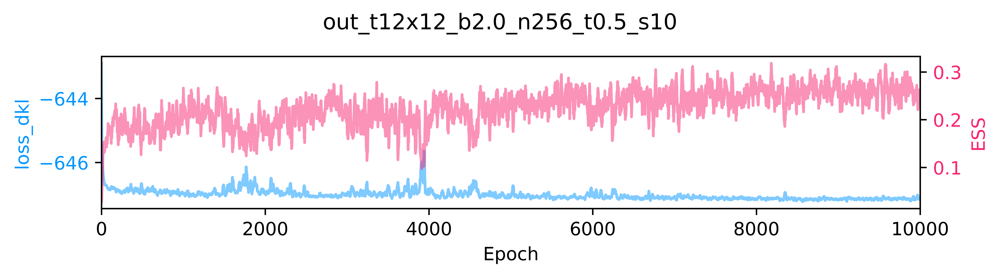

[17:10:51]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[17:11:04]  epoch=97.000 step=0.000 dt=0.127 loss=-646.856 dq=14.6242 ess=0.177524           
            plaq=0.693464 loss_dkl=-646.856 logp=199.718 logq=-447.139

[17:11:18]  epoch=197.000 step=0.000 dt=0.125 loss=-646.862 dq=15.3422 ess=0.23624           
            plaq=0.69252 loss_dkl=-646.862 logp=199.446 logq=-447.416

[17:11:33]  epoch=297.000 step=0.000 dt=0.126 loss=-646.939 dq=15.7219 ess=0.186825          
            plaq=0.689036 loss_dkl=-646.939 logp=198.442 logq=-448.497

[17:11:47]  epoch=397.000 step=0.000 dt=0.126 loss=-647.029 dq=15.1258 ess=0.171255          
            plaq=0.691575 loss_dkl=-647.029 logp=199.174 logq=-447.855

[17:12:02]  epoch=497.000 step=0.000 dt=0.126 loss=-646.672 dq=14.0672 ess=0.145551          
            plaq=0.685751 loss_dkl=-646.672 logp=197.496 logq=-449.176

[17:12:16]  epoch=597.000 step=0.000 dt=0.127 loss=-646.837 dq=16.55 ess=0.121838            
            plaq=0.688182 loss_dkl=-646.837 logp=198.196 logq=-448.641

[17:12:30]  epoch=697.000 step=0.000 dt=0.126 loss=-647.018 dq=15.7625 ess=0.165266          
            plaq=0.687184 loss_dkl=-647.018 logp=197.909 logq=-449.109

[17:12:45]  epoch=797.000 step=0.000 dt=0.126 loss=-646.901 dq=15.2367 ess=0.18746           
            plaq=0.689819 loss_dkl=-646.901 logp=198.668 logq=-448.233

[17:12:59]  epoch=897.000 step=0.000 dt=0.126 loss=-647.027 dq=14.8125 ess=0.2 plaq=0.688745 
            loss_dkl=-647.027 logp=198.358 logq=-448.668

[17:13:14]  epoch=997.000 step=0.000 dt=0.126 loss=-646.906 dq=15.5453 ess=0.155303          
            plaq=0.687729 loss_dkl=-646.906 logp=198.066 logq=-448.84

[17:13:16]  ---------------------------------------                                          
            ERA=1, last took: 2 min 24.4 s                                                   
            ---------------------------------------

[17:13:28]  epoch=97.000 step=97.000 dt=0.126 loss=-646.969 dq=15.3648 ess=0.266596          
            plaq=0.687483 loss_dkl=-646.969 logp=197.995 logq=-448.973

[17:13:43]  epoch=197.000 step=197.000 dt=0.126 loss=-646.942 dq=14.4187 ess=0.185238        
            plaq=0.691749 loss_dkl=-646.942 logp=199.224 logq=-447.718

[17:13:57]  epoch=297.000 step=297.000 dt=0.126 loss=-647.083 dq=16.5039 ess=0.211816        
            plaq=0.691888 loss_dkl=-647.083 logp=199.264 logq=-447.819

[17:14:12]  epoch=397.000 step=397.000 dt=0.127 loss=-646.948 dq=15.8297 ess=0.193754        
            plaq=0.688924 loss_dkl=-646.948 logp=198.41 logq=-448.538

[17:14:27]  epoch=497.000 step=497.000 dt=0.126 loss=-646.612 dq=16.0305 ess=0.145847        
            plaq=0.691034 loss_dkl=-646.612 logp=199.018 logq=-447.594

[17:14:41]  epoch=597.000 step=597.000 dt=0.126 loss=-646.852 dq=15.8461 ess=0.211879        
            plaq=0.692453 loss_dkl=-646.852 logp=199.426 logq=-447.425

[17:14:56]  epoch=697.000 step=697.000 dt=0.127 loss=-646.58 dq=15.2445 ess=0.126755         
            plaq=0.687685 loss_dkl=-646.58 logp=198.053 logq=-448.527

[17:15:10]  epoch=797.000 step=797.000 dt=0.127 loss=-646.86 dq=16.1547 ess=0.152159         
            plaq=0.687034 loss_dkl=-646.86 logp=197.866 logq=-448.995

[17:15:25]  epoch=897.000 step=897.000 dt=0.127 loss=-646.707 dq=16.5648 ess=0.101888        
            plaq=0.688757 loss_dkl=-646.707 logp=198.362 logq=-448.345

[17:15:40]  epoch=997.000 step=997.000 dt=0.129 loss=-646.933 dq=15.6109 ess=0.196349        
            plaq=0.687418 loss_dkl=-646.933 logp=197.977 logq=-448.956

[17:15:42]  ---------------------------------------                                          
            ERA=2, last took: 2 min 26.07 s                                                  
            ---------------------------------------

[17:15:55]  epoch=97.000 step=194.000 dt=0.130 loss=-646.885 dq=15.5219 ess=0.162463         
            plaq=0.690474 loss_dkl=-646.885 logp=198.857 logq=-448.028

[17:16:10]  epoch=197.000 step=394.000 dt=0.131 loss=-646.98 dq=16.2422 ess=0.173546         
            plaq=0.685715 loss_dkl=-646.98 logp=197.486 logq=-449.494

[17:16:25]  epoch=297.000 step=594.000 dt=0.126 loss=-646.961 dq=15.9688 ess=0.219782        
            plaq=0.688138 loss_dkl=-646.961 logp=198.184 logq=-448.777

[17:16:40]  epoch=397.000 step=794.000 dt=0.132 loss=-647.03 dq=16.193 ess=0.211795          
            plaq=0.685561 loss_dkl=-647.03 logp=197.442 logq=-449.589

[17:16:55]  epoch=497.000 step=994.000 dt=0.141 loss=-647.013 dq=14.9617 ess=0.229755        
            plaq=0.689209 loss_dkl=-647.013 logp=198.492 logq=-448.521

[17:17:11]  epoch=597.000 step=1194.000 dt=0.126 loss=-647.049 dq=15.4187 ess=0.185496       
            plaq=0.69137 loss_dkl=-647.049 logp=199.115 logq=-447.935

[17:17:26]  epoch=697.000 step=1394.000 dt=0.128 loss=-647.031 dq=14.0102 ess=0.173825       
            plaq=0.690013 loss_dkl=-647.031 logp=198.724 logq=-448.307

[17:17:40]  epoch=797.000 step=1594.000 dt=0.128 loss=-647.061 dq=15.0898 ess=0.219352       
            plaq=0.688896 loss_dkl=-647.061 logp=198.402 logq=-448.659

[17:17:55]  epoch=897.000 step=1794.000 dt=0.129 loss=-647.128 dq=15.4742 ess=0.226814       
            plaq=0.689284 loss_dkl=-647.128 logp=198.514 logq=-448.614

[17:18:10]  epoch=997.000 step=1994.000 dt=0.128 loss=-647.058 dq=16.4344 ess=0.249416       
            plaq=0.689198 loss_dkl=-647.058 logp=198.489 logq=-448.569

[17:18:12]  ---------------------------------------                                          
            ERA=3, last took: 2 min 30.46 s                                                  
            ---------------------------------------

[17:18:25]  epoch=97.000 step=291.000 dt=0.129 loss=-647.003 dq=15.7508 ess=0.264785         
            plaq=0.686715 loss_dkl=-647.003 logp=197.774 logq=-449.229

[17:18:40]  epoch=197.000 step=591.000 dt=0.128 loss=-646.998 dq=16.0586 ess=0.221443        
            plaq=0.687429 loss_dkl=-646.998 logp=197.98 logq=-449.018

[17:18:55]  epoch=297.000 step=891.000 dt=0.128 loss=-647.048 dq=15.8227 ess=0.238786        
            plaq=0.692521 loss_dkl=-647.048 logp=199.446 logq=-447.602

[17:19:10]  epoch=397.000 step=1191.000 dt=0.129 loss=-646.878 dq=15.9219 ess=0.172722       
            plaq=0.689522 loss_dkl=-646.878 logp=198.582 logq=-448.296

[17:19:25]  epoch=497.000 step=1491.000 dt=0.129 loss=-646.885 dq=15.6422 ess=0.198631       
            plaq=0.690193 loss_dkl=-646.885 logp=198.776 logq=-448.11

[17:19:40]  epoch=597.000 step=1791.000 dt=0.129 loss=-647.035 dq=15.9578 ess=0.228774       
            plaq=0.689279 loss_dkl=-647.035 logp=198.512 logq=-448.522

[17:19:55]  epoch=697.000 step=2091.000 dt=0.129 loss=-647.106 dq=15.1156 ess=0.226101       
            plaq=0.686467 loss_dkl=-647.106 logp=197.702 logq=-449.404

[17:20:10]  epoch=797.000 step=2391.000 dt=0.129 loss=-646.81 dq=15.8461 ess=0.167077        
            plaq=0.690862 loss_dkl=-646.81 logp=198.968 logq=-447.841

[17:20:25]  epoch=897.000 step=2691.000 dt=0.130 loss=-646.75 dq=15.8344 ess=0.143895        
            plaq=0.690473 loss_dkl=-646.75 logp=198.856 logq=-447.894

[17:20:40]  epoch=997.000 step=2991.000 dt=0.129 loss=-646.916 dq=15.2688 ess=0.141949       
            plaq=0.688218 loss_dkl=-646.916 logp=198.207 logq=-448.709

[17:20:42]  ---------------------------------------                                          
            ERA=4, last took: 2 min 29.65 s                                                  
            ---------------------------------------

[17:20:55]  epoch=97.000 step=388.000 dt=0.129 loss=-647.066 dq=15.2258 ess=0.244283         
            plaq=0.693583 loss_dkl=-647.066 logp=199.752 logq=-447.314

[17:21:10]  epoch=197.000 step=788.000 dt=0.129 loss=-647.099 dq=15.2305 ess=0.183414        
            plaq=0.687758 loss_dkl=-647.099 logp=198.074 logq=-449.025

[17:21:25]  epoch=297.000 step=1188.000 dt=0.129 loss=-647.019 dq=15.1219 ess=0.211485       
            plaq=0.689591 loss_dkl=-647.019 logp=198.602 logq=-448.417

[17:21:40]  epoch=397.000 step=1588.000 dt=0.129 loss=-646.829 dq=14.4555 ess=0.170231       
            plaq=0.687629 loss_dkl=-646.829 logp=198.037 logq=-448.792

[17:21:55]  epoch=497.000 step=1988.000 dt=0.129 loss=-646.842 dq=15.5758 ess=0.151192       
            plaq=0.690413 loss_dkl=-646.842 logp=198.839 logq=-448.003

[17:22:10]  epoch=597.000 step=2388.000 dt=0.129 loss=-646.893 dq=14.5422 ess=0.158195       
            plaq=0.690726 loss_dkl=-646.893 logp=198.929 logq=-447.964

[17:22:25]  epoch=697.000 step=2788.000 dt=0.129 loss=-646.879 dq=16.3172 ess=0.203067       
            plaq=0.689172 loss_dkl=-646.879 logp=198.482 logq=-448.398

[17:22:40]  epoch=797.000 step=3188.000 dt=0.129 loss=-646.994 dq=15.1398 ess=0.219144       
            plaq=0.69026 loss_dkl=-646.994 logp=198.795 logq=-448.199

[17:22:55]  epoch=897.000 step=3588.000 dt=0.129 loss=-647.019 dq=14.3719 ess=0.276529       
            plaq=0.686933 loss_dkl=-647.019 logp=197.837 logq=-449.182

[17:23:10]  epoch=997.000 step=3988.000 dt=0.129 loss=-647.06 dq=15.3023 ess=0.220107        
            plaq=0.687431 loss_dkl=-647.06 logp=197.98 logq=-449.08

[17:23:12]  ---------------------------------------                                          
            ERA=5, last took: 2 min 30.33 s                                                  
            ---------------------------------------

[17:23:25]  epoch=97.000 step=485.000 dt=0.129 loss=-647.123 dq=14.7922 ess=0.272277         
            plaq=0.689997 loss_dkl=-647.123 logp=198.719 logq=-448.404

[17:23:40]  epoch=197.000 step=985.000 dt=0.129 loss=-647.102 dq=15.4617 ess=0.215788        
            plaq=0.688359 loss_dkl=-647.102 logp=198.247 logq=-448.854

[17:23:55]  epoch=297.000 step=1485.000 dt=0.129 loss=-647.123 dq=14.4641 ess=0.228809       
            plaq=0.690881 loss_dkl=-647.123 logp=198.974 logq=-448.149

[17:24:11]  epoch=397.000 step=1985.000 dt=0.129 loss=-647.055 dq=14.8727 ess=0.238267       
            plaq=0.689825 loss_dkl=-647.055 logp=198.67 logq=-448.386

[17:24:26]  epoch=497.000 step=2485.000 dt=0.129 loss=-647.075 dq=14.4359 ess=0.237543       
            plaq=0.690308 loss_dkl=-647.075 logp=198.809 logq=-448.266

[17:24:41]  epoch=597.000 step=2985.000 dt=0.129 loss=-647.069 dq=15.5555 ess=0.222061       
            plaq=0.687373 loss_dkl=-647.069 logp=197.964 logq=-449.105

[17:24:56]  epoch=697.000 step=3485.000 dt=0.129 loss=-647.138 dq=15.4539 ess=0.209661       
            plaq=0.689394 loss_dkl=-647.138 logp=198.546 logq=-448.592

[17:25:11]  epoch=797.000 step=3985.000 dt=0.130 loss=-647.138 dq=16.0797 ess=0.221345       
            plaq=0.690751 loss_dkl=-647.138 logp=198.936 logq=-448.202

[17:25:26]  epoch=897.000 step=4485.000 dt=0.129 loss=-647.134 dq=15.3562 ess=0.20305        
            plaq=0.689889 loss_dkl=-647.134 logp=198.688 logq=-448.446

[17:25:41]  epoch=997.000 step=4985.000 dt=0.130 loss=-647.062 dq=15.1734 ess=0.248323       
            plaq=0.688696 loss_dkl=-647.062 logp=198.344 logq=-448.718

[17:25:43]  ---------------------------------------                                          
            ERA=6, last took: 2 min 31.33 s                                                  
            ---------------------------------------

[17:25:57]  epoch=97.000 step=582.000 dt=0.129 loss=-647.034 dq=14.5445 ess=0.19015          
            plaq=0.690804 loss_dkl=-647.034 logp=198.951 logq=-448.083

[17:26:12]  epoch=197.000 step=1182.000 dt=0.129 loss=-647.154 dq=15.9891 ess=0.232255       
            plaq=0.691318 loss_dkl=-647.154 logp=199.1 logq=-448.054

[17:26:27]  epoch=297.000 step=1782.000 dt=0.129 loss=-647.039 dq=15.1391 ess=0.261697       
            plaq=0.690907 loss_dkl=-647.039 logp=198.981 logq=-448.058

[17:26:42]  epoch=397.000 step=2382.000 dt=0.129 loss=-647.087 dq=14.7016 ess=0.209292       
            plaq=0.693525 loss_dkl=-647.087 logp=199.735 logq=-447.352

[17:26:57]  epoch=497.000 step=2982.000 dt=0.129 loss=-647.175 dq=15.3492 ess=0.321126       
            plaq=0.689852 loss_dkl=-647.175 logp=198.677 logq=-448.498

[17:27:13]  epoch=597.000 step=3582.000 dt=0.129 loss=-647.169 dq=14.3953 ess=0.221717       
            plaq=0.692936 loss_dkl=-647.169 logp=199.566 logq=-447.604

[17:27:28]  epoch=697.000 step=4182.000 dt=0.129 loss=-646.833 dq=15.4047 ess=0.192454       
            plaq=0.687158 loss_dkl=-646.833 logp=197.902 logq=-448.931

[17:27:43]  epoch=797.000 step=4782.000 dt=0.130 loss=-647.044 dq=15.0484 ess=0.221552       
            plaq=0.691548 loss_dkl=-647.044 logp=199.166 logq=-447.879

[17:27:58]  epoch=897.000 step=5382.000 dt=0.129 loss=-647.024 dq=15.6797 ess=0.226221       
            plaq=0.691931 loss_dkl=-647.024 logp=199.276 logq=-447.748

[17:28:14]  epoch=997.000 step=5982.000 dt=0.129 loss=-647.107 dq=14.4102 ess=0.18641        
            plaq=0.69046 loss_dkl=-647.107 logp=198.853 logq=-448.254

[17:28:16]  ---------------------------------------                                          
            ERA=7, last took: 2 min 32.42 s                                                  
            ---------------------------------------

[17:28:29]  epoch=97.000 step=679.000 dt=0.129 loss=-647.084 dq=14.3102 ess=0.300345         
            plaq=0.688832 loss_dkl=-647.084 logp=198.383 logq=-448.701

[17:28:44]  epoch=197.000 step=1379.000 dt=0.129 loss=-647.106 dq=15.1617 ess=0.230322       
            plaq=0.691322 loss_dkl=-647.106 logp=199.101 logq=-448.005

[17:28:59]  epoch=297.000 step=2079.000 dt=0.129 loss=-647.106 dq=14.0688 ess=0.321132       
            plaq=0.687433 loss_dkl=-647.106 logp=197.981 logq=-449.125

[17:29:15]  epoch=397.000 step=2779.000 dt=0.129 loss=-647.064 dq=14.8961 ess=0.174934       
            plaq=0.690232 loss_dkl=-647.064 logp=198.787 logq=-448.277

[17:29:30]  epoch=497.000 step=3479.000 dt=0.129 loss=-647.071 dq=14.4789 ess=0.271539       
            plaq=0.690263 loss_dkl=-647.071 logp=198.796 logq=-448.275

[17:29:45]  epoch=597.000 step=4179.000 dt=0.129 loss=-647.127 dq=14.1805 ess=0.253522       
            plaq=0.691582 loss_dkl=-647.127 logp=199.176 logq=-447.951

[17:30:00]  epoch=697.000 step=4879.000 dt=0.129 loss=-647.183 dq=15.5211 ess=0.238254       
            plaq=0.691488 loss_dkl=-647.183 logp=199.149 logq=-448.035

[17:30:16]  epoch=797.000 step=5579.000 dt=0.131 loss=-647.139 dq=15.8078 ess=0.215654       
            plaq=0.690363 loss_dkl=-647.139 logp=198.825 logq=-448.315

[17:30:31]  epoch=897.000 step=6279.000 dt=0.129 loss=-647.208 dq=16.4336 ess=0.282281       
            plaq=0.689762 loss_dkl=-647.208 logp=198.651 logq=-448.557

[17:30:47]  epoch=997.000 step=6979.000 dt=0.130 loss=-647.165 dq=15.5531 ess=0.277779       
            plaq=0.691444 loss_dkl=-647.165 logp=199.136 logq=-448.029

[17:30:49]  ---------------------------------------                                          
            ERA=8, last took: 2 min 32.93 s                                                  
            ---------------------------------------

[17:31:02]  epoch=97.000 step=776.000 dt=0.130 loss=-647.13 dq=15.4898 ess=0.262889          
            plaq=0.689305 loss_dkl=-647.13 logp=198.52 logq=-448.61

[17:31:17]  epoch=197.000 step=1576.000 dt=0.130 loss=-647.197 dq=15.625 ess=0.272326        
            plaq=0.691609 loss_dkl=-647.197 logp=199.183 logq=-448.013

[17:31:33]  epoch=297.000 step=2376.000 dt=0.130 loss=-647.221 dq=15.257 ess=0.271453        
            plaq=0.692261 loss_dkl=-647.221 logp=199.371 logq=-447.85

[17:31:48]  epoch=397.000 step=3176.000 dt=0.130 loss=-647.081 dq=15.7555 ess=0.268958       
            plaq=0.68969 loss_dkl=-647.081 logp=198.631 logq=-448.45

[17:32:03]  epoch=497.000 step=3976.000 dt=0.130 loss=-647.24 dq=15.5938 ess=0.230536        
            plaq=0.688177 loss_dkl=-647.24 logp=198.195 logq=-449.045

[17:32:19]  epoch=597.000 step=4776.000 dt=0.130 loss=-647.237 dq=15.4453 ess=0.240336       
            plaq=0.690234 loss_dkl=-647.237 logp=198.787 logq=-448.45

[17:32:34]  epoch=697.000 step=5576.000 dt=0.129 loss=-647.19 dq=14.9594 ess=0.264184        
            plaq=0.690319 loss_dkl=-647.19 logp=198.812 logq=-448.378

[17:32:50]  epoch=797.000 step=6376.000 dt=0.129 loss=-647.133 dq=16.5336 ess=0.263802       
            plaq=0.688824 loss_dkl=-647.133 logp=198.381 logq=-448.752

[17:33:05]  epoch=897.000 step=7176.000 dt=0.130 loss=-647.167 dq=16.4609 ess=0.285695       
            plaq=0.688381 loss_dkl=-647.167 logp=198.254 logq=-448.914

[17:33:20]  epoch=997.000 step=7976.000 dt=0.129 loss=-647.183 dq=15.7406 ess=0.221347       
            plaq=0.686549 loss_dkl=-647.183 logp=197.726 logq=-449.457

[17:33:22]  ---------------------------------------                                          
            ERA=9, last took: 2 min 33.62 s                                                  
            ---------------------------------------

[17:33:36]  epoch=97.000 step=873.000 dt=0.129 loss=-647.142 dq=14.8406 ess=0.249635         
            plaq=0.688865 loss_dkl=-647.142 logp=198.393 logq=-448.749

[17:33:51]  epoch=197.000 step=1773.000 dt=0.130 loss=-647.171 dq=15.7289 ess=0.253315       
            plaq=0.689446 loss_dkl=-647.171 logp=198.56 logq=-448.611

[17:34:07]  epoch=297.000 step=2673.000 dt=0.128 loss=-647.151 dq=14.1359 ess=0.266261       
            plaq=0.689532 loss_dkl=-647.151 logp=198.585 logq=-448.566

[17:34:22]  epoch=397.000 step=3573.000 dt=0.129 loss=-647.14 dq=15.5312 ess=0.295896        
            plaq=0.691815 loss_dkl=-647.14 logp=199.243 logq=-447.898

[17:34:37]  epoch=497.000 step=4473.000 dt=0.130 loss=-647.187 dq=14.1023 ess=0.261449       
            plaq=0.691822 loss_dkl=-647.187 logp=199.245 logq=-447.942

[17:34:53]  epoch=597.000 step=5373.000 dt=0.129 loss=-647.164 dq=15.6187 ess=0.241817       
            plaq=0.68951 loss_dkl=-647.164 logp=198.579 logq=-448.585

[17:35:08]  epoch=697.000 step=6273.000 dt=0.128 loss=-647.14 dq=15.6641 ess=0.232491        
            plaq=0.689461 loss_dkl=-647.14 logp=198.565 logq=-448.575

[17:35:24]  epoch=797.000 step=7173.000 dt=0.129 loss=-647.1 dq=14.8344 ess=0.256675         
            plaq=0.688636 loss_dkl=-647.1 logp=198.327 logq=-448.773

[17:35:39]  epoch=897.000 step=8073.000 dt=0.129 loss=-647.156 dq=14.5352 ess=0.232425       
            plaq=0.691136 loss_dkl=-647.156 logp=199.047 logq=-448.109

[17:35:55]  epoch=997.000 step=8973.000 dt=0.129 loss=-647.181 dq=15.7672 ess=0.305718       
            plaq=0.689249 loss_dkl=-647.181 logp=198.504 logq=-448.677

[17:35:57]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/models/pre_flow_model/2021-05-25-1710

[17:35:57]  Saving checkpoint to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0
            _n256_t0.5_s10/models/pre_flow_model/2021-05-25-1710/pre_flow_model.tar

[17:35:58]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1710

[17:35:58]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1710/dq_training.pdf

[17:35:59]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1710/loss_dkl_ess_training.pd
            f

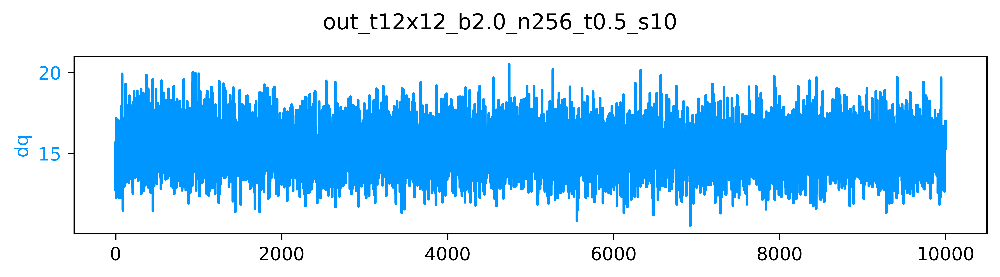

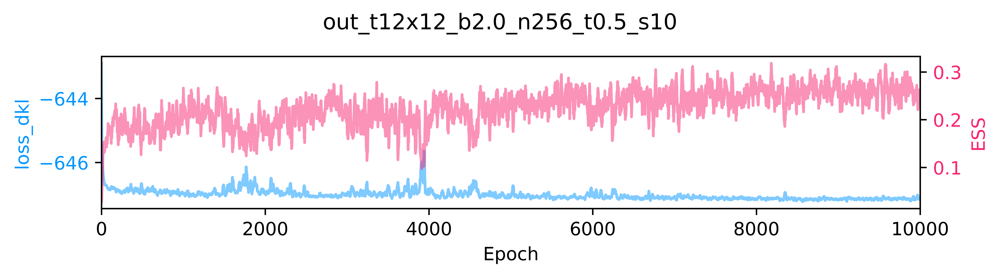

In [20]:
train_outputs12 = train(param12,
                        train_config12,
                        model=model12,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots12 = train_outputs12['plots']
pre_flow_history12 = train_outputs12['history']
flow_act12 = train_outputs12['action']

pre_flow_model12 = train_outputs12['model']
pre_flow_optimizer12 = train_outputs12['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step12 = train_config12.n_era * train_config12.n_epoch

outfile12 = os.path.join(MODEL_DIR12, 'pre_flow_model', TSTAMP12, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step12,
    outfile=outfile12,
    model=pre_flow_model12['layers'],
    optimizer=pre_flow_optimizer12,
    history=train_outputs12['history'],
    overwrite=True,
)

plots12 = train_outputs12['plots']
outdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)

save_live_plots(plots12, outdir12)

[17:39:33]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933

[17:39:33]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-1710

[17:39:33]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/step.pdf

[17:39:34]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/dt.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/loss.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/q.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/dq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/plaq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/loss_dkl.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/logp.pdf

[17:39:35]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-173933/logq.pdf

[17:39:35]  Saving train_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2
            .0_n256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-1710/train_metrics.z.

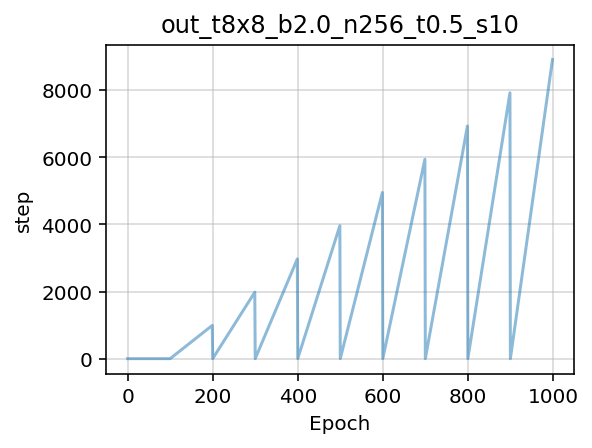

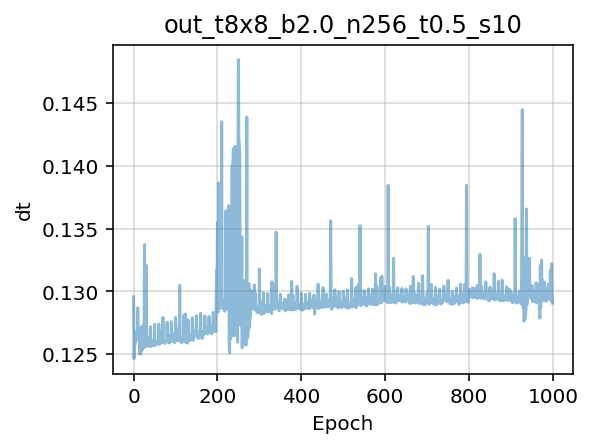

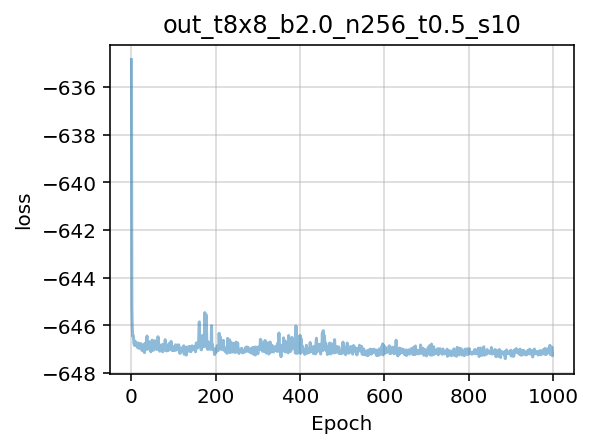

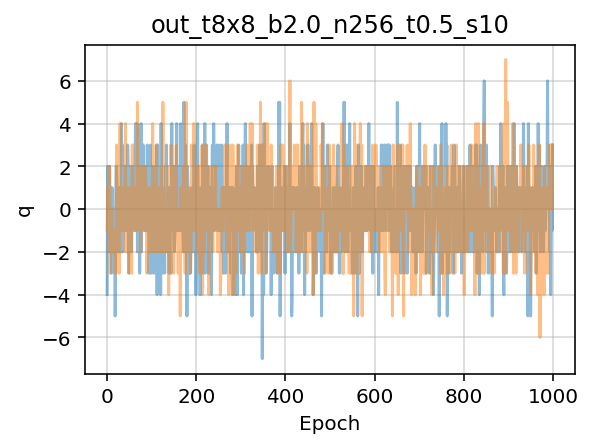

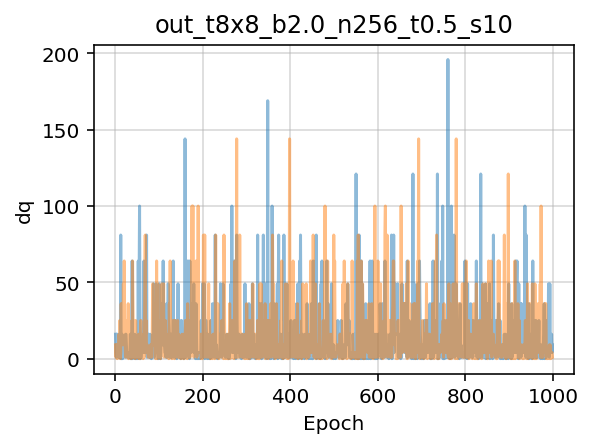

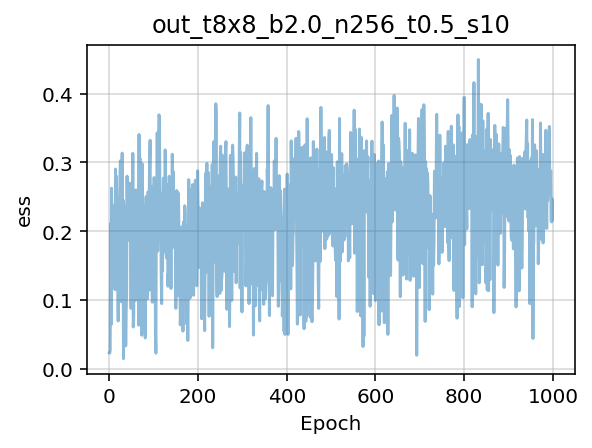

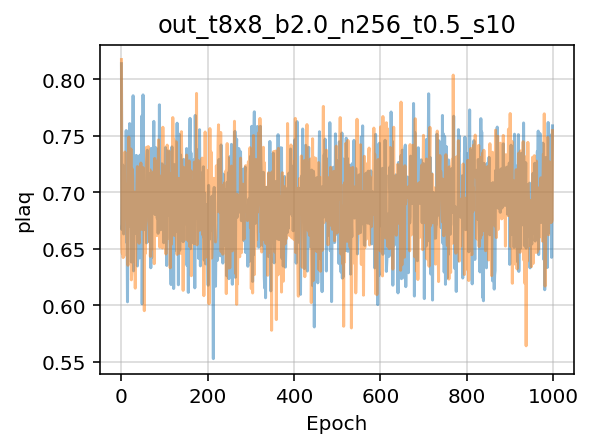

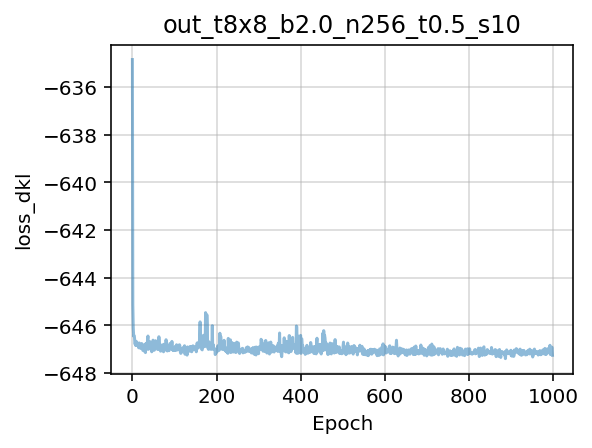

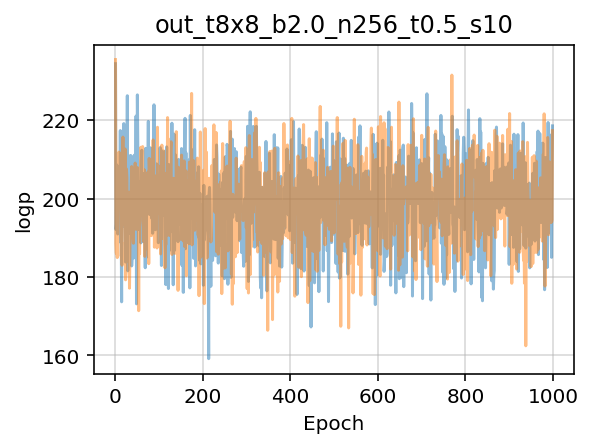

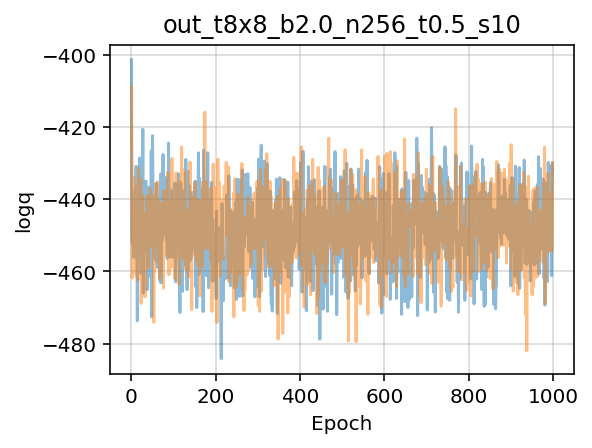

In [21]:
from fthmc.utils.plot_helpers import plot_history

tstamp12 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir12):
    pdir12 = os.path.join(PLOTS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir12):
    mdir12 = os.path.join(METRICS_DIR12, 'training', 'pre_flow_model', tstamp12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=train_outputs12['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir12, alpha=0.5)

mfile12 = os.path.join(mdir12, 'train_metrics.z')
io.save_history(train_outputs12['history'], mfile12, name='train_metrics')

[17:41:39]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933

[17:41:39]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n
            256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-1710

[17:41:39]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/q.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/dqsq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/dkl.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/logq.pdf

[17:41:40]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/logp.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x12_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-173933/accepted.pdf

[17:41:40]  Saving inference_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t12x1
            2_b2.0_n256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-1710/inference_m
            etrics.z.

[17:41:40]  Accept rate: 0.4657

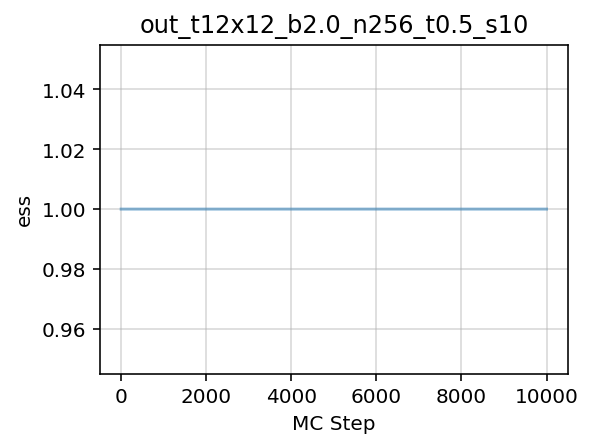

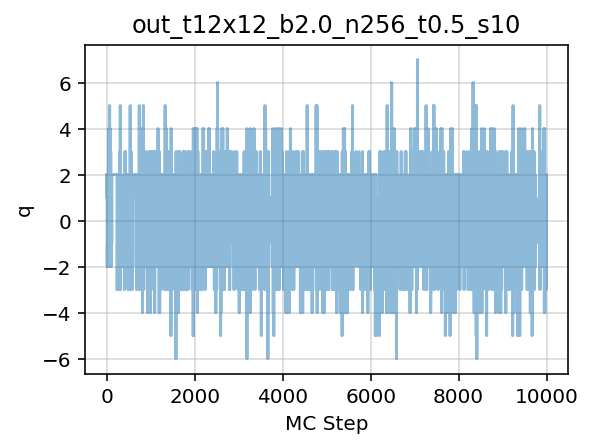

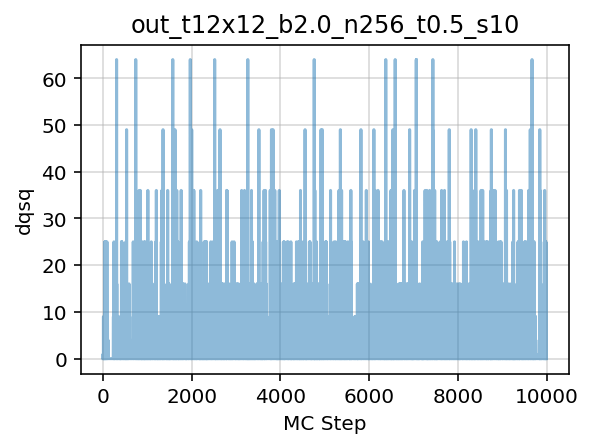

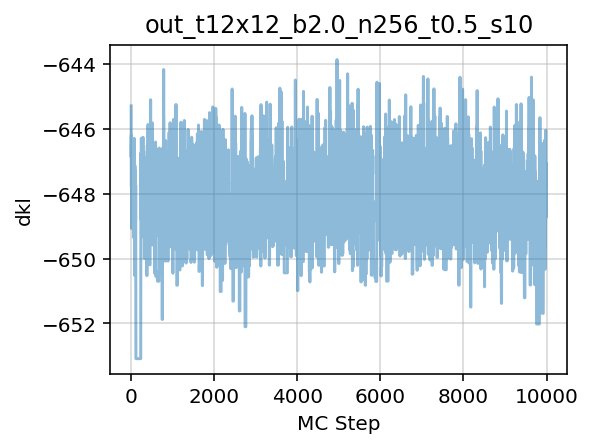

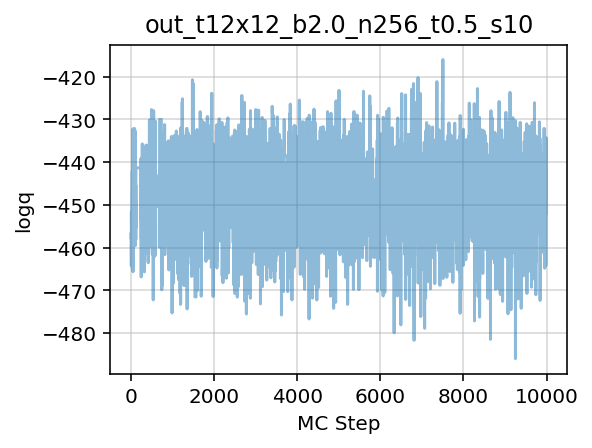

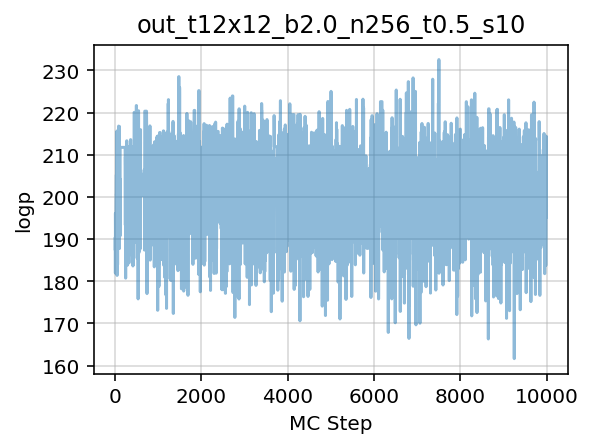

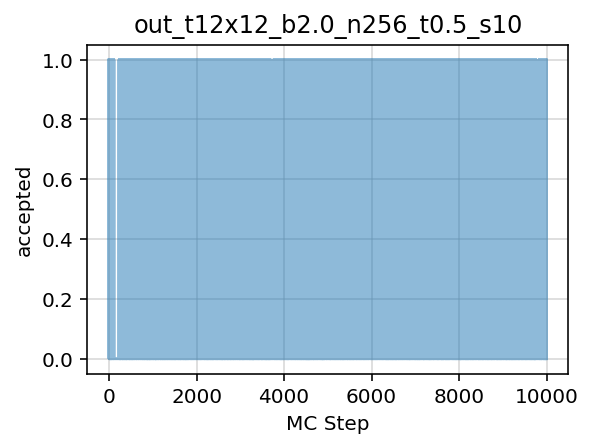

In [22]:
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed


history12 = make_mcmc_ensemble(model=train_outputs12['model'],
                               action_fn=train_outputs12['action'],
                               batch_size=train_config12.batch_size,
                               num_samples=10000)

pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(pdir):
    pdir12 = os.path.join(PLOTS_DIR12, 'inference', 'pre_flow_model', tstamp12)
    
mdir12 = os.path.join(PLOTS_DIR12,'inference', 'pre_flow_model', TSTAMP12)
if os.path.isdir(mdir):
    mdir12 = os.path.join(METRICS_DIR12, 'inference', 'pre_flow_model', TSTAMP12)
    
io.check_else_make_dir(pdir12)
io.check_else_make_dir(mdir12)

plot_history(history=history12,
             param=param12,
             outdir=pdir12,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile12 = os.path.join(mdir12, 'inference_metrics.z')

io.save_history(history12, mfile12, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

[17:51:31]  Param:                                                                           
            ----------------                                                                 
            beta=2.0                                                                         
            L=16                                                                             
            tau=0.5                                                                          
            nstep=10                                                                         
            ntraj=256                                                                        
            nrun=5                                                                           
            nprint=50                                                                        
            seed=1331                                                                        
            randinit=True                                                                    
            nth=2                                                                            
            nth_interop=2                                                                    
            lat=[16, 16]                                                                     
            nd=2                                                                             
            shape=[2, 16, 16]                                                                
            volume=256                                                                       
            dt=0.05

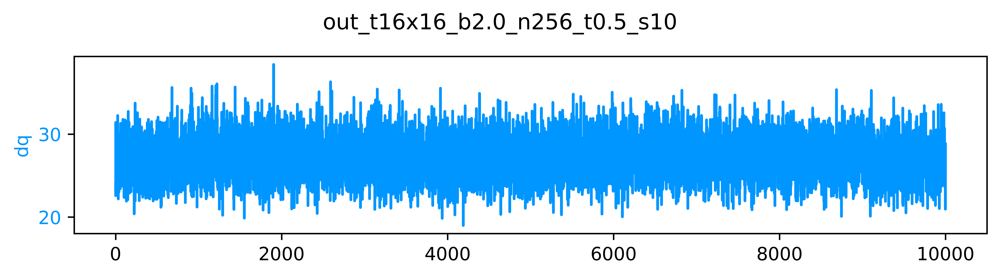

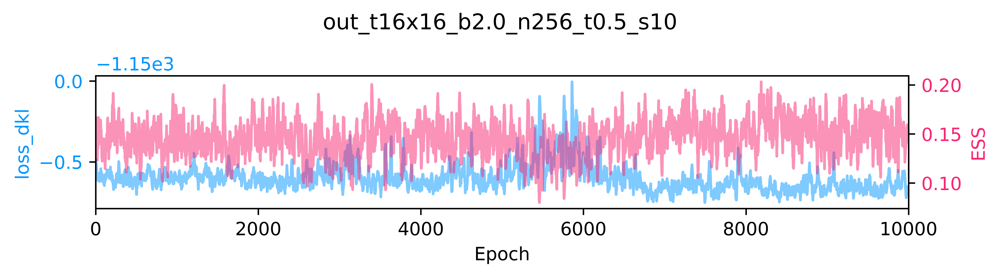

[17:51:32]  ---------------------------------------                                          
            ERA=0, last took: 0 min 0 s                                                      
            ---------------------------------------

[17:51:45]  epoch=97.000 step=0.000 dt=0.127 loss=-1150.55 dq=27.4633 ess=0.180048           
            plaq=0.689774 loss_dkl=-1150.55 logp=353.164 logq=-797.387

[17:52:00]  epoch=197.000 step=0.000 dt=0.127 loss=-1150.65 dq=27.4391 ess=0.158934          
            plaq=0.690105 loss_dkl=-1150.65 logp=353.334 logq=-797.317

[17:52:14]  epoch=297.000 step=0.000 dt=0.128 loss=-1150.49 dq=26.1477 ess=0.173976          
            plaq=0.69007 loss_dkl=-1150.49 logp=353.316 logq=-797.173

[17:52:29]  epoch=397.000 step=0.000 dt=0.128 loss=-1150.67 dq=29.6961 ess=0.125512          
            plaq=0.692857 loss_dkl=-1150.67 logp=354.743 logq=-795.925

[17:52:44]  epoch=497.000 step=0.000 dt=0.129 loss=-1150.66 dq=26.9992 ess=0.15688           
            plaq=0.688015 loss_dkl=-1150.66 logp=352.264 logq=-798.398

[17:52:59]  epoch=597.000 step=0.000 dt=0.127 loss=-1150.59 dq=26.6617 ess=0.154189          
            plaq=0.692828 loss_dkl=-1150.59 logp=354.728 logq=-795.858

[17:53:14]  epoch=697.000 step=0.000 dt=0.130 loss=-1150.57 dq=27.1492 ess=0.127505          
            plaq=0.690029 loss_dkl=-1150.57 logp=353.295 logq=-797.272

[17:53:28]  epoch=797.000 step=0.000 dt=0.129 loss=-1150.59 dq=28.8922 ess=0.159865          
            plaq=0.690585 loss_dkl=-1150.59 logp=353.58 logq=-797.008

[17:53:43]  epoch=897.000 step=0.000 dt=0.129 loss=-1150.58 dq=27.7117 ess=0.113621          
            plaq=0.690528 loss_dkl=-1150.58 logp=353.551 logq=-797.031

[17:53:58]  epoch=997.000 step=0.000 dt=0.129 loss=-1150.63 dq=28.4008 ess=0.186268          
            plaq=0.689789 loss_dkl=-1150.63 logp=353.172 logq=-797.457

[17:54:00]  ---------------------------------------                                          
            ERA=1, last took: 2 min 27.28 s                                                  
            ---------------------------------------

[17:54:13]  epoch=97.000 step=97.000 dt=0.130 loss=-1150.6 dq=25.8445 ess=0.0881768          
            plaq=0.689541 loss_dkl=-1150.6 logp=353.045 logq=-797.554

[17:54:27]  epoch=197.000 step=197.000 dt=0.129 loss=-1150.61 dq=27.575 ess=0.187832         
            plaq=0.69056 loss_dkl=-1150.61 logp=353.566 logq=-797.042

[17:54:42]  epoch=297.000 step=297.000 dt=0.132 loss=-1150.64 dq=26.9414 ess=0.107503        
            plaq=0.691495 loss_dkl=-1150.64 logp=354.045 logq=-796.598

[17:54:57]  epoch=397.000 step=397.000 dt=0.127 loss=-1150.51 dq=28.5641 ess=0.139306        
            plaq=0.690629 loss_dkl=-1150.51 logp=353.602 logq=-796.906

[17:55:12]  epoch=497.000 step=497.000 dt=0.129 loss=-1150.66 dq=26.4383 ess=0.154123        
            plaq=0.693243 loss_dkl=-1150.66 logp=354.94 logq=-795.722

[17:55:27]  epoch=597.000 step=597.000 dt=0.129 loss=-1150.61 dq=27.1086 ess=0.152907        
            plaq=0.690363 loss_dkl=-1150.61 logp=353.466 logq=-797.141

[17:55:43]  epoch=697.000 step=697.000 dt=0.132 loss=-1150.58 dq=28.2008 ess=0.094952        
            plaq=0.689853 loss_dkl=-1150.58 logp=353.205 logq=-797.38

[17:55:58]  epoch=797.000 step=797.000 dt=0.132 loss=-1150.61 dq=27.393 ess=0.150261         
            plaq=0.689773 loss_dkl=-1150.61 logp=353.164 logq=-797.442

[17:56:14]  epoch=897.000 step=897.000 dt=0.129 loss=-1150.58 dq=25.825 ess=0.126556         
            plaq=0.690798 loss_dkl=-1150.58 logp=353.689 logq=-796.891

[17:56:29]  epoch=997.000 step=997.000 dt=0.131 loss=-1150.56 dq=28.1508 ess=0.117545        
            plaq=0.691568 loss_dkl=-1150.56 logp=354.083 logq=-796.478

[17:56:30]  ---------------------------------------                                          
            ERA=2, last took: 2 min 30.83 s                                                  
            ---------------------------------------

[17:56:44]  epoch=97.000 step=194.000 dt=0.131 loss=-1150.64 dq=27.7555 ess=0.159688         
            plaq=0.689945 loss_dkl=-1150.64 logp=353.252 logq=-797.385

[17:56:59]  epoch=197.000 step=394.000 dt=0.129 loss=-1150.6 dq=26.9992 ess=0.130891         
            plaq=0.68924 loss_dkl=-1150.6 logp=352.891 logq=-797.71

[17:57:13]  epoch=297.000 step=594.000 dt=0.135 loss=-1150.59 dq=28.0227 ess=0.134483        
            plaq=0.689891 loss_dkl=-1150.59 logp=353.224 logq=-797.368

[17:57:29]  epoch=397.000 step=794.000 dt=0.128 loss=-1150.61 dq=26.5281 ess=0.122541        
            plaq=0.690422 loss_dkl=-1150.61 logp=353.496 logq=-797.117

[17:57:44]  epoch=497.000 step=994.000 dt=0.130 loss=-1150.51 dq=27.1078 ess=0.171338        
            plaq=0.692561 loss_dkl=-1150.51 logp=354.591 logq=-795.92

[17:57:59]  epoch=597.000 step=1194.000 dt=0.129 loss=-1150.49 dq=29.4273 ess=0.120723       
            plaq=0.689692 loss_dkl=-1150.49 logp=353.122 logq=-797.367

[17:58:14]  epoch=697.000 step=1394.000 dt=0.129 loss=-1150.54 dq=28.2203 ess=0.160441       
            plaq=0.688878 loss_dkl=-1150.54 logp=352.706 logq=-797.831

[17:58:29]  epoch=797.000 step=1594.000 dt=0.130 loss=-1150.64 dq=28.7492 ess=0.167432       
            plaq=0.689736 loss_dkl=-1150.64 logp=353.145 logq=-797.49

[17:58:44]  epoch=897.000 step=1794.000 dt=0.130 loss=-1150.64 dq=26.7875 ess=0.119258       
            plaq=0.689167 loss_dkl=-1150.64 logp=352.854 logq=-797.789

[17:58:59]  epoch=997.000 step=1994.000 dt=0.129 loss=-1150.58 dq=26.4477 ess=0.136848       
            plaq=0.690209 loss_dkl=-1150.58 logp=353.387 logq=-797.194

[17:59:01]  ---------------------------------------                                          
            ERA=3, last took: 2 min 30.79 s                                                  
            ---------------------------------------

[17:59:14]  epoch=97.000 step=291.000 dt=0.131 loss=-1150.57 dq=28.8687 ess=0.139544         
            plaq=0.692169 loss_dkl=-1150.57 logp=354.391 logq=-796.177

[17:59:29]  epoch=197.000 step=591.000 dt=0.129 loss=-1150.52 dq=27.0148 ess=0.118874        
            plaq=0.691244 loss_dkl=-1150.52 logp=353.917 logq=-796.599

[17:59:44]  epoch=297.000 step=891.000 dt=0.130 loss=-1150.68 dq=27.8305 ess=0.162685        
            plaq=0.68954 loss_dkl=-1150.68 logp=353.044 logq=-797.638

[17:59:59]  epoch=397.000 step=1191.000 dt=0.130 loss=-1150.72 dq=26.8 ess=0.18103           
            plaq=0.691253 loss_dkl=-1150.72 logp=353.921 logq=-796.796

[18:00:14]  epoch=497.000 step=1491.000 dt=0.130 loss=-1150.61 dq=29.4328 ess=0.2015         
            plaq=0.688958 loss_dkl=-1150.61 logp=352.746 logq=-797.862

[18:00:29]  epoch=597.000 step=1791.000 dt=0.129 loss=-1150.65 dq=26.9891 ess=0.127397       
            plaq=0.689993 loss_dkl=-1150.65 logp=353.276 logq=-797.374

[18:00:44]  epoch=697.000 step=2091.000 dt=0.130 loss=-1150.58 dq=24.168 ess=0.164358        
            plaq=0.688508 loss_dkl=-1150.58 logp=352.516 logq=-798.064

[18:01:00]  epoch=797.000 step=2391.000 dt=0.129 loss=-1150.26 dq=27.1609 ess=0.0731977      
            plaq=0.692515 loss_dkl=-1150.26 logp=354.568 logq=-795.693

[18:01:15]  epoch=897.000 step=2691.000 dt=0.129 loss=-1150.44 dq=27.632 ess=0.0895663       
            plaq=0.690781 loss_dkl=-1150.44 logp=353.68 logq=-796.765

[18:01:30]  epoch=997.000 step=2991.000 dt=0.130 loss=-1150.67 dq=28.0711 ess=0.143671       
            plaq=0.689383 loss_dkl=-1150.67 logp=352.964 logq=-797.708

[18:01:32]  ---------------------------------------                                          
            ERA=4, last took: 2 min 30.29 s                                                  
            ---------------------------------------

[18:01:45]  epoch=97.000 step=388.000 dt=0.130 loss=-1150.68 dq=28.2719 ess=0.100344         
            plaq=0.693057 loss_dkl=-1150.68 logp=354.845 logq=-795.836

[18:02:00]  epoch=197.000 step=788.000 dt=0.129 loss=-1150.59 dq=26.6141 ess=0.149268        
            plaq=0.689752 loss_dkl=-1150.59 logp=353.153 logq=-797.436

[18:02:15]  epoch=297.000 step=1188.000 dt=0.129 loss=-1150.63 dq=26.2727 ess=0.148041       
            plaq=0.690471 loss_dkl=-1150.63 logp=353.521 logq=-797.11

[18:02:30]  epoch=397.000 step=1588.000 dt=0.130 loss=-1150.67 dq=25.3805 ess=0.101966       
            plaq=0.690815 loss_dkl=-1150.67 logp=353.697 logq=-796.977

[18:02:45]  epoch=497.000 step=1988.000 dt=0.129 loss=-1150.68 dq=26.1422 ess=0.140645       
            plaq=0.6912 loss_dkl=-1150.68 logp=353.895 logq=-796.781

[18:03:00]  epoch=597.000 step=2388.000 dt=0.130 loss=-1150.58 dq=26.4164 ess=0.165651       
            plaq=0.691306 loss_dkl=-1150.58 logp=353.949 logq=-796.627

[18:03:15]  epoch=697.000 step=2788.000 dt=0.131 loss=-1150.58 dq=26.05 ess=0.116822         
            plaq=0.690539 loss_dkl=-1150.58 logp=353.556 logq=-797.02

[18:03:30]  epoch=797.000 step=3188.000 dt=0.129 loss=-1150.7 dq=26.2086 ess=0.196969        
            plaq=0.690039 loss_dkl=-1150.7 logp=353.3 logq=-797.396

[18:03:45]  epoch=897.000 step=3588.000 dt=0.130 loss=-1150.68 dq=26.4266 ess=0.159391       
            plaq=0.690762 loss_dkl=-1150.68 logp=353.67 logq=-797.012

[18:04:00]  epoch=997.000 step=3988.000 dt=0.130 loss=-1150.65 dq=27.6586 ess=0.133013       
            plaq=0.690844 loss_dkl=-1150.65 logp=353.712 logq=-796.936

[18:04:02]  ---------------------------------------                                          
            ERA=5, last took: 2 min 30.95 s                                                  
            ---------------------------------------

[18:04:16]  epoch=97.000 step=485.000 dt=0.130 loss=-1150.36 dq=26.5422 ess=0.139412         
            plaq=0.687821 loss_dkl=-1150.36 logp=352.164 logq=-798.2

[18:04:31]  epoch=197.000 step=985.000 dt=0.130 loss=-1150.53 dq=26.7445 ess=0.126965        
            plaq=0.689949 loss_dkl=-1150.53 logp=353.254 logq=-797.276

[18:04:46]  epoch=297.000 step=1485.000 dt=0.130 loss=-1150.65 dq=27.4758 ess=0.120131       
            plaq=0.689891 loss_dkl=-1150.65 logp=353.224 logq=-797.423

[18:05:01]  epoch=397.000 step=1985.000 dt=0.131 loss=-1150.46 dq=27.2297 ess=0.110033       
            plaq=0.689335 loss_dkl=-1150.46 logp=352.94 logq=-797.524

[18:05:16]  epoch=497.000 step=2485.000 dt=0.130 loss=-1150.19 dq=29.4383 ess=0.142582       
            plaq=0.689699 loss_dkl=-1150.19 logp=353.126 logq=-797.063

[18:05:31]  epoch=597.000 step=2985.000 dt=0.130 loss=-1150.26 dq=28.0148 ess=0.113107       
            plaq=0.690968 loss_dkl=-1150.26 logp=353.776 logq=-796.482

[18:05:47]  epoch=697.000 step=3485.000 dt=0.130 loss=-1150.28 dq=26.8367 ess=0.0921333      
            plaq=0.690056 loss_dkl=-1150.28 logp=353.309 logq=-796.971

[18:06:02]  epoch=797.000 step=3985.000 dt=0.130 loss=-1150.41 dq=26.55 ess=0.158401         
            plaq=0.689174 loss_dkl=-1150.41 logp=352.857 logq=-797.552

[18:06:17]  epoch=897.000 step=4485.000 dt=0.129 loss=-1150.5 dq=25.3 ess=0.151926           
            plaq=0.688877 loss_dkl=-1150.5 logp=352.705 logq=-797.797

[18:06:32]  epoch=997.000 step=4985.000 dt=0.130 loss=-1150.52 dq=27.243 ess=0.142794        
            plaq=0.691917 loss_dkl=-1150.52 logp=354.262 logq=-796.256

[18:06:34]  ---------------------------------------                                          
            ERA=6, last took: 2 min 31.7 s                                                   
            ---------------------------------------

[18:06:47]  epoch=97.000 step=582.000 dt=0.130 loss=-1150.5 dq=27.4438 ess=0.12561           
            plaq=0.691254 loss_dkl=-1150.5 logp=353.922 logq=-796.581

[18:07:03]  epoch=197.000 step=1182.000 dt=0.130 loss=-1150.62 dq=27.207 ess=0.149279        
            plaq=0.690831 loss_dkl=-1150.62 logp=353.705 logq=-796.911

[18:07:18]  epoch=297.000 step=1782.000 dt=0.130 loss=-1150.45 dq=27.2914 ess=0.154325       
            plaq=0.692518 loss_dkl=-1150.45 logp=354.569 logq=-795.883

[18:07:33]  epoch=397.000 step=2382.000 dt=0.130 loss=-1150.53 dq=28.0383 ess=0.171149       
            plaq=0.690304 loss_dkl=-1150.53 logp=353.436 logq=-797.094

[18:07:48]  epoch=497.000 step=2982.000 dt=0.130 loss=-1150.5 dq=29.1758 ess=0.116516        
            plaq=0.692651 loss_dkl=-1150.5 logp=354.638 logq=-795.861

[18:08:03]  epoch=597.000 step=3582.000 dt=0.130 loss=-1150.43 dq=28.1305 ess=0.125968       
            plaq=0.687734 loss_dkl=-1150.43 logp=352.12 logq=-798.314

[18:08:19]  epoch=697.000 step=4182.000 dt=0.130 loss=-1150.56 dq=27.2445 ess=0.167824       
            plaq=0.688849 loss_dkl=-1150.56 logp=352.691 logq=-797.866

[18:08:34]  epoch=797.000 step=4782.000 dt=0.130 loss=-1150.76 dq=27.3219 ess=0.152316       
            plaq=0.690315 loss_dkl=-1150.76 logp=353.441 logq=-797.318

[18:08:49]  epoch=897.000 step=5382.000 dt=0.129 loss=-1150.66 dq=25.8328 ess=0.16053        
            plaq=0.693722 loss_dkl=-1150.66 logp=355.186 logq=-795.479

[18:09:05]  epoch=997.000 step=5982.000 dt=0.129 loss=-1150.6 dq=27.8547 ess=0.127388        
            plaq=0.690173 loss_dkl=-1150.6 logp=353.369 logq=-797.227

[18:09:07]  ---------------------------------------                                          
            ERA=7, last took: 2 min 32.47 s                                                  
            ---------------------------------------

[18:09:20]  epoch=97.000 step=679.000 dt=0.130 loss=-1150.61 dq=25.268 ess=0.179852          
            plaq=0.692159 loss_dkl=-1150.61 logp=354.385 logq=-796.229

[18:09:35]  epoch=197.000 step=1379.000 dt=0.129 loss=-1150.59 dq=26.7367 ess=0.163103       
            plaq=0.689566 loss_dkl=-1150.59 logp=353.058 logq=-797.535

[18:09:50]  epoch=297.000 step=2079.000 dt=0.129 loss=-1150.66 dq=28.3641 ess=0.165993       
            plaq=0.691796 loss_dkl=-1150.66 logp=354.2 logq=-796.462

[18:10:06]  epoch=397.000 step=2779.000 dt=0.130 loss=-1150.7 dq=28.1336 ess=0.20115         
            plaq=0.691433 loss_dkl=-1150.7 logp=354.014 logq=-796.683

[18:10:21]  epoch=497.000 step=3479.000 dt=0.129 loss=-1150.74 dq=26.4438 ess=0.174446       
            plaq=0.689864 loss_dkl=-1150.74 logp=353.21 logq=-797.532

[18:10:36]  epoch=597.000 step=4179.000 dt=0.130 loss=-1150.67 dq=28.3852 ess=0.143981       
            plaq=0.692677 loss_dkl=-1150.67 logp=354.651 logq=-796.017

[18:10:52]  epoch=697.000 step=4879.000 dt=0.129 loss=-1150.7 dq=25.5055 ess=0.109481        
            plaq=0.692059 loss_dkl=-1150.7 logp=354.334 logq=-796.369

[18:11:07]  epoch=797.000 step=5579.000 dt=0.129 loss=-1150.62 dq=26.7406 ess=0.13947        
            plaq=0.691646 loss_dkl=-1150.62 logp=354.123 logq=-796.493

[18:11:22]  epoch=897.000 step=6279.000 dt=0.129 loss=-1150.7 dq=27.6789 ess=0.17124         
            plaq=0.691445 loss_dkl=-1150.7 logp=354.02 logq=-796.677

[18:11:38]  epoch=997.000 step=6979.000 dt=0.130 loss=-1150.71 dq=26.8203 ess=0.178969       
            plaq=0.691917 loss_dkl=-1150.71 logp=354.261 logq=-796.449

[18:11:40]  ---------------------------------------                                          
            ERA=8, last took: 2 min 33.15 s                                                  
            ---------------------------------------

[18:11:53]  epoch=97.000 step=776.000 dt=0.130 loss=-1150.63 dq=26.4367 ess=0.162119         
            plaq=0.691779 loss_dkl=-1150.63 logp=354.191 logq=-796.435

[18:12:08]  epoch=197.000 step=1576.000 dt=0.129 loss=-1150.65 dq=26.1375 ess=0.172683       
            plaq=0.693619 loss_dkl=-1150.65 logp=355.133 logq=-795.512

[18:12:24]  epoch=297.000 step=2376.000 dt=0.131 loss=-1150.63 dq=27.1781 ess=0.150392       
            plaq=0.692582 loss_dkl=-1150.63 logp=354.602 logq=-796.025

[18:12:39]  epoch=397.000 step=3176.000 dt=0.130 loss=-1150.69 dq=27.1508 ess=0.168385       
            plaq=0.693276 loss_dkl=-1150.69 logp=354.957 logq=-795.728

[18:12:54]  epoch=497.000 step=3976.000 dt=0.129 loss=-1150.65 dq=26.5344 ess=0.130439       
            plaq=0.691002 loss_dkl=-1150.65 logp=353.793 logq=-796.854

[18:13:10]  epoch=597.000 step=4776.000 dt=0.130 loss=-1150.61 dq=26.0242 ess=0.119341       
            plaq=0.69196 loss_dkl=-1150.61 logp=354.284 logq=-796.323

[18:13:25]  epoch=697.000 step=5576.000 dt=0.130 loss=-1150.74 dq=27.4453 ess=0.11583        
            plaq=0.690091 loss_dkl=-1150.74 logp=353.327 logq=-797.416

[18:13:40]  epoch=797.000 step=6376.000 dt=0.130 loss=-1150.72 dq=26.9641 ess=0.20036        
            plaq=0.690162 loss_dkl=-1150.72 logp=353.363 logq=-797.362

[18:13:56]  epoch=897.000 step=7176.000 dt=0.130 loss=-1150.56 dq=27.8781 ess=0.156692       
            plaq=0.691757 loss_dkl=-1150.56 logp=354.18 logq=-796.378

[18:14:11]  epoch=997.000 step=7976.000 dt=0.130 loss=-1150.7 dq=27.9719 ess=0.187774        
            plaq=0.690316 loss_dkl=-1150.7 logp=353.442 logq=-797.263

[18:14:13]  ---------------------------------------                                          
            ERA=9, last took: 2 min 33.61 s                                                  
            ---------------------------------------

[18:14:27]  epoch=97.000 step=873.000 dt=0.130 loss=-1150.63 dq=27.5383 ess=0.187456         
            plaq=0.688953 loss_dkl=-1150.63 logp=352.744 logq=-797.882

[18:14:42]  epoch=197.000 step=1773.000 dt=0.130 loss=-1150.62 dq=27.5711 ess=0.181435       
            plaq=0.691276 loss_dkl=-1150.62 logp=353.933 logq=-796.688

[18:14:57]  epoch=297.000 step=2673.000 dt=0.130 loss=-1150.64 dq=27.8781 ess=0.1196         
            plaq=0.691161 loss_dkl=-1150.64 logp=353.875 logq=-796.766

[18:15:13]  epoch=397.000 step=3573.000 dt=0.130 loss=-1150.61 dq=28.4508 ess=0.153742       
            plaq=0.689373 loss_dkl=-1150.61 logp=352.959 logq=-797.655

[18:15:28]  epoch=497.000 step=4473.000 dt=0.130 loss=-1150.64 dq=26.9703 ess=0.163339       
            plaq=0.690034 loss_dkl=-1150.64 logp=353.297 logq=-797.345

[18:15:44]  epoch=597.000 step=5373.000 dt=0.130 loss=-1150.66 dq=26.0883 ess=0.150572       
            plaq=0.690177 loss_dkl=-1150.66 logp=353.371 logq=-797.288

[18:15:59]  epoch=697.000 step=6273.000 dt=0.130 loss=-1150.62 dq=25.5836 ess=0.141417       
            plaq=0.691663 loss_dkl=-1150.62 logp=354.132 logq=-796.486

[18:16:15]  epoch=797.000 step=7173.000 dt=0.130 loss=-1150.75 dq=26.7734 ess=0.13097        
            plaq=0.692001 loss_dkl=-1150.75 logp=354.304 logq=-796.444

[18:16:30]  epoch=897.000 step=8073.000 dt=0.130 loss=-1150.59 dq=26.4594 ess=0.150571       
            plaq=0.688478 loss_dkl=-1150.59 logp=352.501 logq=-798.093

[18:16:46]  epoch=997.000 step=8973.000 dt=0.130 loss=-1150.61 dq=25.132 ess=0.177386        
            plaq=0.690583 loss_dkl=-1150.61 logp=353.578 logq=-797.031

[18:16:48]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/models/pre_flow_model/2021-05-25-1751

[18:16:48]  Saving checkpoint to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0
            _n256_t0.5_s10/models/pre_flow_model/2021-05-25-1751/pre_flow_model.tar

[18:16:49]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1751

[18:16:49]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1751/dq_training.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-1751/loss_dkl_ess_training.pd
            f

[18:16:50]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650

[18:16:50]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-1751

[18:16:50]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/step.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/dt.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/loss.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/q.pdf

[18:16:51]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/dq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/plaq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/loss_dkl.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/logp.pdf

[18:16:52]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/training/pre_flow_model/2021-05-25-181650/logq.pdf

[18:16:52]  Saving train_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2
            .0_n256_t0.5_s10/metrics/training/pre_flow_model/2021-05-25-1751/train_metrics.z.

[18:17:04]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650

[18:17:04]  Creating directory: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n
            256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-1751

[18:17:04]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/ess.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/q.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/dqsq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/dkl.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/logq.pdf

            Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/logp.pdf

[18:17:05]  Saving figure to: /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x16_b2.0_n25
            6_t0.5_s10/plots/inference/pre_flow_model/2021-05-25-181650/accepted.pdf

[18:17:05]  Saving inference_metrics to /lus/grand/projects/DLHMC/nftqcd/fthmc/logs/out_t16x1
            6_b2.0_n256_t0.5_s10/metrics/inference/pre_flow_model/2021-05-25-1751/inference_m
            etrics.z.

[18:17:05]  Accept rate: 0.4657

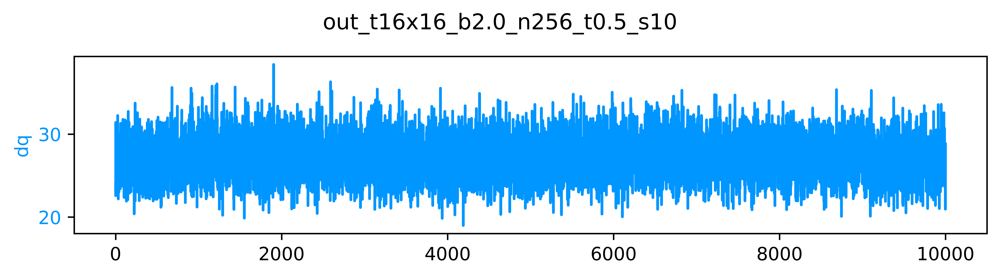

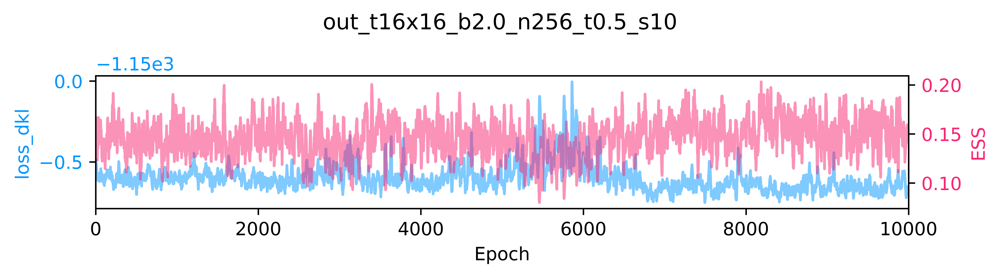

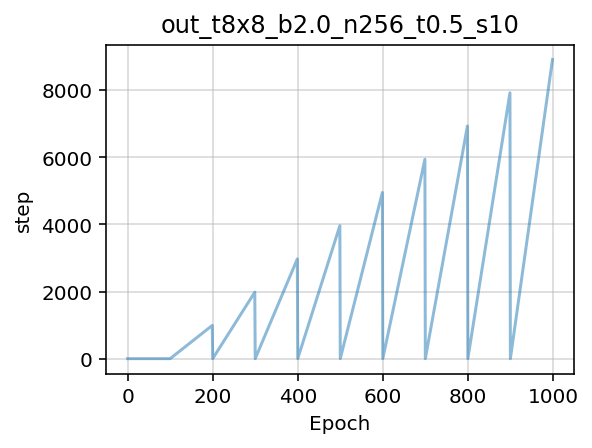

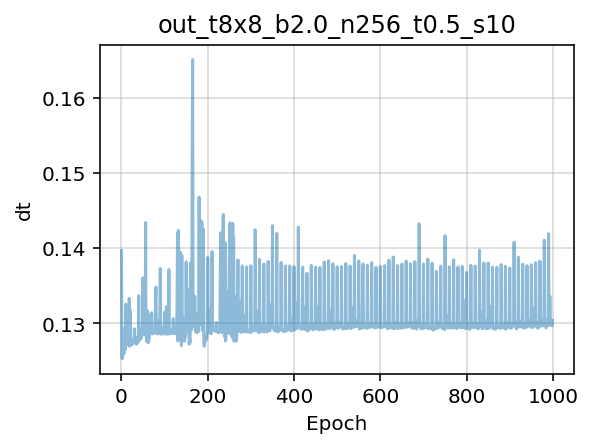

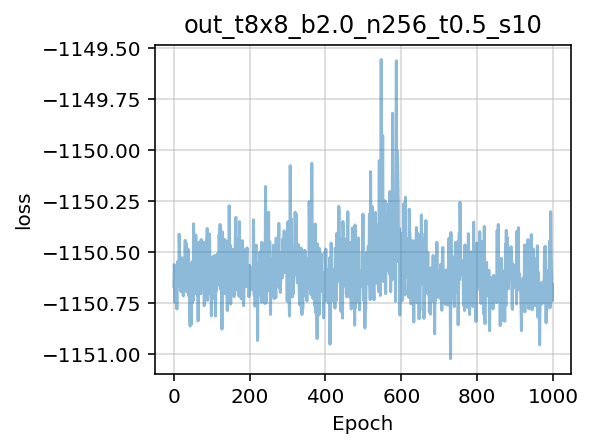

...

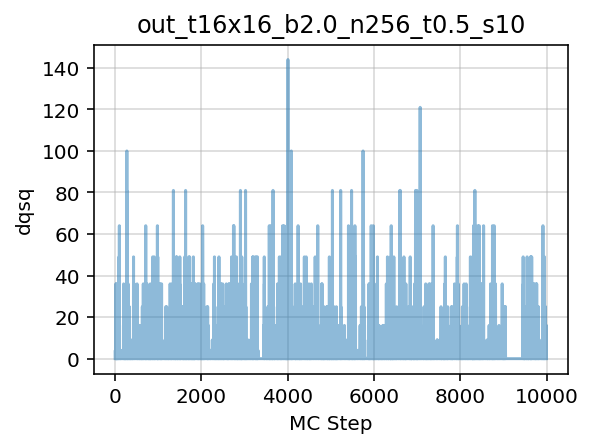

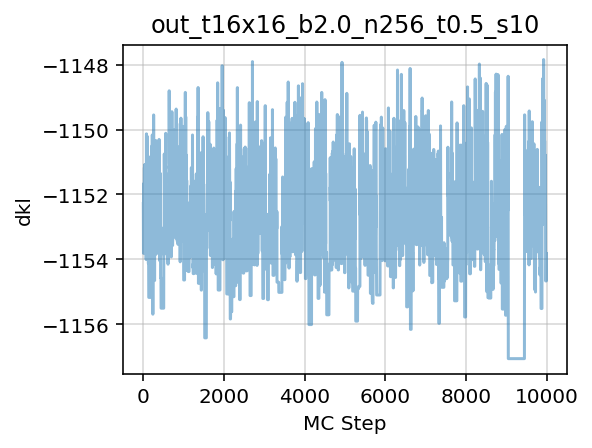

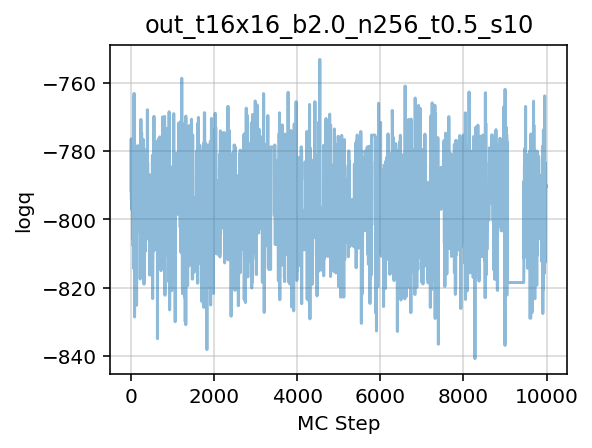

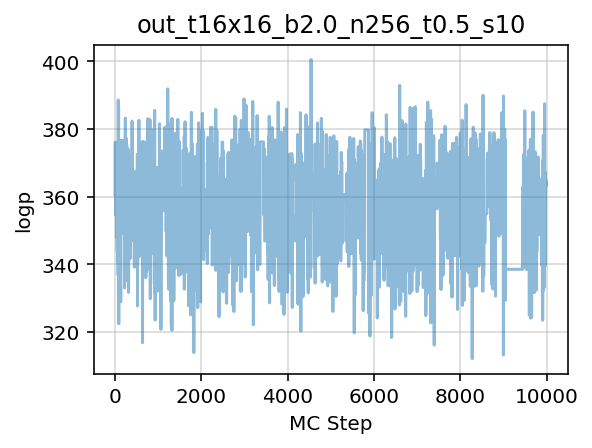

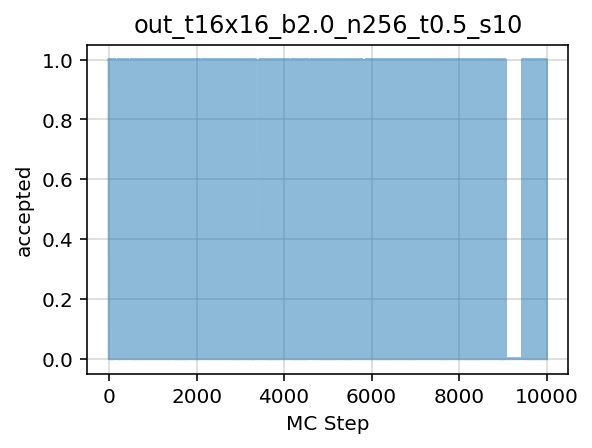

In [24]:
from math import pi as PI
from fthmc.utils.distributions import MultivariateUniform
from fthmc.utils.layers import make_net_from_layers, get_nets
from fthmc.utils.samplers import make_mcmc_ensemble
import fthmc.utils.qed_helpers as qed

from fthmc.utils.plot_helpers import plot_history

param16 = {
    'L': 16,
    'tau': 0.5,
    'nrun': 5,
    'beta': 2.,
    'nstep': 10,
    'ntraj': 256,
    'nprint': 50,
    'seed': 1331,
    'randinit': True,
}

param16 = Param(**param16)
logger.log(repr(param16))

flow16 = make_net_from_layers(lattice_shape=tuple(param16.lat),
                              nets=get_nets(pre_flow_model12['layers']))

train_config16 = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 1000,
    'n_layers': 24,
    'n_s_nets': 2,
    'hidden_sizes': [16, 16],
    'kernel_size': 5,
    'batch_size': 256,
    'print_freq': 100,
    'plot_freq': 100,
})

prior16 = MultivariateUniform(torch.zeros((2, *param16.lat)),
                              2. * PI * torch.ones(tuple(param16.lat)))

model16 = {'layers': flow16, 'prior': prior16}

DAYSTR16 = io.get_timestamp('%Y-%m-%d')
NOW16 = io.get_timestamp('%Y-%m-%d-%H%M%S')
TSTAMP16 = io.get_timestamp('%Y-%m-%d-%H%M')

PARAM_DIR16 = os.path.join(LOGS_DIR,
                           param16.uniquestr())
METRICS_DIR16 = os.path.join(PARAM_DIR16, 'metrics')
MODEL_DIR16 = os.path.join(PARAM_DIR16, 'models')
PLOTS_DIR16 = os.path.join(PARAM_DIR16, 'plots')
#OUTDIR = os.path.join(METRICS_DIR)

io.check_else_make_dir(PARAM_DIR16)
io.check_else_make_dir(MODEL_DIR16)
io.check_else_make_dir(METRICS_DIR16)
io.check_else_make_dir(PLOTS_DIR16)


train_outputs16 = train(param16,
                        train_config16,
                        model=model16,
                        pre_model=None,
                        logger=logger,
                        figsize=(7.5, 2))

pre_flow_plots16 = train_outputs16['plots']
pre_flow_history16 = train_outputs16['history']
flow_act16 = train_outputs16['action']

pre_flow_model16 = train_outputs16['model']
pre_flow_optimizer16 = train_outputs16['optimizer_kdl']

# Save model, optimizer, and history to checkpoint
step16 = train_config16.n_era * train_config16.n_epoch

outfile16 = os.path.join(MODEL_DIR16, 'pre_flow_model', TSTAMP16, 'pre_flow_model.tar')
io.save_checkpoint(
    epoch=step16,
    outfile=outfile16,
    model=pre_flow_model16['layers'],
    optimizer=pre_flow_optimizer16,
    history=train_outputs16['history'],
    overwrite=True,
)

plots16 = train_outputs16['plots']
outdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)

save_live_plots(plots16, outdir16)


tstamp16 = io.get_timestamp('%Y-%m-%d-%H%M%S')

pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir16):
    pdir16 = os.path.join(PLOTS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir16):
    mdir16 = os.path.join(METRICS_DIR16, 'training', 'pre_flow_model', tstamp16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=train_outputs16['history'],
             param=param, skip=['epoch'],
             num_chains=2, therm_frac=0.0, thin=10,
             xlabel='Epoch', outdir=pdir16, alpha=0.5)

mfile16 = os.path.join(mdir16, 'train_metrics.z')
io.save_history(train_outputs16['history'], mfile16, name='train_metrics')



history16 = make_mcmc_ensemble(model=train_outputs16['model'],
                               action_fn=train_outputs16['action'],
                               batch_size=train_config16.batch_size,
                               num_samples=10000)

pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(pdir):
    pdir16 = os.path.join(PLOTS_DIR16, 'inference', 'pre_flow_model', tstamp16)
    
mdir16 = os.path.join(PLOTS_DIR16,'inference', 'pre_flow_model', TSTAMP16)
if os.path.isdir(mdir):
    mdir16 = os.path.join(METRICS_DIR16, 'inference', 'pre_flow_model', TSTAMP16)
    
io.check_else_make_dir(pdir16)
io.check_else_make_dir(mdir16)

plot_history(history=history16,
             param=param16,
             outdir=pdir16,
             skip=['epoch', 'x'],
             num_chains=2,
             therm_frac=0.0,#, thin=10,
             xlabel='MC Step',
             alpha=0.5)

mfile16 = os.path.join(mdir16, 'inference_metrics.z')

io.save_history(history16, mfile16, name='inference_metrics')

logger.log(f'Accept rate: {np.mean(history["accepted"])}')

In [26]:
pre_flow_model.keys()

dict_keys(['layers', 'prior'])

In [32]:
layers8 = pre_flow_model['layers']
logger.log([val.shape for _, val in layers8.state_dict().items()])

[19:20:48]  [                                                                                
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                    

In [33]:
layers12 = model12['layers']
logger.log([val.shape for _, val in layers12.state_dict().items()])

[19:21:08]  [                                                                                
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                                                             
                torch.Size([8, 2, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([8, 8, 3, 3]),                                                    
                torch.Size([8]),                                                             
                torch.Size([3, 8, 3, 3]),                                                    
                torch.Size([3]),                    

In [30]:
layers12 = model12['layers']
logger.log(layers12.state_dict())

[19:19:28]  OrderedDict([('0.plaq_coupling.net.0.weight', tensor([[[[ 0.3115,  0.2976,       
            -0.3184],                                                                        
                      [ 0.2571,  0.2997, -0.2724],                                           
                      [ 0.2039, -0.0552, -0.2248]],                                          
                                                                                             
                     [[-0.2647, -0.0313,  0.2783],                                           
                      [-0.2265, -0.2065, -0.0738],                                           
                      [ 0.2829,  0.3290,  0.5797]]],                                         
                                                                                             
                                                                                             
                    [[[ 0.1538, -0.0855, -0.1435],                                           
                      [-0.1691, -0.4977, -0.3376],                                           
                      [-0.1113, -0.1078,  0.1315]],                                          
                                                                                             
                     [[-0.1080,  0.1571,  0.2434],                                           
                      [ 0.1040,  0.3357,  0.5584],                                           
                      [-0.0135,  0.3063,  0.0758]]],                                         
                                                                                             
                                                                                             
                    [[[-0.2868, -0.2115, -0.1211],                                           
                      [-0.2229, -0.5196,  0.1397],                                           
                      [-0.2182, -0.1292,  0.0472]],                                          
                                                                                             
                     [[-0.0641, -0.2217, -0.1389],                                           
                      [-0.0851,  0.0078, -0.0569],                                           
                      [-0.0028,  0.2378,  0.3244]]],                                         
                                                                                             
                                                                                             
                    [[[ 0.0541, -0.0342,  0.0434],                                           
                      [ 0.0996, -0.0079,  0.0296],                                           
                      [ 0.0439, -0.4672, -0.3042]],                                          
                                                                                             
                     [[-0.1527,  0.0877,  0.0964],                                           
                      [ 0.2126,  0.3492, -0.0154],                                           
                      [-0.3337, -0.6598, -0.0763]]],                                         
                                                                                             
                                                                                             
                    [[[-0.1546, -0.1657, -0.2064],                                           
                      [-0.1393, -0.3952, -0.0099],                                           
                      [-0.0927, -0.0016,  0.2950]],                                          
                                                                                             
                     [[-0.0284,  0.2610,  0.4557],                                           
                      [-0.1447, -0.0331,  0.2212],  

TORCH DEVICE: cuda


TrainConfig(n_era=100, n_epoch=100, n_layers=32, n_s_nets=2, hidden_sizes=[8, 8], kernel_size=3, base_lr=0.001, batch_size=1024, print_freq=10, plot_freq=50, with_force=True)

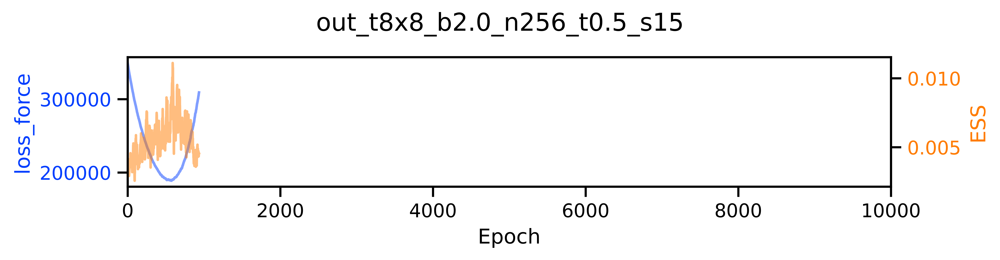

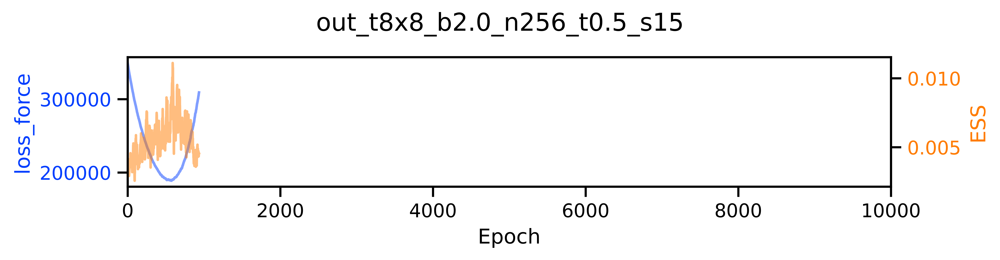

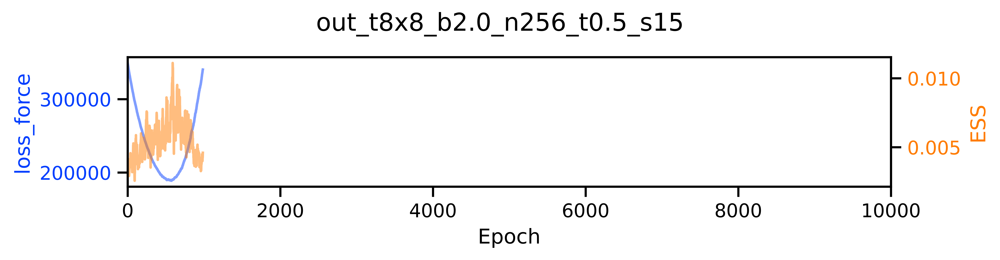

[13:59:55]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=0, last took: 0 min 0 s                                                                                                                                                                                                                         
            -------------------------------------------------------------------

[14:00:05]  epoch=7.000 dt=0.921 loss=349382.062 dq=0.170 ess=0.004 loss_dkl=0.000 logp=87.879 logq=-233.835 loss_force=349382.081 force_size=349382.062 force_norm=591.084

[14:00:15]  epoch=17.000 dt=0.918 loss=342618.562 dq=0.185 ess=0.004 loss_dkl=0.000 logp=87.827 logq=-233.471 loss_force=342618.556 force_size=342618.562 force_norm=585.334

[14:00:24]  epoch=27.000 dt=0.909 loss=335547.594 dq=0.173 ess=0.002 loss_dkl=0.000 logp=87.864 logq=-233.089 loss_force=335547.588 force_size=335547.594 force_norm=579.263

[14:00:33]  epoch=37.000 dt=0.918 loss=330418.812 dq=0.179 ess=0.006 loss_dkl=0.000 logp=88.006 logq=-232.717 loss_force=330418.812 force_size=330418.812 force_norm=574.820

[14:00:42]  epoch=47.000 dt=0.921 loss=325021.906 dq=0.184 ess=0.004 loss_dkl=0.000 logp=87.892 logq=-232.352 loss_force=325021.919 force_size=325021.906 force_norm=570.106

[14:00:54]  epoch=57.000 dt=0.919 loss=319582.062 dq=0.175 ess=0.005 loss_dkl=0.000 logp=87.619 logq=-232.025 loss_force=319582.069 force_size=319582.062 force_norm=565.314

[14:01:04]  epoch=67.000 dt=0.917 loss=312900.344 dq=0.192 ess=0.003 loss_dkl=0.000 logp=87.959 logq=-231.668 loss_force=312900.325 force_size=312900.344 force_norm=559.374

[14:01:13]  epoch=77.000 dt=0.917 loss=308271.500 dq=0.182 ess=0.006 loss_dkl=0.000 logp=88.000 logq=-231.302 loss_force=308271.494 force_size=308271.500 force_norm=555.219

[14:01:22]  epoch=87.000 dt=0.923 loss=302801.500 dq=0.181 ess=0.005 loss_dkl=0.000 logp=87.928 logq=-230.966 loss_force=302801.531 force_size=302801.500 force_norm=550.271

[14:01:31]  epoch=97.000 dt=0.921 loss=297788.656 dq=0.187 ess=0.002 loss_dkl=0.000 logp=87.973 logq=-230.636 loss_force=297788.644 force_size=297788.656 force_norm=545.699

[14:01:34]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=1, last took: 1 min 38.66 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:01:43]  epoch=7.000 dt=0.916 loss=293881.906 dq=0.191 ess=0.005 loss_dkl=0.000 logp=87.823 logq=-230.306 loss_force=293881.894 force_size=293881.906 force_norm=542.106

[14:01:53]  epoch=17.000 dt=0.922 loss=289758.938 dq=0.201 ess=0.004 loss_dkl=0.000 logp=87.725 logq=-229.992 loss_force=289758.938 force_size=289758.938 force_norm=538.291

[14:02:02]  epoch=27.000 dt=0.918 loss=283250.906 dq=0.198 ess=0.005 loss_dkl=0.000 logp=87.896 logq=-229.652 loss_force=283250.900 force_size=283250.906 force_norm=532.212

[14:02:11]  epoch=37.000 dt=0.919 loss=279002.062 dq=0.224 ess=0.004 loss_dkl=0.000 logp=87.818 logq=-229.334 loss_force=279002.044 force_size=279002.062 force_norm=528.206

[14:02:20]  epoch=47.000 dt=0.925 loss=275139.406 dq=0.226 ess=0.002 loss_dkl=0.000 logp=87.783 logq=-229.022 loss_force=275139.400 force_size=275139.406 force_norm=524.536

[14:02:32]  epoch=57.000 dt=0.925 loss=271364.625 dq=0.220 ess=0.004 loss_dkl=0.000 logp=87.911 logq=-228.693 loss_force=271364.650 force_size=271364.625 force_norm=520.926

[14:02:42]  epoch=67.000 dt=0.920 loss=267911.750 dq=0.213 ess=0.005 loss_dkl=0.000 logp=87.720 logq=-228.408 loss_force=267911.725 force_size=267911.750 force_norm=517.601

[14:02:51]  epoch=77.000 dt=0.921 loss=263966.656 dq=0.220 ess=0.006 loss_dkl=0.000 logp=87.844 logq=-228.072 loss_force=263966.628 force_size=263966.656 force_norm=513.774

[14:03:00]  epoch=87.000 dt=0.917 loss=260106.125 dq=0.236 ess=0.006 loss_dkl=0.000 logp=87.768 logq=-227.791 loss_force=260106.134 force_size=260106.125 force_norm=510.005

[14:03:09]  epoch=97.000 dt=0.915 loss=256895.906 dq=0.239 ess=0.003 loss_dkl=0.000 logp=87.761 logq=-227.481 loss_force=256895.891 force_size=256895.906 force_norm=506.847

[14:03:12]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=2, last took: 1 min 38.04 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:03:21]  epoch=7.000 dt=0.916 loss=252590.531 dq=0.234 ess=0.007 loss_dkl=0.000 logp=87.854 logq=-227.176 loss_force=252590.519 force_size=252590.531 force_norm=502.583

[14:03:31]  epoch=17.000 dt=0.916 loss=249466.250 dq=0.237 ess=0.004 loss_dkl=0.000 logp=87.855 logq=-226.882 loss_force=249466.247 force_size=249466.250 force_norm=499.463

[14:03:40]  epoch=27.000 dt=0.934 loss=245849.500 dq=0.242 ess=0.005 loss_dkl=0.000 logp=87.880 logq=-226.594 loss_force=245849.497 force_size=245849.500 force_norm=495.832

[14:03:49]  epoch=37.000 dt=0.941 loss=241978.219 dq=0.250 ess=0.004 loss_dkl=0.000 logp=87.771 logq=-226.296 loss_force=241978.222 force_size=241978.219 force_norm=491.912

[14:03:59]  epoch=47.000 dt=0.931 loss=239896.594 dq=0.267 ess=0.005 loss_dkl=0.000 logp=87.867 logq=-226.013 loss_force=239896.594 force_size=239896.594 force_norm=489.792

[14:04:11]  epoch=57.000 dt=0.929 loss=236458.672 dq=0.266 ess=0.007 loss_dkl=0.000 logp=87.933 logq=-225.733 loss_force=236458.669 force_size=236458.672 force_norm=486.268

[14:04:20]  epoch=67.000 dt=0.926 loss=233440.750 dq=0.283 ess=0.007 loss_dkl=0.000 logp=87.730 logq=-225.470 loss_force=233440.747 force_size=233440.750 force_norm=483.154

[14:04:29]  epoch=77.000 dt=0.938 loss=231496.125 dq=0.288 ess=0.005 loss_dkl=0.000 logp=87.817 logq=-225.185 loss_force=231496.138 force_size=231496.125 force_norm=481.139

[14:04:39]  epoch=87.000 dt=0.923 loss=228385.844 dq=0.289 ess=0.005 loss_dkl=0.000 logp=87.827 logq=-224.920 loss_force=228385.844 force_size=228385.844 force_norm=477.893

[14:04:48]  epoch=97.000 dt=0.920 loss=224627.422 dq=0.296 ess=0.007 loss_dkl=0.000 logp=87.823 logq=-224.624 loss_force=224627.419 force_size=224627.422 force_norm=473.947

[14:04:51]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=3, last took: 1 min 38.57 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:05:00]  epoch=7.000 dt=0.923 loss=223681.500 dq=0.293 ess=0.006 loss_dkl=0.000 logp=87.768 logq=-224.371 loss_force=223681.513 force_size=223681.500 force_norm=472.943

[14:05:09]  epoch=17.000 dt=0.917 loss=220285.281 dq=0.317 ess=0.007 loss_dkl=0.000 logp=87.759 logq=-224.120 loss_force=220285.284 force_size=220285.281 force_norm=469.344

[14:05:18]  epoch=27.000 dt=0.923 loss=217805.969 dq=0.330 ess=0.006 loss_dkl=0.000 logp=87.760 logq=-223.862 loss_force=217805.981 force_size=217805.969 force_norm=466.696

[14:05:28]  epoch=37.000 dt=0.917 loss=214853.875 dq=0.321 ess=0.005 loss_dkl=0.000 logp=87.969 logq=-223.547 loss_force=214853.878 force_size=214853.875 force_norm=463.520

[14:05:37]  epoch=47.000 dt=0.925 loss=213638.578 dq=0.340 ess=0.005 loss_dkl=0.000 logp=87.808 logq=-223.340 loss_force=213638.575 force_size=213638.578 force_norm=462.210

[14:05:49]  epoch=57.000 dt=0.939 loss=210256.344 dq=0.334 ess=0.004 loss_dkl=0.000 logp=88.008 logq=-223.047 loss_force=210256.341 force_size=210256.344 force_norm=458.537

[14:05:58]  epoch=67.000 dt=0.920 loss=209659.703 dq=0.366 ess=0.007 loss_dkl=0.000 logp=87.786 logq=-222.845 loss_force=209659.700 force_size=209659.703 force_norm=457.885

[14:06:08]  epoch=77.000 dt=0.925 loss=207670.125 dq=0.362 ess=0.006 loss_dkl=0.000 logp=87.796 logq=-222.596 loss_force=207670.116 force_size=207670.125 force_norm=455.707

[14:06:17]  epoch=87.000 dt=0.926 loss=205492.922 dq=0.374 ess=0.005 loss_dkl=0.000 logp=87.805 logq=-222.349 loss_force=205492.925 force_size=205492.922 force_norm=453.311

[14:06:26]  epoch=97.000 dt=0.925 loss=204436.375 dq=0.388 ess=0.002 loss_dkl=0.000 logp=87.810 logq=-222.129 loss_force=204436.381 force_size=204436.375 force_norm=452.141

[14:06:29]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=4, last took: 1 min 38.66 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:06:39]  epoch=7.000 dt=0.922 loss=201549.750 dq=0.392 ess=0.005 loss_dkl=0.000 logp=88.000 logq=-221.850 loss_force=201549.750 force_size=201549.750 force_norm=448.942

[14:06:48]  epoch=17.000 dt=0.926 loss=200807.328 dq=0.428 ess=0.007 loss_dkl=0.000 logp=87.855 logq=-221.653 loss_force=200807.331 force_size=200807.328 force_norm=448.112

[14:06:57]  epoch=27.000 dt=0.917 loss=199045.453 dq=0.449 ess=0.006 loss_dkl=0.000 logp=87.776 logq=-221.447 loss_force=199045.462 force_size=199045.453 force_norm=446.139

[14:07:07]  epoch=37.000 dt=0.919 loss=196275.000 dq=0.431 ess=0.007 loss_dkl=0.000 logp=88.069 logq=-221.148 loss_force=196274.987 force_size=196275.000 force_norm=443.027

[14:07:16]  epoch=47.000 dt=0.925 loss=197015.484 dq=0.468 ess=0.005 loss_dkl=0.000 logp=87.830 logq=-220.986 loss_force=197015.487 force_size=197015.484 force_norm=443.861

[14:07:28]  epoch=57.000 dt=0.916 loss=194583.312 dq=0.469 ess=0.006 loss_dkl=0.000 logp=87.991 logq=-220.721 loss_force=194583.303 force_size=194583.312 force_norm=441.116

[14:07:37]  epoch=67.000 dt=0.948 loss=194710.281 dq=0.510 ess=0.006 loss_dkl=0.000 logp=87.648 logq=-220.608 loss_force=194710.281 force_size=194710.281 force_norm=441.255

[14:07:47]  epoch=77.000 dt=0.928 loss=192931.703 dq=0.499 ess=0.004 loss_dkl=0.000 logp=87.887 logq=-220.364 loss_force=192931.706 force_size=192931.703 force_norm=439.239

[14:07:56]  epoch=87.000 dt=0.937 loss=192453.906 dq=0.533 ess=0.008 loss_dkl=0.000 logp=87.702 logq=-220.150 loss_force=192453.888 force_size=192453.906 force_norm=438.693

[14:08:06]  epoch=97.000 dt=0.927 loss=191742.609 dq=0.553 ess=0.006 loss_dkl=0.000 logp=87.870 logq=-219.955 loss_force=191742.606 force_size=191742.609 force_norm=437.883

[14:08:08]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=5, last took: 1 min 38.89 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:08:17]  epoch=7.000 dt=0.922 loss=191572.875 dq=0.596 ess=0.006 loss_dkl=0.000 logp=87.974 logq=-219.738 loss_force=191572.891 force_size=191572.875 force_norm=437.687

[14:08:27]  epoch=17.000 dt=0.938 loss=188759.875 dq=0.615 ess=0.005 loss_dkl=0.000 logp=87.971 logq=-219.539 loss_force=188759.872 force_size=188759.875 force_norm=434.464

[14:08:36]  epoch=27.000 dt=0.922 loss=190404.219 dq=0.640 ess=0.006 loss_dkl=0.000 logp=87.855 logq=-219.415 loss_force=190404.237 force_size=190404.219 force_norm=436.351

[14:08:46]  epoch=37.000 dt=0.926 loss=190117.359 dq=0.667 ess=0.006 loss_dkl=0.000 logp=87.840 logq=-219.256 loss_force=190117.356 force_size=190117.359 force_norm=436.022

[14:08:55]  epoch=47.000 dt=0.929 loss=189893.156 dq=0.675 ess=0.008 loss_dkl=0.000 logp=87.854 logq=-219.088 loss_force=189893.138 force_size=189893.156 force_norm=435.762

[14:09:07]  epoch=57.000 dt=0.922 loss=189959.328 dq=0.687 ess=0.006 loss_dkl=0.000 logp=87.882 logq=-218.947 loss_force=189959.316 force_size=189959.328 force_norm=435.843

[14:09:17]  epoch=67.000 dt=0.933 loss=189351.094 dq=0.775 ess=0.008 loss_dkl=0.000 logp=87.941 logq=-218.777 loss_force=189351.087 force_size=189351.094 force_norm=435.144

[14:09:26]  epoch=77.000 dt=0.925 loss=188289.188 dq=0.765 ess=0.009 loss_dkl=0.000 logp=87.942 logq=-218.588 loss_force=188289.191 force_size=188289.188 force_norm=433.913

[14:09:35]  epoch=87.000 dt=0.936 loss=189466.781 dq=0.851 ess=0.009 loss_dkl=0.000 logp=87.857 logq=-218.498 loss_force=189466.794 force_size=189466.781 force_norm=435.267

[14:09:45]  epoch=97.000 dt=0.935 loss=191083.781 dq=0.864 ess=0.011 loss_dkl=0.000 logp=87.743 logq=-218.430 loss_force=191083.766 force_size=191083.781 force_norm=437.131

[14:09:47]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=6, last took: 1 min 39.31 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:09:57]  epoch=7.000 dt=0.942 loss=190629.469 dq=0.919 ess=0.006 loss_dkl=0.000 logp=87.885 logq=-218.254 loss_force=190629.478 force_size=190629.469 force_norm=436.608

[14:10:06]  epoch=17.000 dt=0.937 loss=191891.094 dq=0.942 ess=0.006 loss_dkl=0.000 logp=87.862 logq=-218.170 loss_force=191891.084 force_size=191891.094 force_norm=438.049

[14:10:16]  epoch=27.000 dt=0.930 loss=193129.188 dq=1.004 ess=0.008 loss_dkl=0.000 logp=87.780 logq=-218.088 loss_force=193129.184 force_size=193129.188 force_norm=439.459

[14:10:25]  epoch=37.000 dt=0.924 loss=192908.656 dq=1.076 ess=0.008 loss_dkl=0.000 logp=87.845 logq=-217.964 loss_force=192908.672 force_size=192908.656 force_norm=439.210

[14:10:35]  epoch=47.000 dt=0.950 loss=193288.781 dq=1.116 ess=0.007 loss_dkl=0.000 logp=87.905 logq=-217.804 loss_force=193288.775 force_size=193288.781 force_norm=439.642

[14:10:47]  epoch=57.000 dt=0.921 loss=195993.531 dq=1.186 ess=0.015 loss_dkl=0.000 logp=87.822 logq=-217.798 loss_force=195993.544 force_size=195993.531 force_norm=442.708

[14:10:56]  epoch=67.000 dt=0.926 loss=196636.000 dq=1.203 ess=0.004 loss_dkl=0.000 logp=87.854 logq=-217.689 loss_force=196636.000 force_size=196636.000 force_norm=443.434

[14:11:05]  epoch=77.000 dt=0.926 loss=199392.766 dq=1.329 ess=0.009 loss_dkl=0.000 logp=87.792 logq=-217.659 loss_force=199392.759 force_size=199392.766 force_norm=446.531

[14:11:15]  epoch=87.000 dt=0.920 loss=201355.156 dq=1.371 ess=0.009 loss_dkl=0.000 logp=87.778 logq=-217.637 loss_force=201355.163 force_size=201355.156 force_norm=448.725

[14:11:24]  epoch=97.000 dt=0.919 loss=201640.859 dq=1.540 ess=0.008 loss_dkl=0.000 logp=87.942 logq=-217.510 loss_force=201640.859 force_size=201640.859 force_norm=449.037

[14:11:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=7, last took: 1 min 39.11 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:11:36]  epoch=7.000 dt=0.922 loss=205536.266 dq=1.604 ess=0.004 loss_dkl=0.000 logp=87.775 logq=-217.516 loss_force=205536.256 force_size=205536.266 force_norm=453.355

[14:11:45]  epoch=17.000 dt=0.925 loss=205960.453 dq=1.735 ess=0.010 loss_dkl=0.000 logp=87.939 logq=-217.413 loss_force=205960.453 force_size=205960.453 force_norm=453.802

[14:11:55]  epoch=27.000 dt=0.931 loss=209305.688 dq=1.881 ess=0.006 loss_dkl=0.000 logp=87.875 logq=-217.397 loss_force=209305.697 force_size=209305.688 force_norm=457.492

[14:12:04]  epoch=37.000 dt=0.925 loss=211053.406 dq=1.892 ess=0.005 loss_dkl=0.000 logp=87.923 logq=-217.440 loss_force=211053.400 force_size=211053.406 force_norm=459.401

[14:12:13]  epoch=47.000 dt=0.921 loss=215909.172 dq=2.033 ess=0.006 loss_dkl=0.000 logp=87.792 logq=-217.490 loss_force=215909.175 force_size=215909.172 force_norm=464.655

[14:12:25]  epoch=57.000 dt=0.931 loss=217781.297 dq=2.109 ess=0.005 loss_dkl=0.000 logp=87.906 logq=-217.498 loss_force=217781.294 force_size=217781.297 force_norm=466.660

[14:12:35]  epoch=67.000 dt=0.937 loss=220280.406 dq=2.265 ess=0.006 loss_dkl=0.000 logp=88.022 logq=-217.518 loss_force=220280.378 force_size=220280.406 force_norm=469.332

[14:12:44]  epoch=77.000 dt=0.935 loss=225510.047 dq=2.505 ess=0.006 loss_dkl=0.000 logp=87.762 logq=-217.556 loss_force=225510.062 force_size=225510.047 force_norm=474.862

[14:12:54]  epoch=87.000 dt=0.933 loss=227618.406 dq=2.657 ess=0.008 loss_dkl=0.000 logp=87.808 logq=-217.656 loss_force=227618.406 force_size=227618.406 force_norm=477.088

[14:13:03]  epoch=97.000 dt=0.937 loss=233135.078 dq=2.854 ess=0.005 loss_dkl=0.000 logp=87.780 logq=-217.669 loss_force=233135.075 force_size=233135.078 force_norm=482.834

[14:13:06]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=8, last took: 1 min 39.36 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:13:16]  epoch=7.000 dt=0.947 loss=236182.047 dq=2.981 ess=0.009 loss_dkl=0.000 logp=87.833 logq=-217.797 loss_force=236182.069 force_size=236182.047 force_norm=485.983

[14:13:25]  epoch=17.000 dt=0.943 loss=239802.297 dq=3.205 ess=0.004 loss_dkl=0.000 logp=87.877 logq=-217.840 loss_force=239802.316 force_size=239802.297 force_norm=489.689

[14:13:35]  epoch=27.000 dt=0.952 loss=243964.578 dq=3.340 ess=0.005 loss_dkl=0.000 logp=87.996 logq=-217.924 loss_force=243964.566 force_size=243964.578 force_norm=493.909

[14:13:44]  epoch=37.000 dt=0.941 loss=250139.781 dq=3.666 ess=0.009 loss_dkl=0.000 logp=87.859 logq=-218.064 loss_force=250139.772 force_size=250139.781 force_norm=500.127

[14:13:54]  epoch=47.000 dt=0.935 loss=257501.578 dq=3.939 ess=0.003 loss_dkl=0.000 logp=87.857 logq=-218.235 loss_force=257501.566 force_size=257501.578 force_norm=507.440

[14:14:06]  epoch=57.000 dt=0.943 loss=259806.422 dq=4.185 ess=0.004 loss_dkl=0.000 logp=87.863 logq=-218.307 loss_force=259806.419 force_size=259806.422 force_norm=509.689

[14:14:15]  epoch=67.000 dt=0.939 loss=265401.875 dq=4.630 ess=0.004 loss_dkl=0.000 logp=87.947 logq=-218.420 loss_force=265401.881 force_size=265401.875 force_norm=515.169

[14:14:25]  epoch=77.000 dt=0.929 loss=269149.531 dq=4.803 ess=0.004 loss_dkl=0.000 logp=87.898 logq=-218.569 loss_force=269149.531 force_size=269149.531 force_norm=518.787

[14:14:34]  epoch=87.000 dt=0.931 loss=277336.844 dq=5.102 ess=0.004 loss_dkl=0.000 logp=87.815 logq=-218.762 loss_force=277336.856 force_size=277336.844 force_norm=526.615

[14:14:44]  epoch=97.000 dt=0.926 loss=283709.562 dq=5.382 ess=0.003 loss_dkl=0.000 logp=87.848 logq=-218.911 loss_force=283709.562 force_size=283709.562 force_norm=532.635

[14:14:46]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=9, last took: 1 min 40.39 s                                                                                                                                                                                                                     
            -------------------------------------------------------------------

[14:14:56]  epoch=7.000 dt=0.935 loss=285669.438 dq=5.824 ess=0.003 loss_dkl=0.000 logp=87.934 logq=-219.052 loss_force=285669.431 force_size=285669.438 force_norm=534.469

[14:15:05]  epoch=17.000 dt=0.943 loss=293721.562 dq=6.134 ess=0.005 loss_dkl=0.000 logp=87.810 logq=-219.229 loss_force=293721.544 force_size=293721.562 force_norm=541.958

[14:15:15]  epoch=27.000 dt=0.930 loss=297774.844 dq=6.368 ess=0.005 loss_dkl=0.000 logp=87.792 logq=-219.463 loss_force=297774.850 force_size=297774.844 force_norm=545.679

[14:15:24]  epoch=37.000 dt=0.941 loss=306798.812 dq=6.906 ess=0.004 loss_dkl=0.000 logp=87.724 logq=-219.667 loss_force=306798.787 force_size=306798.812 force_norm=553.871

[14:15:34]  epoch=47.000 dt=0.938 loss=313975.125 dq=7.323 ess=0.004 loss_dkl=0.000 logp=87.735 logq=-219.912 loss_force=313975.144 force_size=313975.125 force_norm=560.329

[14:15:46]  epoch=57.000 dt=0.942 loss=316753.250 dq=7.364 ess=0.004 loss_dkl=0.000 logp=87.995 logq=-220.034 loss_force=316753.269 force_size=316753.250 force_norm=562.805

[14:15:56]  epoch=67.000 dt=0.950 loss=321251.625 dq=7.780 ess=0.003 loss_dkl=0.000 logp=87.877 logq=-220.195 loss_force=321251.619 force_size=321251.625 force_norm=566.789

[14:16:05]  epoch=77.000 dt=0.937 loss=330103.312 dq=8.314 ess=0.005 loss_dkl=0.000 logp=87.788 logq=-220.461 loss_force=330103.325 force_size=330103.312 force_norm=574.531

[14:16:15]  epoch=87.000 dt=0.938 loss=337821.812 dq=8.716 ess=0.005 loss_dkl=0.000 logp=87.909 logq=-220.606 loss_force=337821.794 force_size=337821.812 force_norm=581.211

[14:16:25]  epoch=97.000 dt=0.949 loss=343318.375 dq=9.343 ess=0.005 loss_dkl=0.000 logp=87.718 logq=-220.919 loss_force=343318.375 force_size=343318.375 force_norm=585.924

[14:16:27]  -------------------------------------------------------------------                                                                                                                                                                                 
            ERA=10, last took: 1 min 40.83 s                                                                                                                                                                                                                    
            -------------------------------------------------------------------

[14:16:37]  epoch=7.000 dt=0.951 loss=348071.156 dq=9.435 ess=0.007 loss_dkl=0.000 logp=87.687 logq=-221.123 loss_force=348071.144 force_size=348071.156 force_norm=589.968

[14:16:46]  epoch=17.000 dt=0.944 loss=357047.250 dq=9.986 ess=0.006 loss_dkl=0.000 logp=87.706 logq=-221.390 loss_force=357047.244 force_size=357047.250 force_norm=597.528

[14:16:56]  epoch=27.000 dt=0.929 loss=357202.562 dq=10.028 ess=0.003 loss_dkl=0.000 logp=87.912 logq=-221.442 loss_force=357202.562 force_size=357202.562 force_norm=597.646

[14:17:05]  epoch=37.000 dt=0.934 loss=364697.812 dq=10.674 ess=0.004 loss_dkl=0.000 logp=87.877 logq=-221.670 loss_force=364697.775 force_size=364697.812 force_norm=603.899

In [ ]:
import seaborn as sns

from dataclasses import asdict
from copy import deepcopy
from utils.distributions import MultivariateUniform
from utils.layers import make_u1_equiv_layers, set_weights
from math import pi as PI
import utils.qed_helpers as qed

TWO_PI = 2 * PI
# from train import train

sns.set_context('notebook')
sns.set_palette('bright')

train_cfg_force = asdict(train_config)
train_cfg_force['with_force'] = True

tconfig_force = TrainConfig(**train_cfg_force)

link_shape = (2, *param.lat)
lattice_shape = tuple(param.lat)
u1_action = qed.BatchAction(param.beta)

prior = MultivariateUniform(torch.zeros(link_shape),
                            TWO_PI * torch.ones(link_shape))

tconfig_force
layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                              n_layers=tconfig_force.n_layers,
                              n_mixture_comps=tconfig_force.n_s_nets,
                              hidden_sizes=tconfig_force.hidden_sizes,
                              kernel_size=tconfig_force.kernel_size)

set_weights(layers)

model_force = {
    'prior': prior,
    'layers': layers,
}
                              

outputs = train(param, tconfig_force,
                model=model_force,
                pre_model=pre_flow_model,
                figsize=(8, 2.),
                use_alt=False,
                force_factor=0.001,
                dkl_factor=1.)#, logger=logger)

flow_model_force = outputs['model']
flow_model_force_history = outputs['history']
flow_action_force = outputs['action']

In [ ]:
def test_force(
    param: Param,
    model: dict,
    x: torch.Tensor = None,
    pre_model: dict = None
):
    """Test the force.
    
    If `x` is None:
      - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` 
        to get `x (~ pre_posterior)`.
     
    Pass `x` backwards through the `model` to get `xi (~ prior)`.
    
    Calculate `force(xi)` and `norm(force(xi))`.
    """
    if x is None:
        if pre_model is None:
            raise ValueError(f'Either `x` or `pre_model` must be specified.')
            
        # Draw samples `xi` from prior
        pre_xi = pre_model['prior'].sample_n(1)
        
        # Pass `xi` through layers in `pre_model`
        x = qed.ft_flow(pre_model['layers'], pre_xi)
        
    # Pass `x` backwards through layers in `model`
    xi = qed.ft_flow_inv(model['layers'], x)
    # Calculate force
    force = qed.ft_force(param, model['layers'], xi)
    force_norm = torch.linalg.norm(force)
    return force_norm

In [ ]:
from train import run as hmc_run
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

#metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
#metrics_file = os.path.join(metrics_dir, 'metrics.z')
#io.savez(metrics, metrics_file)

In [ ]:
#field_arr = torch.stack(tuple(fields.values()), dim=0)
len(fields)
#
field_arr = np.array([qed.grab(torch.stack(i)) for i in fields])
field_arr.shape
#logger.log(field_arr.shape)

In [ ]:
for field in field_arr:
    force_tf = test_force(param, flow_model_force, pre_model=pre_flow_model)
    logger.log(f'ft_flow(players, pxi), (pxi ~ pre_prior): {force_tf:.5g}') 
    
    x = torch.from_numpy(field[-1]).squeeze()[None, :]
    if torch.cuda.is_available():
        x = x.cuda()
    
    #x_ = field_arr.squeeze()[None, :]
    force_ = test_force(param, flow_model_force, x=x, pre_model=pre_flow_model)
    logger.log(f'ft_flow(layers, field_arr), (pxi ~ pre_prior): {force_:.5g}')

In [ ]:
# field_arr generated from generic HMC run
for idx, fields in enumerate(field_arr):
    # x generated from HMC
    x = torch.from_numpy(fields)
    if torch.cuda.is_available():
        x = x.cuda()
        
    # flow HMC samples backwards through `flow_model_force` and calculate force
    force1 = test_force(param, flow_model_force, x=x)
    
    # sample x ~ pre_flow_model_prior, flow through `pre_flow_model` to get xi 
    # flow xi backwards through `flow_model_force` and calculate force
    force2 = test_force(param, flow_model_force, pre_model=pre_flow_model)
    
    logger.log(f'run={idx}\n'
               f'  (xi ~ HMC): force_xi={force1:.5g}\n'
               f"  (xi ~ pre_flow_model_prior): force_xi_pre={force2:.5g}")

In [ ]:
#field_run = torch.stack(tuple(fields.values()), dim=0)
##flows = flow

#x0 = field_arr[0][None, :]
#x = field_arr[0][None, :]

# select last trajectory from last run
x = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()
x0 = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()

if torch.cuda.is_available():
    x = x.cuda()

plaq0 = qed.action(param, x) / (-param.beta * param.volume)
logger.log(f'plaq(field_arr[0])={plaq0:.8g}')

#logger\.log(f'plaq(field_run[0]) {qed.action(param, x) / (-param.beta*param.volume)}')
# field.requires_grad_(True)
#x = field_run[0][None, :]
logJ = 0.0
for layer in reversed(flow_model_force['layers']):
    x, lJ = layer.reverse(x)
    logJ += lJ

# x is the prior distribution now
    
x.requires_grad_(True)
    
y = x
logJy = 0.0
for layer in flow_model_force['layers']:
    y, lJ = layer.forward(y)
    logJy += lJ
    
s = qed.action(param, y[0][None, :]) - logJy

logger.log(f'sum(logJ): {qed.grab(logJ.sum())}')
logger.log(f'sum(logJy): {qed.grab(logJy.sum())}')
#print(logJ,logJy)


# print("eff_action", s + 136.3786)

logger.log(f'original_action: {qed.action(param, y[0][None, :]) + 91}')
#print("original_action", qed.action(param, y[0][None, :]) + 91)

logger.log(f'eff_action: {s + 56}')
#print("eff_action", {s + 56)

s.backward()

f = x.grad

x.requires_grad_(False)

logger.log(f'plaq(x) {qed.action(param, x[0][None, :]) / (-param.beta*param.volume)}  logJ {qed.grab(logJ)}  force.norm {torch.linalg.norm(f)}')
logger.log(f'plaq(y) {qed.action(param, y[0][None, :]) / (-param.beta*param.volume)}')
logger.log(f'plaq(x) {qed.action(param, x0) / (-param.beta*param.volume)}  force.norm {torch.linalg.norm(qed.force(param, x0))}')

In [ ]:
logger.log(x.shape)

field_tensor = torch.from_numpy(field_arr).cuda()

x = qed.ft_flow_inv(flow, field_tensor[-1])
# x = field_run
#for layer in reversed(flows):
#    x, lJ = layer.reverse(x)
ff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(ff))
fff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(fff))

In [ ]:
x = qed.ft_flow_inv(flow, field_tensor[-1])
logger.log(qed.grab(qed.ft_action(param, flow, x)))